In [1]:
import scipy
import numpy             as np
import matplotlib.pyplot as plt

# CBF
from data      import make_rectangle, insert_shape, plot_data
from agent     import Agent
from tst_optim import get_h, get_learning_cbfs_lagrangian_hj
from utils     import plot_cbf
from controls  import hjb_controls

# HJB
from   IPython.display      import HTML
import jax
import jax.numpy            as jnp
import matplotlib.animation as anim
import matplotlib.pyplot    as plt
import plotly.graph_objects as go
import hj_reachability      as hj

%load_ext autoreload
%autoreload 2

0.06842105263157895


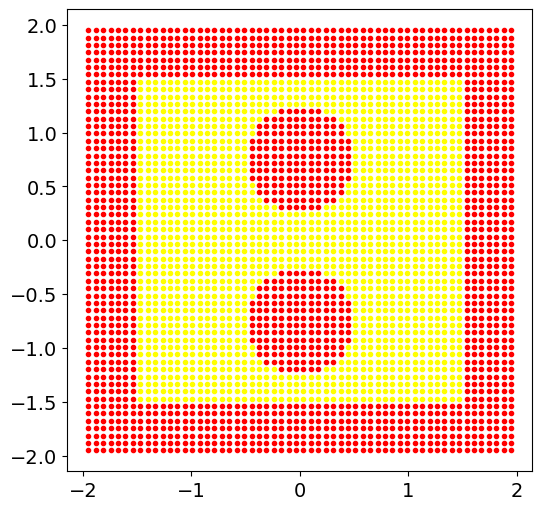

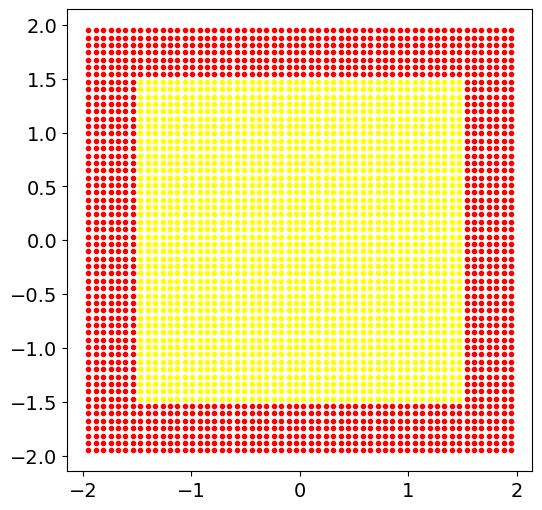

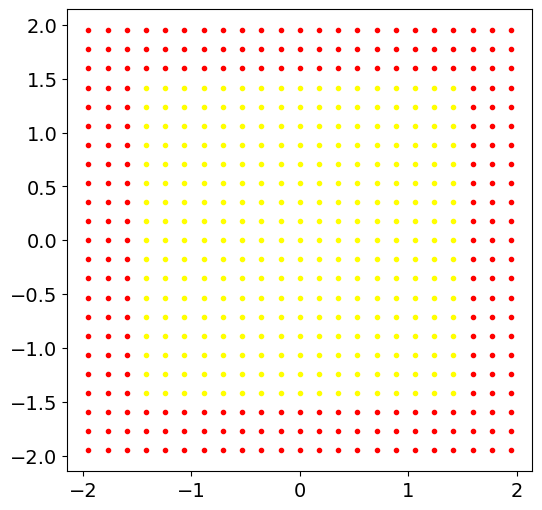

In [2]:
#########################
### Data Construction ###
#########################

# grid parameters
width         = 3
unsafe_margin = 0.3
density       = 225

# make grid and two circular obstacles, collect obstacle points
grid, params, obs_dict = make_rectangle(height=width, width=width, density=density, unsafe_margin=unsafe_margin, center=(0,0), return_params=True)
obs_dict  = insert_shape(np.array([0,  0.75]), grid, obs_dict, shape='circle', scale=0.5, theta=0)
obs_dict  = insert_shape(np.array([0, -0.75]), grid, obs_dict, shape='circle', scale=0.5, theta=0)
obstacles = np.array([pt for pt in grid if obs_dict[tuple(np.round(pt, 3))] != 0])

# auxiliary grids 
c_grid, c_params, c_obs_dict = make_rectangle(height=width, width=width, density=density, unsafe_margin=unsafe_margin, center=(0,0), return_params=True)
s_grid, s_obs_dict = make_rectangle(height=width, width=width, density=35, unsafe_margin=unsafe_margin, center=(0,0))

# HJB grid
lo, hi, n, s = params
print(s)
s=0.75
hjb_grid = hj.Grid.from_lattice_parameters_and_boundary_conditions(hj.sets.Box(lo, hi), n)

plot_data(  grid,   obs_dict, size=6)
plot_data(c_grid, c_obs_dict, size=6)
plot_data(s_grid, s_obs_dict, size=6)

(3364, 2)


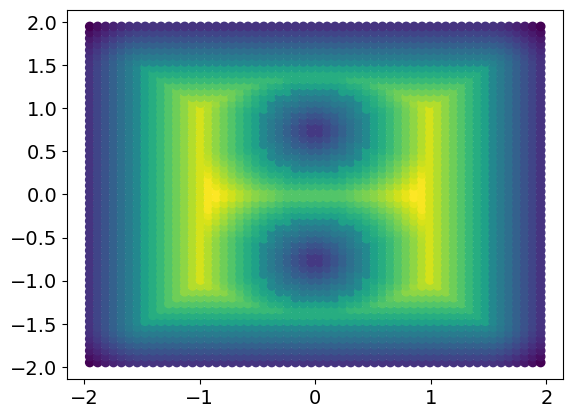

In [3]:
#####################################
### Make Signed Distance Function ###
#####################################

l = np.empty(hjb_grid.states.shape[:-1])

obs_coords = np.array([x for x in grid if obs_dict[tuple(np.round(x, 3))] != 0])
fre_coords = np.array([x for x in grid if obs_dict[tuple(np.round(x, 3))] == 0])

for i in range(n[0]):
    for j in range(n[1]):
        if obs_dict[tuple(np.round(np.array(hjb_grid.states[i, j]), 3))] != 0:
            l[i, j] = -np.min(np.linalg.norm(fre_coords - hjb_grid.states[i, j], axis=1))
        else:
            l[i, j] =  np.min(np.linalg.norm(obs_coords - hjb_grid.states[i, j], axis=1))

print(grid.shape)
plt.scatter(grid[:,0], grid[:,1], c=l.reshape(-1, 1))
plt.show()

In [4]:
#############################
### Configure HJB Solver ###
#############################
utype           ="ball"
umax            = 1
l               = jnp.array(l)
values          = l
solver_settings = hj.SolverSettings.with_accuracy("very_high",
                                                  hamiltonian_postprocessor=hj.solver.backwards_reachable_tube,
                                                  value_postprocessor      =hj.solver.static_obstacle(l))

In [5]:
###################################
### Solve PDE for final surface ###
###################################

dynamics      = hj.systems.Planar(control_type=utype, umax=umax)
time          = 0.
target_time   =-10
target_values = hj.step(solver_settings, dynamics, hjb_grid, time, values, target_time)

ball constraints with umax 1


100%|###############################################################################################################################################| 10.0000/10.0 [00:00<00:00, 11.13sim_s/s]


<Figure size 640x480 with 0 Axes>

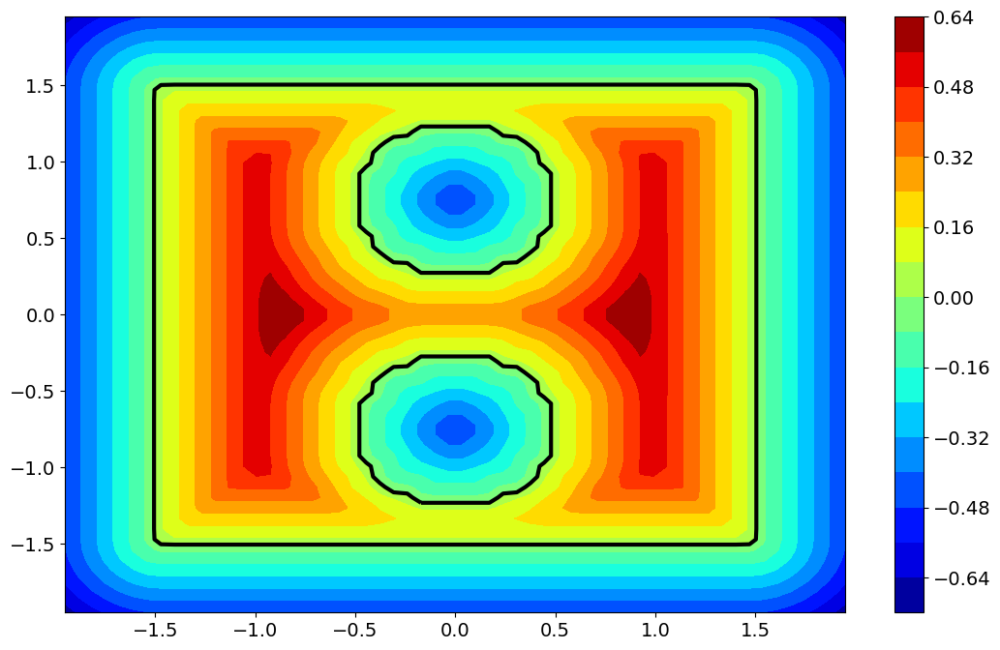

In [6]:
##########################
### Plot final surface ### 
##########################

plt.jet()
plt.figure(figsize=(13, 8))
plt.contourf(hjb_grid.coordinate_vectors[0], hjb_grid.coordinate_vectors[1], target_values[:, :].T, levels=16)
plt.colorbar()
plt.contour(hjb_grid.coordinate_vectors[0],
            hjb_grid.coordinate_vectors[1],
            target_values[:, :].T,
            levels=0,
            colors="black",
            linewidths=3)

In [7]:
##########################################
### Solve for backwards reachable tube ###
##########################################

times = np.linspace(0, -30, 58)
initial_values = l
all_values = hj.solve(solver_settings, dynamics, hjb_grid, times, initial_values)

100%|###############################################################################################################################################| 30.0000/30.0 [00:02<00:00, 10.52sim_s/s]


In [8]:
#######################################################
### Visualize evolution of backwards reachable tube ###
#######################################################

vmin, vmax = all_values.min(), all_values.max()
levels = np.linspace(round(vmin), round(vmax), 15*(round(vmax) - round(vmin) + 1))
fig = plt.figure(figsize=(13, 8))

def render_frame(i, colorbar=False):
    plt.contourf(hjb_grid.coordinate_vectors[0],
                 hjb_grid.coordinate_vectors[1],
                 all_values[i, :, :].T,
                 vmin=vmin,
                 vmax=vmax,
                 levels=levels)
    if colorbar:
        plt.colorbar()
    plt.contour(hjb_grid.coordinate_vectors[0],
                hjb_grid.coordinate_vectors[1],
                target_values[:, :].T,
                levels=0,
                colors="black",
                linewidths=3)

render_frame(0, True)
animation = HTML(anim.FuncAnimation(fig, render_frame, all_values.shape[0], interval=50).to_html5_video())
plt.close(); animation

In [9]:
###########################
### Agent Configuration ###
###########################

bf    = 31    # csrbf order
b     = 0.0   # offset 
s     = 0.66  # csrbf zeroing
rx    = 1.5   # sample radius
nm    = 0.2   # nm * n_safe = number of neighbors to consider
p     = 0.6   # num neighber percentile under which boundary
rc    = 1     # radius around scan in which centers are chosen
utype = utype # defined w/ hjb above
umax  = umax  # defined w/ hjb above
sensor_radius = 1

# make agent
a = Agent(dynamics, np.array([0, 0]), grid, obs_dict, width         = width, 
                                                      sensor_radius = 1, 
                                                      bf            = bf, 
                                                      b             = b, 
                                                      s             = s,
                                                      umax          = umax,
                                                      utype         = utype)


# Test 
x = hjb_grid.states[2, 3]
hjb_controls(a, x, hjb_grid, all_values[-1], verbose=True)


umax: 1
utype: ball
cvx result: 4.170115
dual norm result: 4.1701154708862305


array([0.79900737, 0.60132123])

In [10]:
############################
### Scan for initial CBF ###
############################

scan_safe, scan_unsafe = a.scan()

samples  = a.sample(rx, grid=s_grid)
if scan_unsafe.shape[0] != 0:
    x_unsafe = np.vstack((scan_unsafe, samples))
else: 
    x_unsafe = samples
    
n_safe = scan_safe.shape[0]
x_buffer, x_safe = a.make_buffer(scan_safe, int(nm * n_safe), p)

u_buffer = np.array([hjb_controls(a, x, hjb_grid, all_values[-1], verbose=False) for x in x_buffer])
u_safe   = np.array([hjb_controls(a, x, hjb_grid, all_values[-1], verbose=False) for x in x_safe  ])

C = []
for x in c_grid:
    if np.linalg.norm(x - a.pos) <= rc:
        C.append(x)
C = np.array(C)
a.centers.append(C)

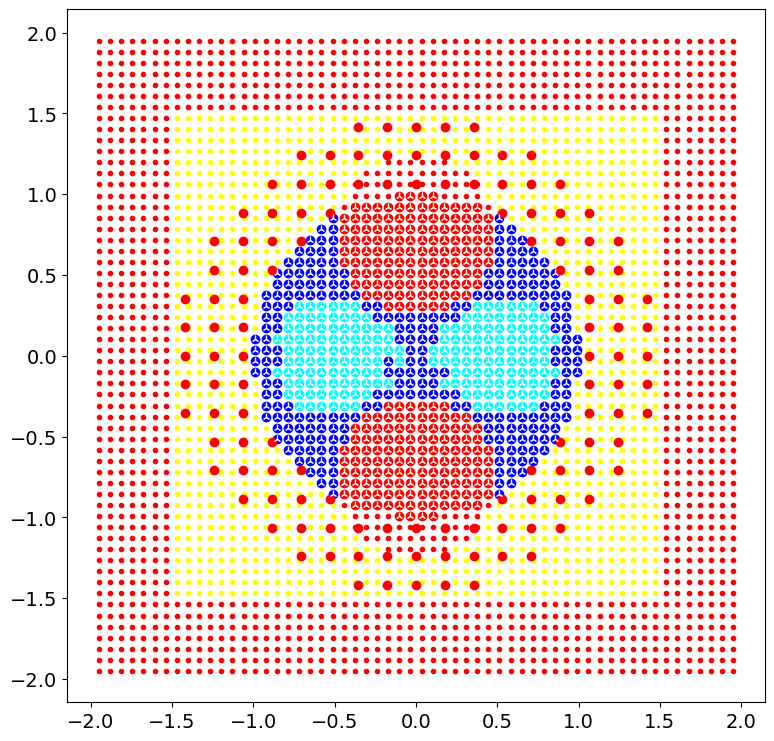

In [11]:
##############################
### Plot  Initial CBF Data ###
##############################

plot_data(grid, obs_dict, [(x_safe  , "cyan"  , 'o'), 
                           (x_buffer, "blue"  , 'o'), 
                           (x_unsafe, "red"   , 'o'),
                           (C       , "white" , '2')])

In [12]:
##############################
### Initial CBF Parameters ###
##############################
    
gamma_safe   = 0.3
gamma_unsafe = 0.0
gamma_dyn    = 0.1
lam_safe     = 25
lam_dyn      = 5
lam_unsafe   = 125
lam_dh       = 1

In [13]:
#########################
### Solve Initial CBF ###
#########################

# get h as a function of agent parameter
h = get_h(a)

L = get_learning_cbfs_lagrangian_hj(a, x_safe, u_safe, x_buffer, u_buffer, x_unsafe, lam_safe, lam_dyn, lam_unsafe, lam_dh, gamma_safe, gamma_dyn, gamma_unsafe)
theta, _, _ = scipy.optimize.fmin_l_bfgs_b(L, np.random.rand(C.shape[0], 1), approx_grad=False, iprint=50)

a.thetas.append(theta)
a.rectify_c_and_theta()

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          680     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  5.75419D+03    |proj g|=  4.01613D+01


 This problem is unconstrained.



At iterate   50    f=  9.28713D+02    |proj g|=  7.72472D-01

At iterate  100    f=  9.28653D+02    |proj g|=  6.03064D-01

At iterate  150    f=  9.28637D+02    |proj g|=  9.77421D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  680    183    280      1     0     0   9.119D-01   9.286D+02
  F =   928.63355736159428     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)


(680,)
(1, 680)


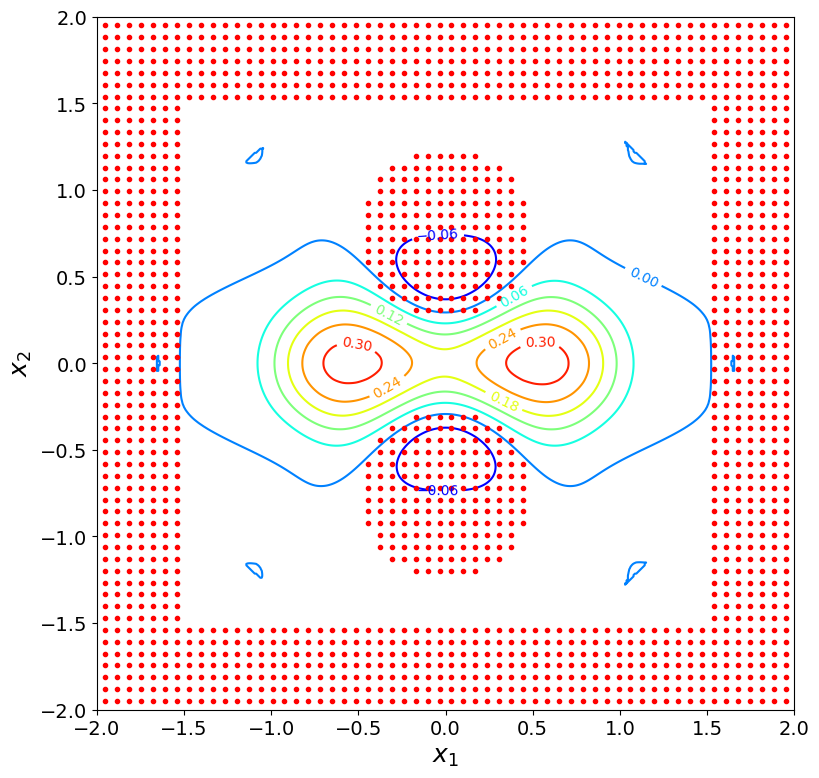

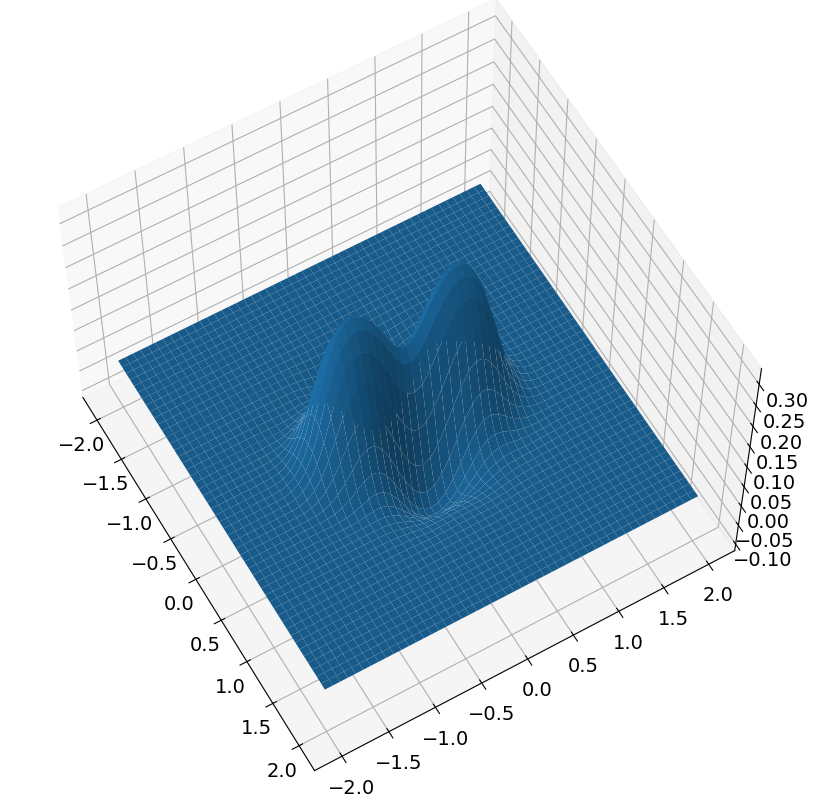

In [14]:
print(a.thetas[0].shape)
print(np.array(a.thetas).shape)
plot_cbf(a, np.array(a.centers), np.array(a.thetas), obstacles=obstacles)

In [15]:
##################################
### Configure Safe Exploration ###
##################################

tol  = 0.2 # h-value at which to halt approac
dx   = 0.5 # if |x'-x|<dx, approach again
tend = 50  # Duration of boundary approach
T    = 3   # MPC horizon (default timestep is 0.05)
N    = 30  # number of CBFs to learn

target: [ 0.87068178 -1.74628676]
target in goto [ 0.87068178 -1.74628676]
position is [0 0]
h is 0.19995207961008266
start time is 0


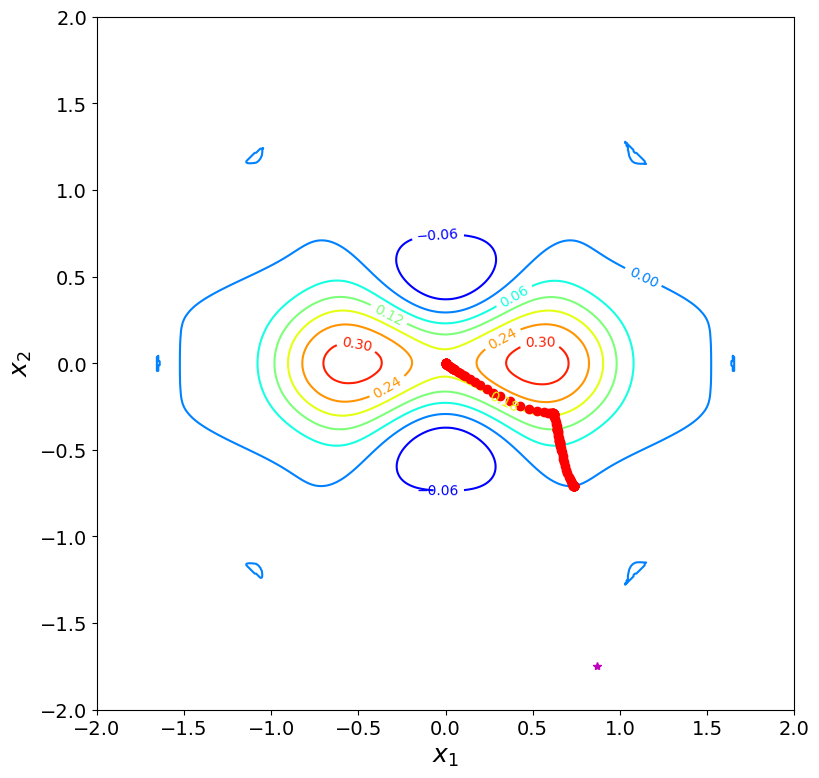

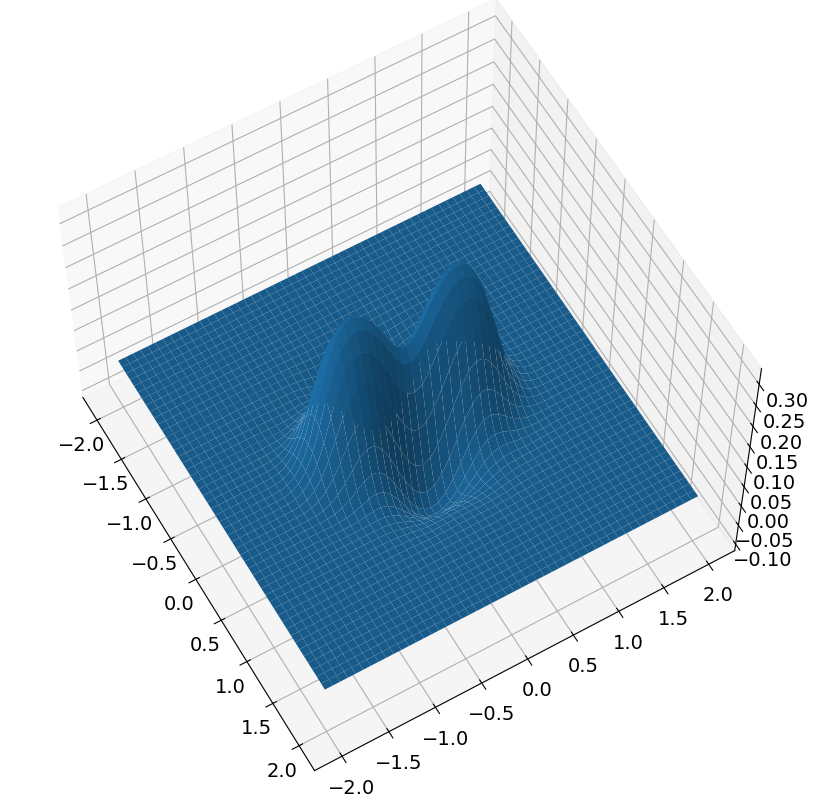

new position is [ 0.73434679 -0.70781084]
h is now 1.1514162596824255e-05
new time is 50
dx: 1.0199320558960596


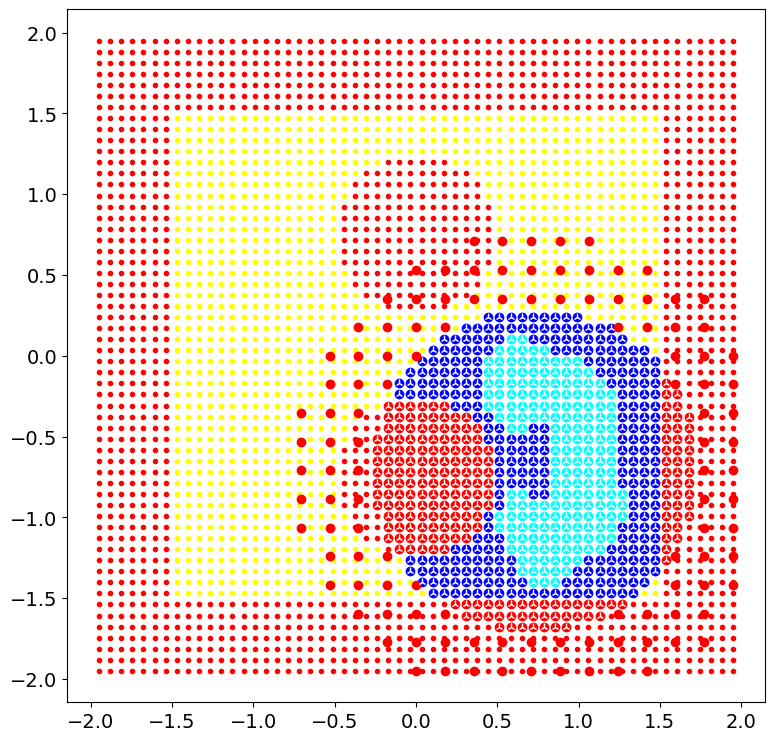

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          672     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.52543D+06    |proj g|=  1.29049D+02


 This problem is unconstrained.



At iterate   50    f=  7.50961D+02    |proj g|=  1.77849D+00

At iterate  100    f=  7.50578D+02    |proj g|=  9.99346D-01

At iterate  150    f=  7.50452D+02    |proj g|=  1.24461D+00

At iterate  200    f=  7.50405D+02    |proj g|=  1.42847D+00

At iterate  250    f=  7.50360D+02    |proj g|=  1.16255D+00

At iterate  300    f=  7.50349D+02    |proj g|=  1.09400D+00

At iterate  350    f=  7.50337D+02    |proj g|=  8.94137D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  672    384    607      1     0     0   8.246D-01   7.503D+02
  F =   750.33387017982432     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

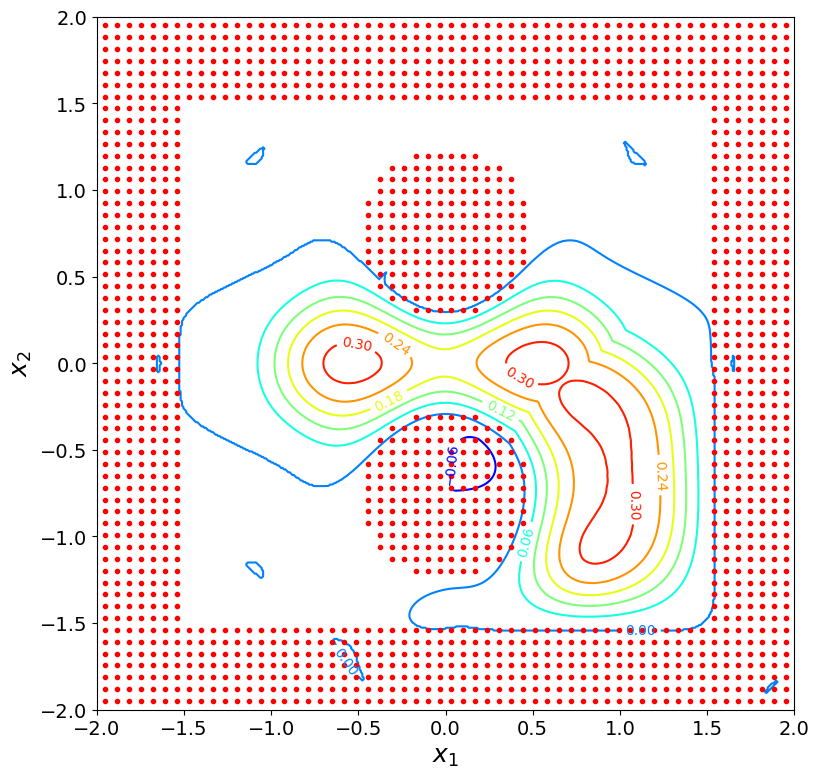

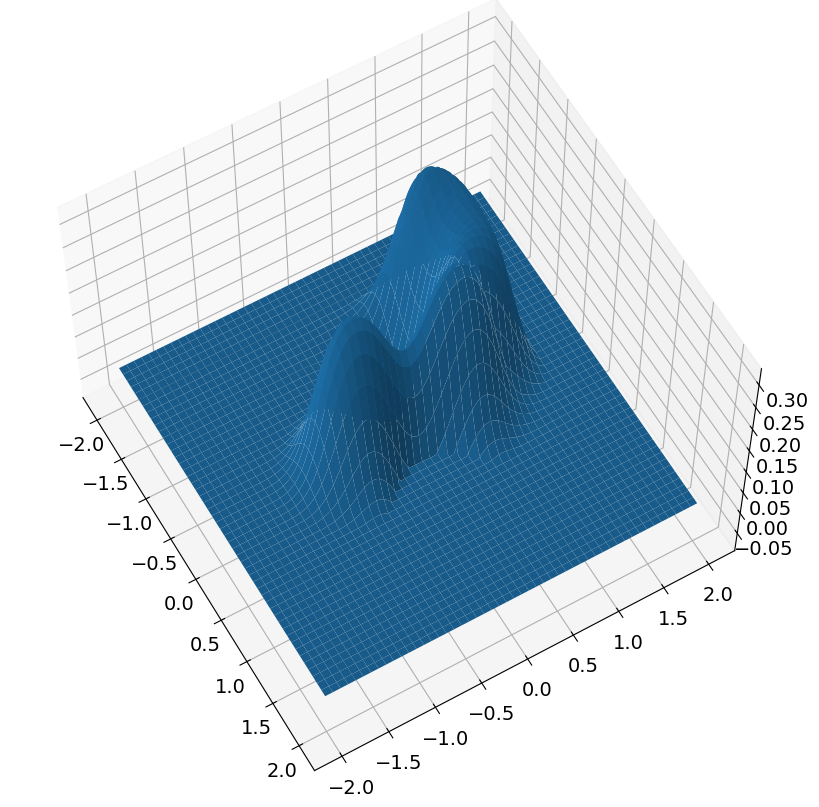

target: [1.9430781  0.69949649]
target in goto [1.9430781  0.69949649]
position is [ 0.73434679 -0.70781084]
h is 0.2391165787695634
start time is 50


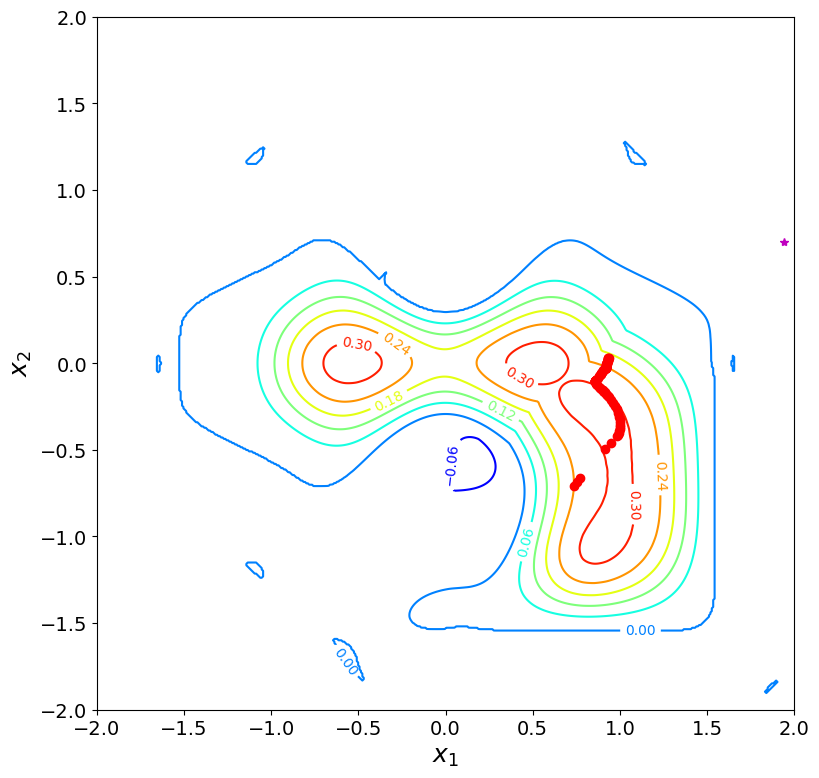

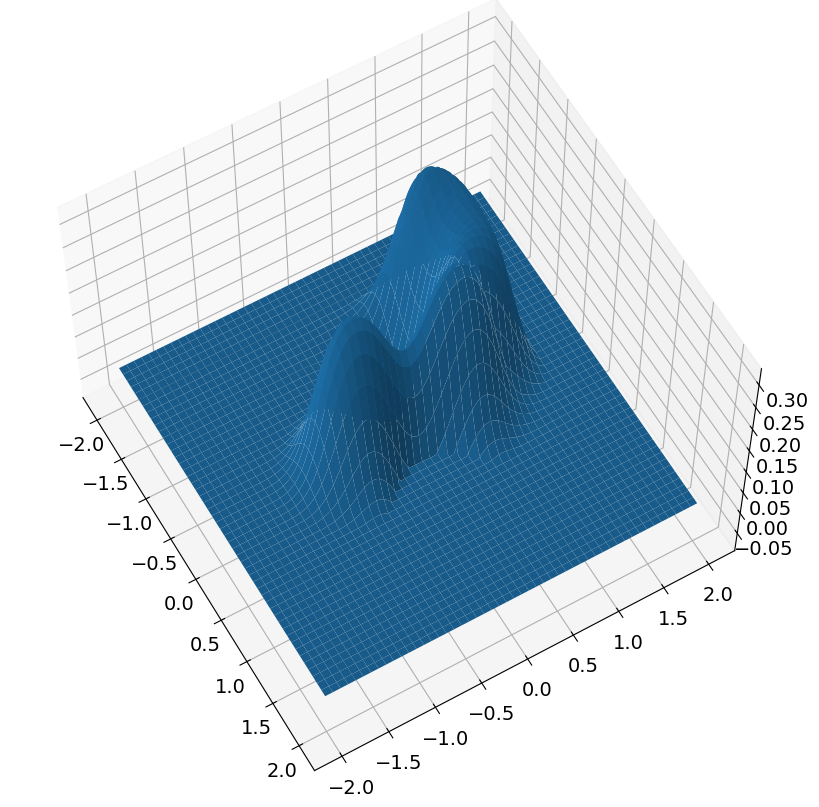

new position is [0.93464543 0.03118508]
h is now 0.20000000000000007
new time is 100
dx: 0.7656595275834496


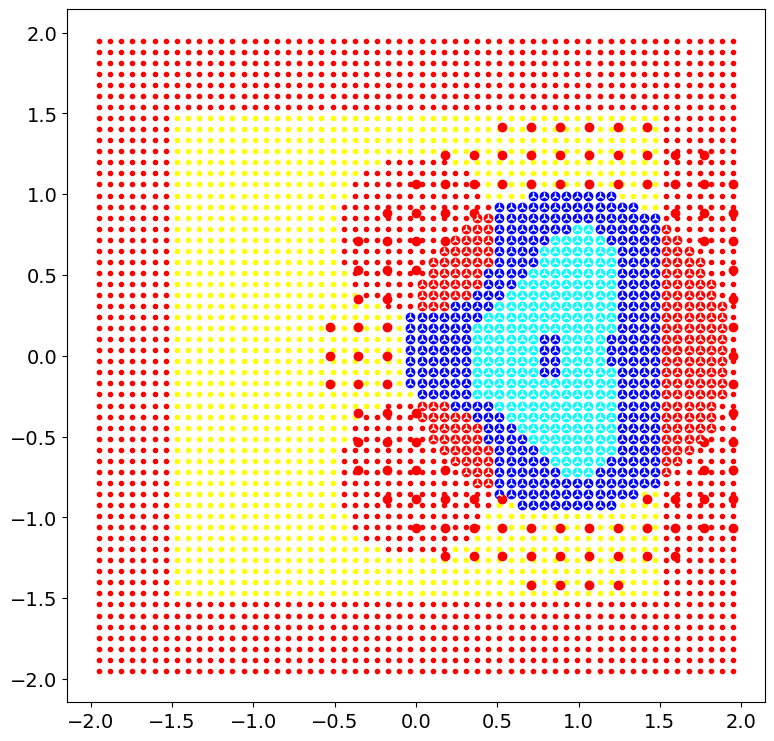

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          671     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.51430D+06    |proj g|=  1.27670D+02


 This problem is unconstrained.



At iterate   50    f=  7.24849D+02    |proj g|=  8.77022D-01

At iterate  100    f=  7.24643D+02    |proj g|=  1.41526D+00

At iterate  150    f=  7.24575D+02    |proj g|=  5.57161D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  671    166    302      1     0     0   8.795D-01   7.246D+02
  F =   724.57221674265566     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(671, 2)
numc 671
cmax before 680
numc <= self.cmax
Cnew shape before (671, 2)
Cnew shape after (671, 2)
theta shape before (671,)
theta_shape after (680,)
cmax after 680
centers shape after
(680, 


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


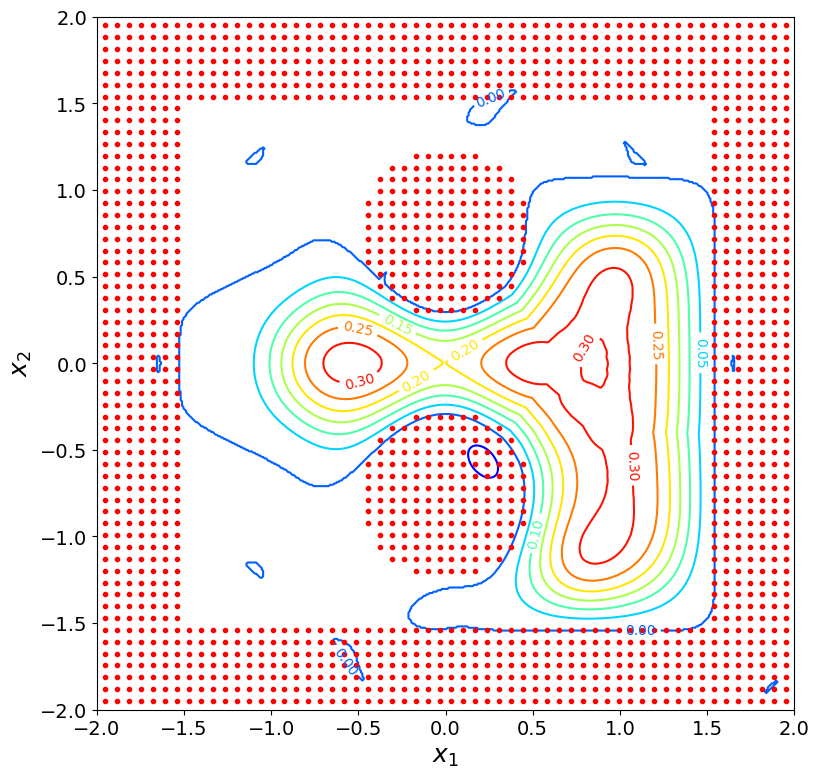

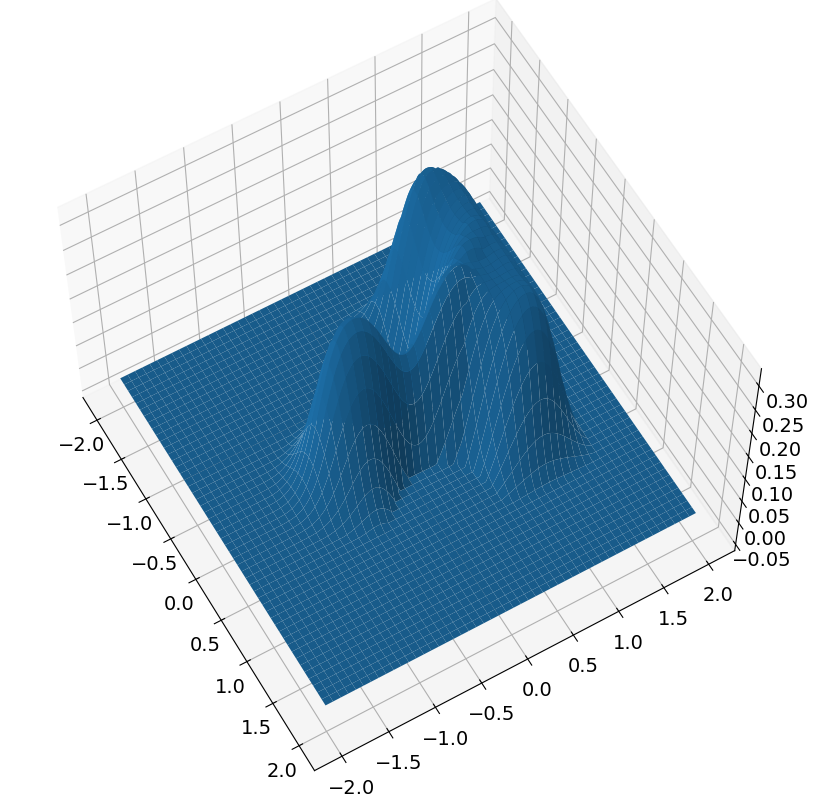

target: [-1.49760215 -1.3374883 ]
target in goto [-1.49760215 -1.3374883 ]
position is [0.93464543 0.03118508]
h is 0.3003818722035003
start time is 100


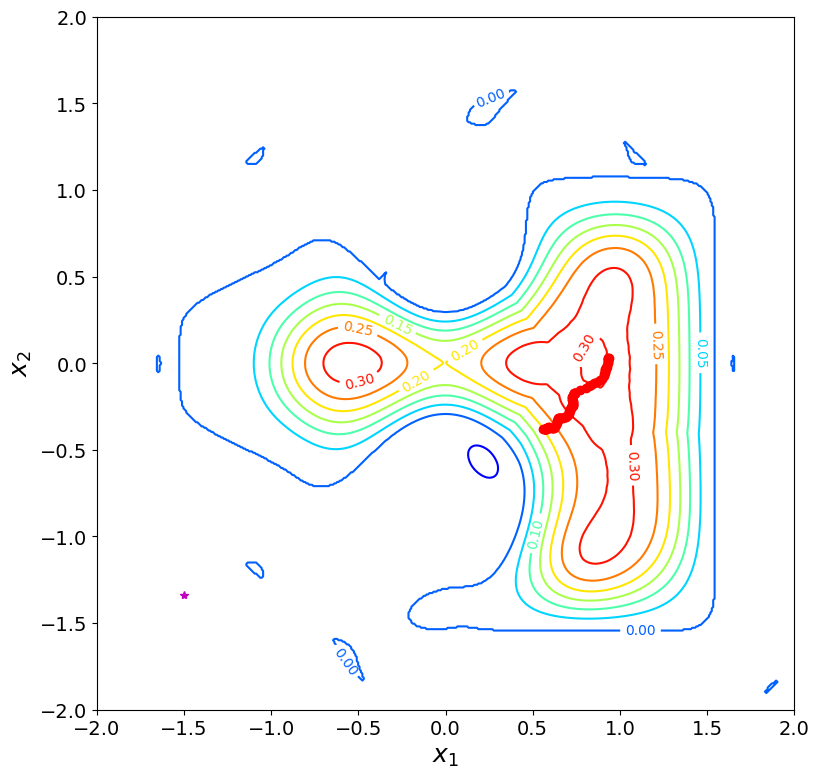

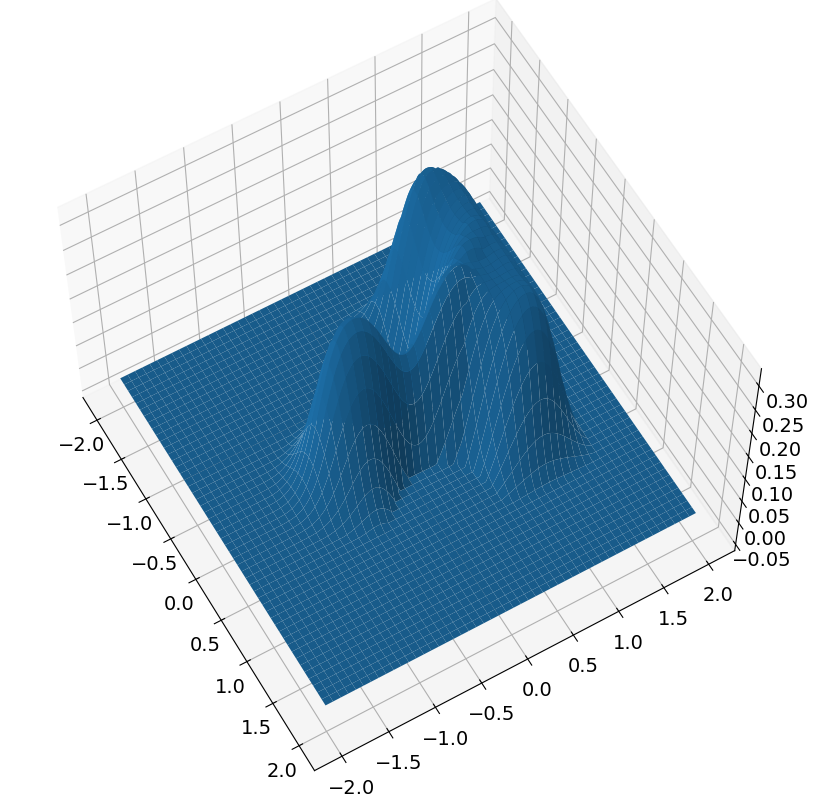

new position is [ 0.55926862 -0.37747884]
h is now 0.2
new time is 150
dx: 0.5548999461409514


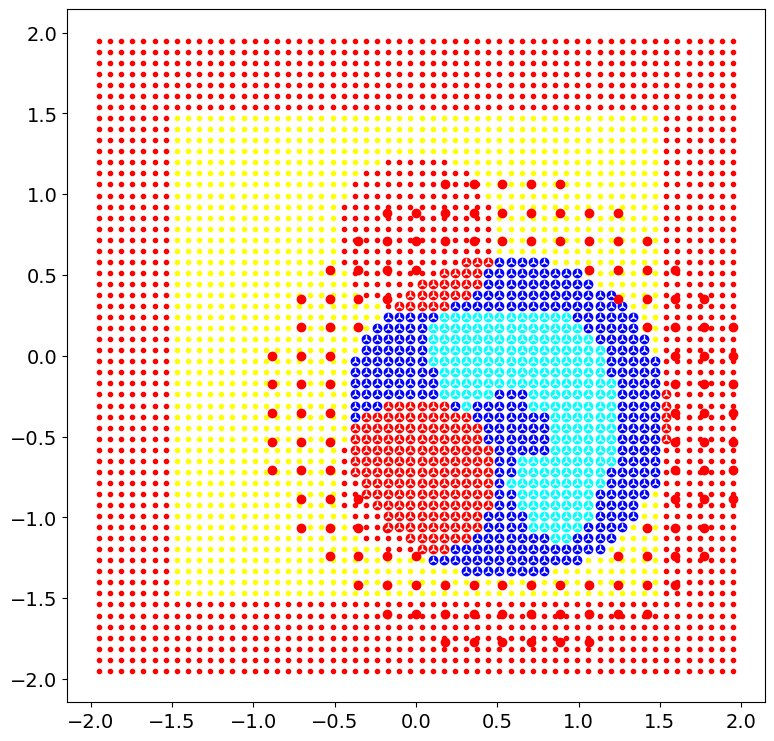

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          669     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53850D+06    |proj g|=  1.25465D+02


 This problem is unconstrained.



At iterate   50    f=  8.15859D+02    |proj g|=  1.55082D+00

At iterate  100    f=  8.15807D+02    |proj g|=  1.00759D+00

At iterate  150    f=  8.15772D+02    |proj g|=  1.34619D+00

At iterate  200    f=  8.15767D+02    |proj g|=  9.84630D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  669    225    342      1     0     0   1.099D+00   8.158D+02
  F =   815.76502168175045     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(669, 2)
numc 669
cmax before 680
numc <= self.cmax
Cnew shape before (669, 2)
Cnew shape after (669, 2)
theta shape before (6

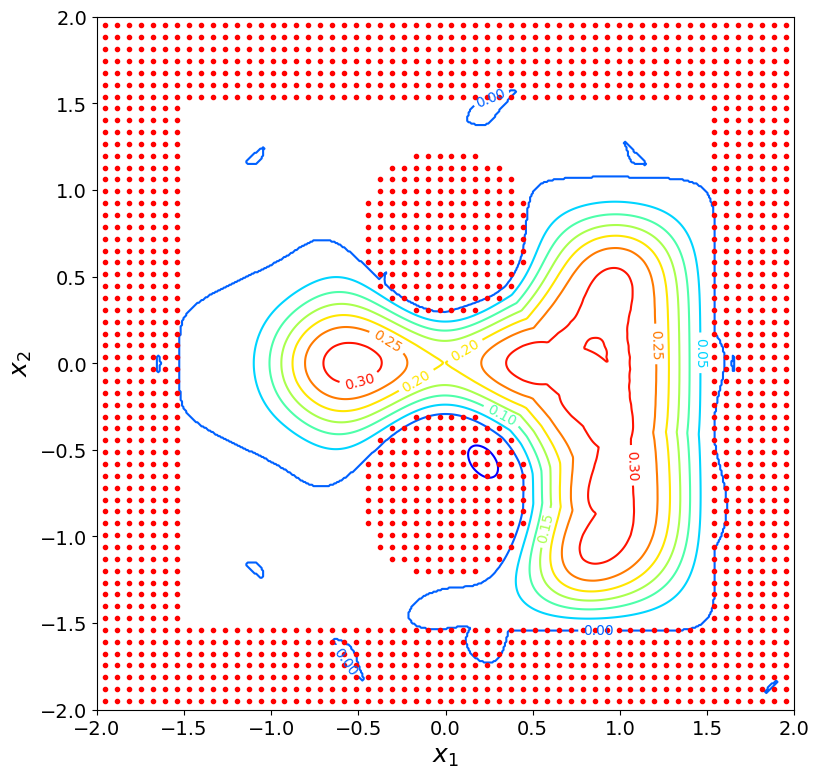

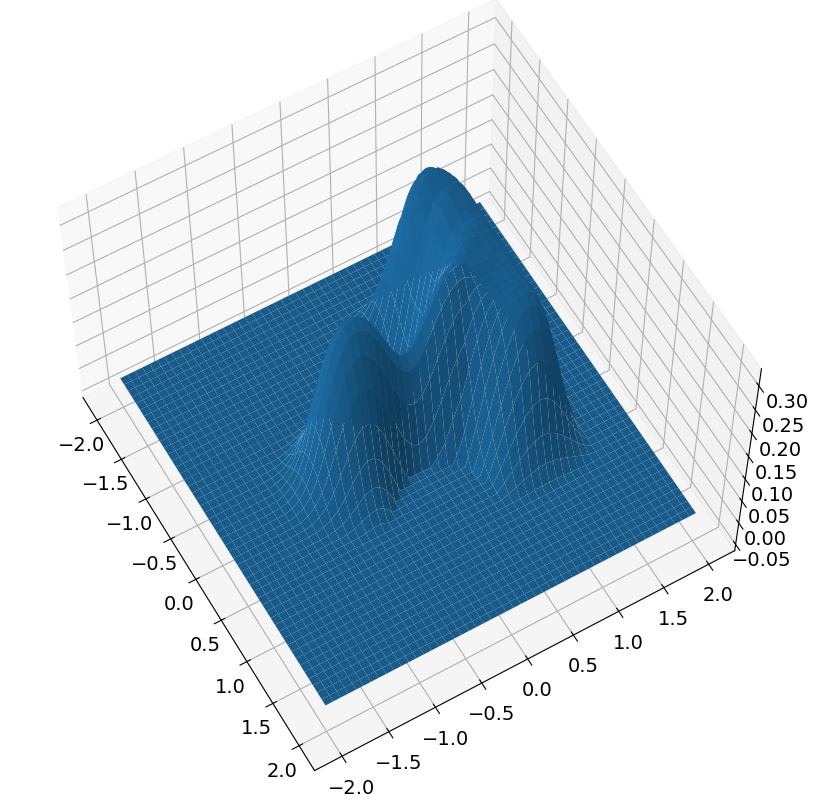

target: [-0.31107513  1.42187195]
target in goto [-0.31107513  1.42187195]
position is [ 0.55926862 -0.37747884]
h is 0.2
start time is 150


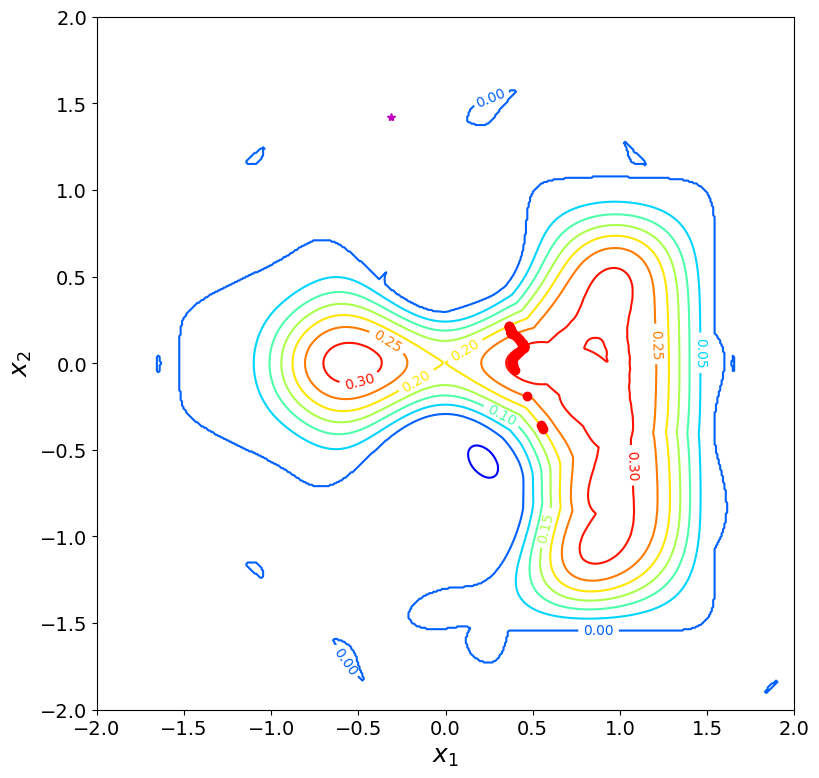

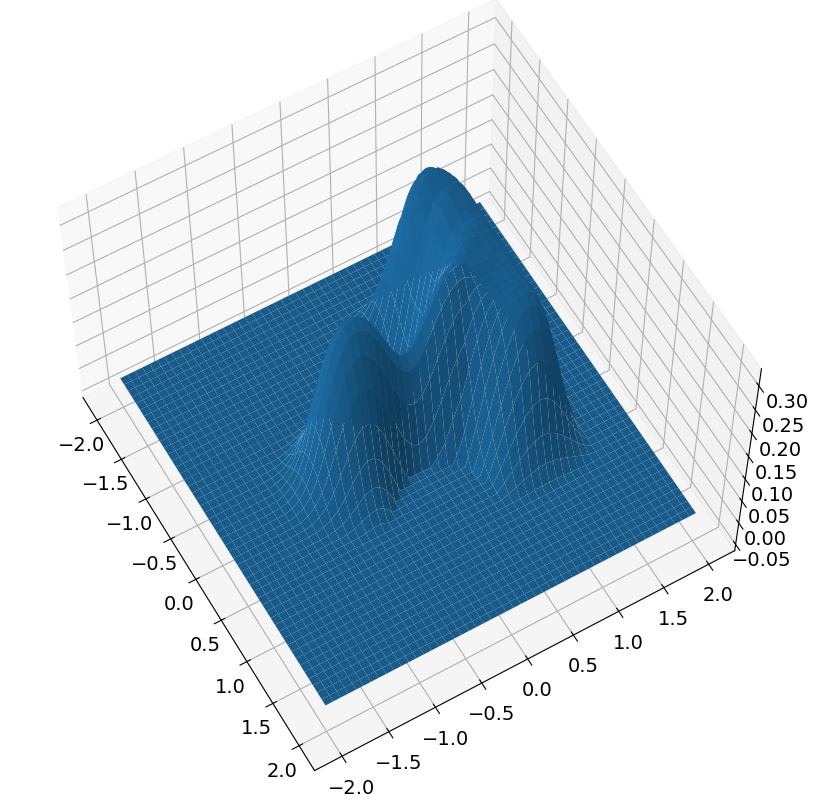

new position is [0.36366962 0.21491331]
h is now 0.19999999999999996
new time is 200
dx: 0.6238488832109045


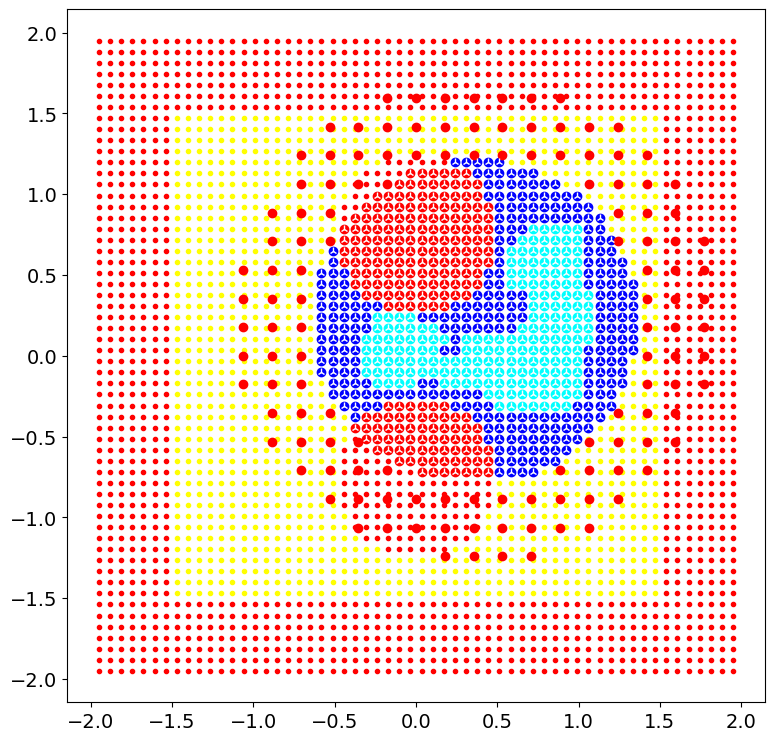

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          671     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.50107D+06    |proj g|=  1.26617D+02


 This problem is unconstrained.



At iterate   50    f=  8.58343D+02    |proj g|=  7.27919D-01

At iterate  100    f=  8.58292D+02    |proj g|=  7.76946D-01

At iterate  150    f=  8.58281D+02    |proj g|=  4.60682D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  671    155    326      1     0     0   1.522D+00   8.583D+02
  F =   858.28084521460994     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(671, 2)
numc 671
cmax before 680
numc <= self.cmax
Cnew shape before (671, 2)
Cnew shape after (671, 2)
theta shape before (671,)
theta_shape after (680,)
cmax after 680
centers 

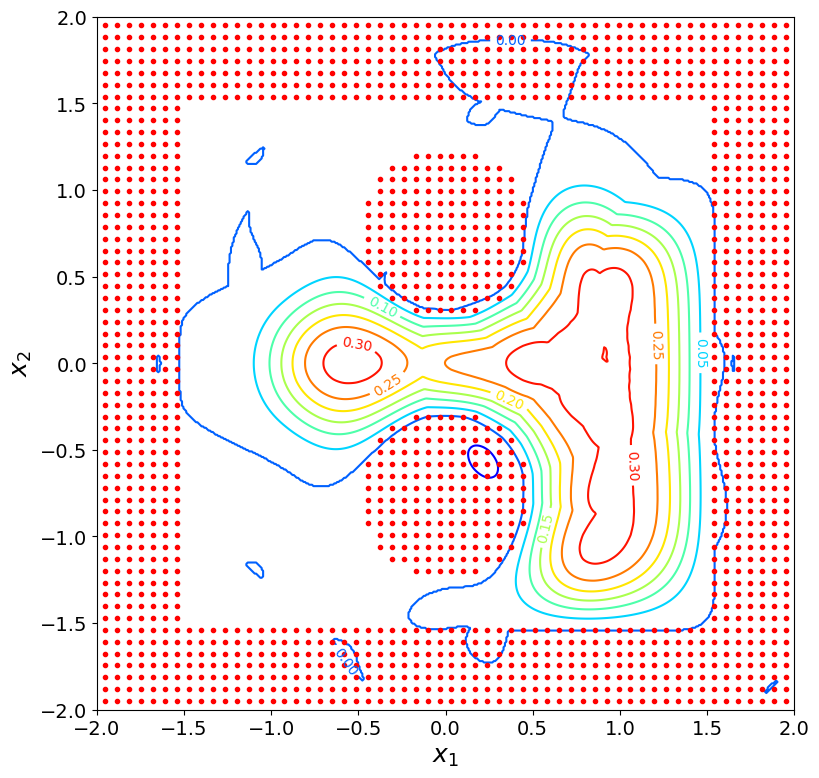

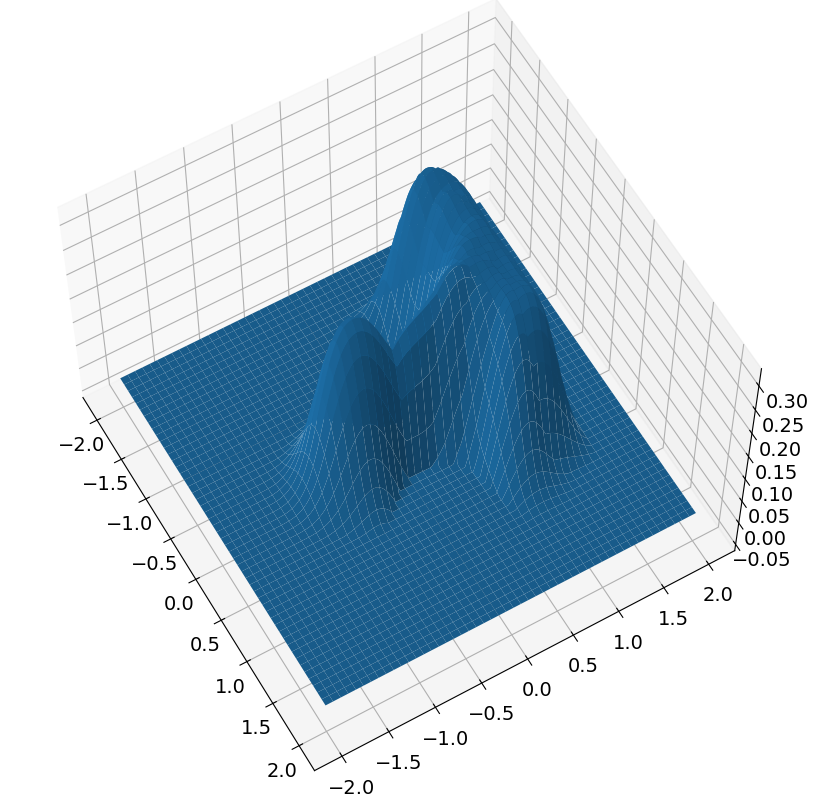

target: [-0.97750568  1.83976433]
target in goto [-0.97750568  1.83976433]
position is [0.36366962 0.21491331]
h is 0.19999999999999996
start time is 200


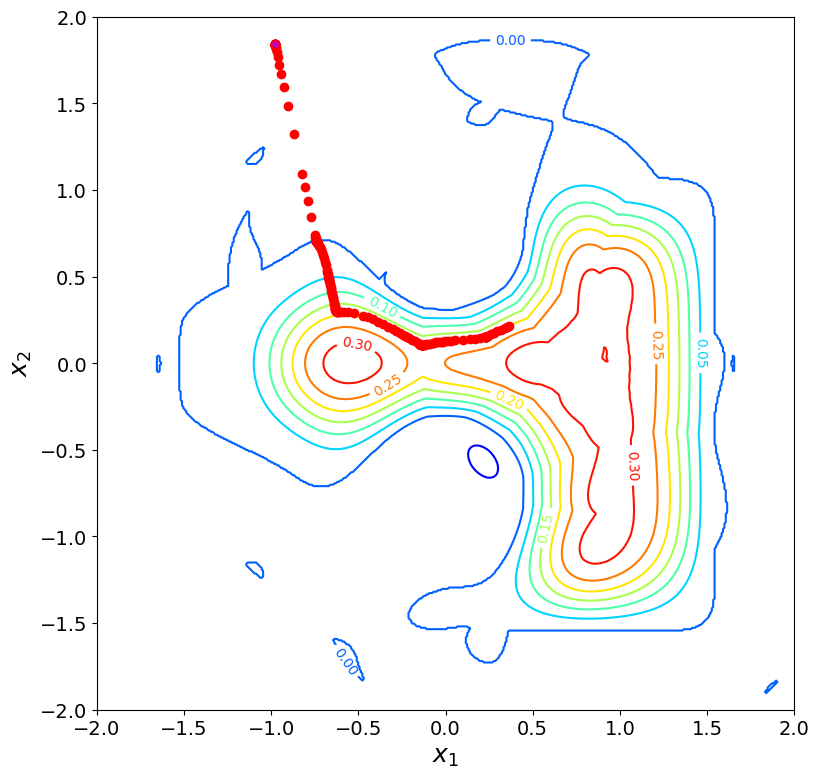

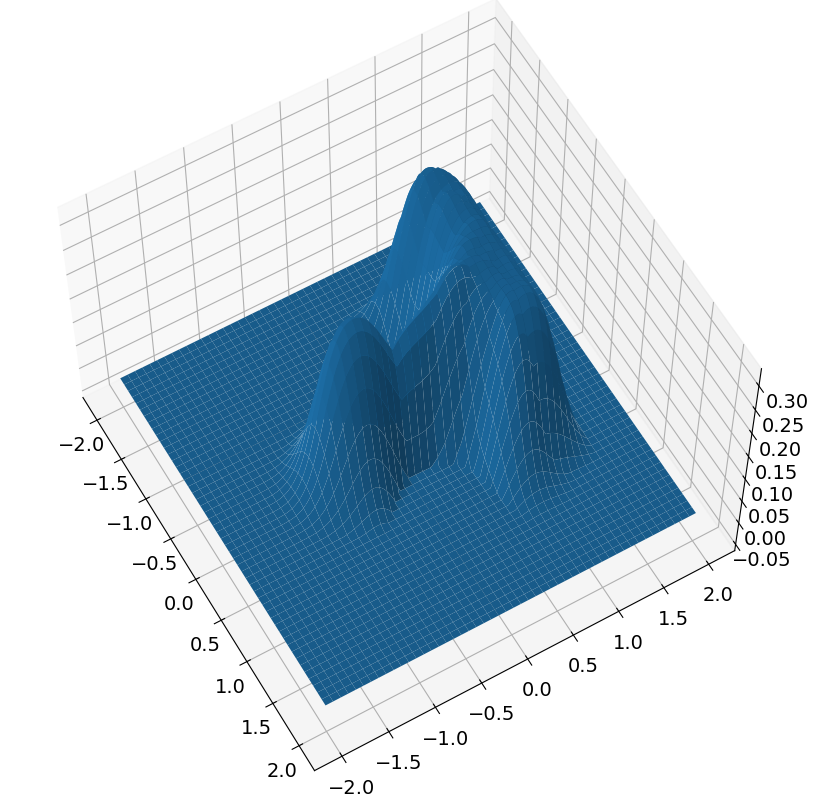

new position is [-0.9775057   1.83976435]
h is now 0.0
new time is 250
dx: 2.1068678541029926


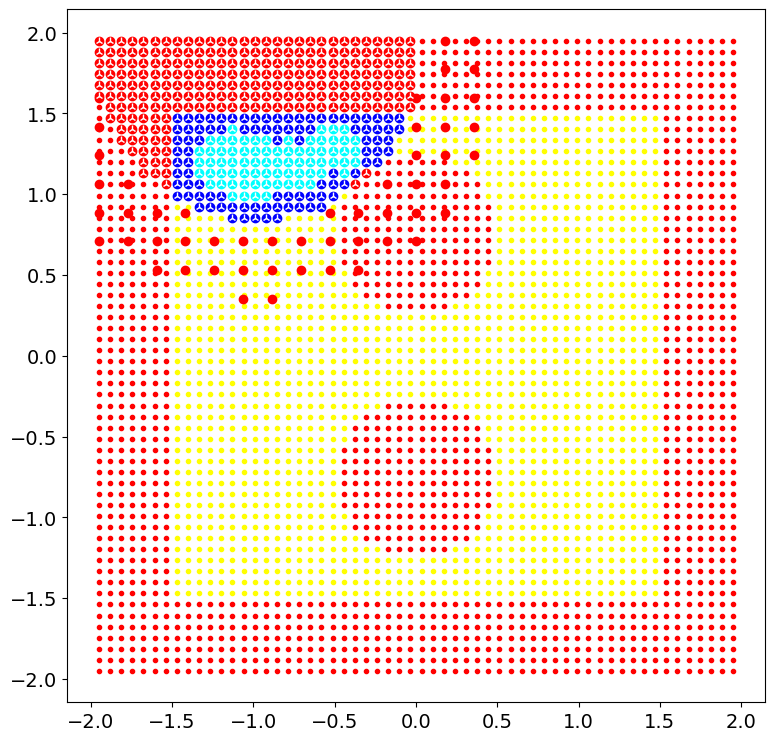

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          397     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  8.51365D+05    |proj g|=  1.25917D+02


 This problem is unconstrained.



At iterate   50    f=  4.66896D+02    |proj g|=  2.81067D+00

At iterate  100    f=  4.66682D+02    |proj g|=  1.26989D+00

At iterate  150    f=  4.66651D+02    |proj g|=  7.86587D-01

At iterate  200    f=  4.66634D+02    |proj g|=  7.01148D-01

centers shape before:
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(397, 2)
numc 397
cmax before 680
numc <= self.cmax
Cnew shape before (397, 2)
Cnew shape after (397, 2)
theta shape before (397,)
theta_shape after (680,)
cmax after 680
centers shape after
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  397    211    388 

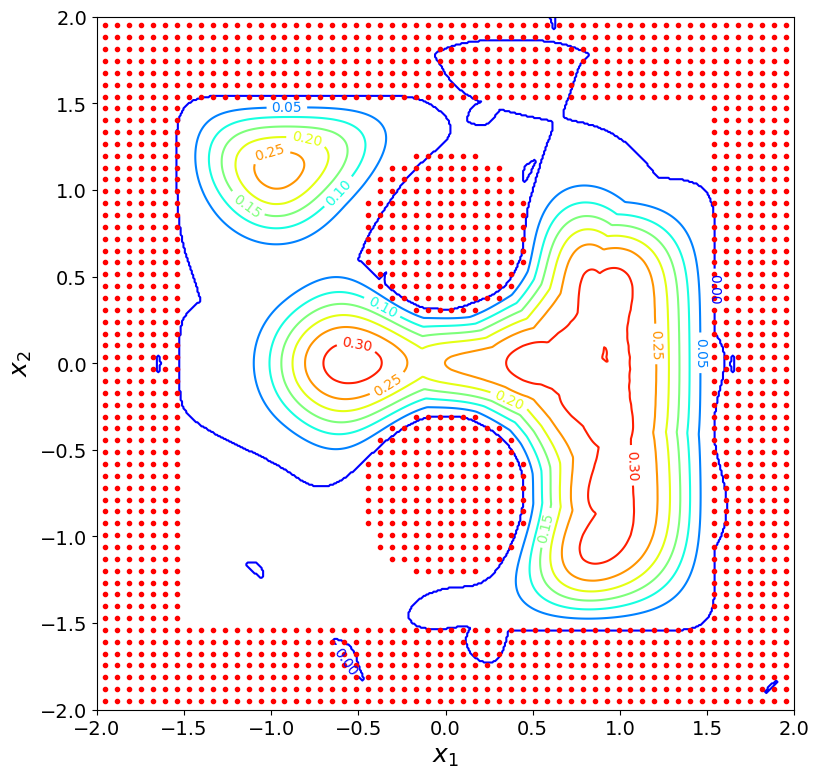

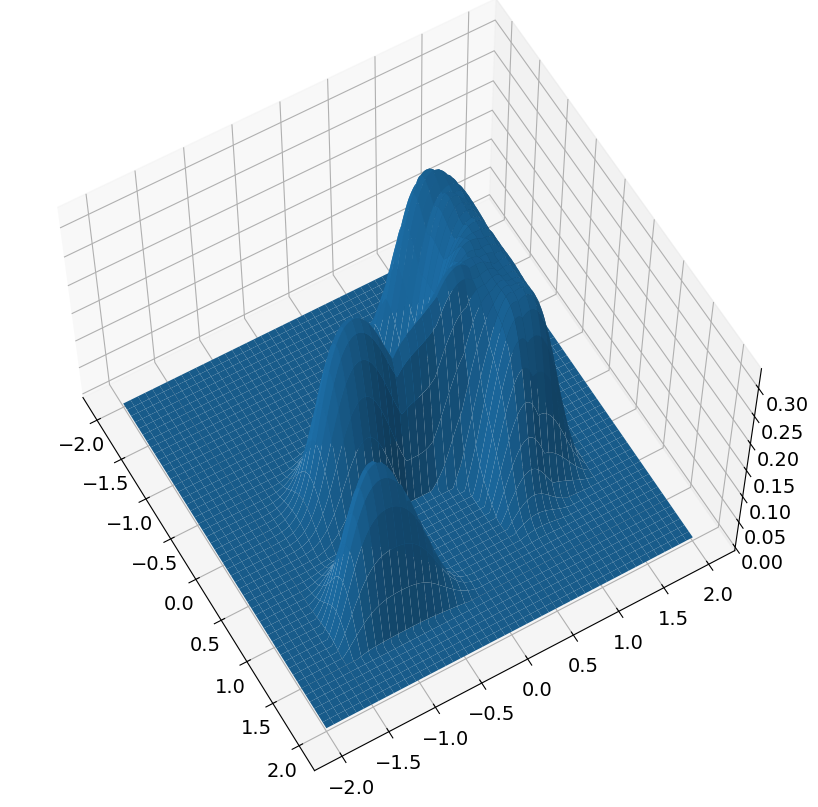

target: [-1.65331602 -0.78102453]
target in goto [-1.65331602 -0.78102453]
position is [-0.9775057   1.83976435]
h is 0.0
start time is 250


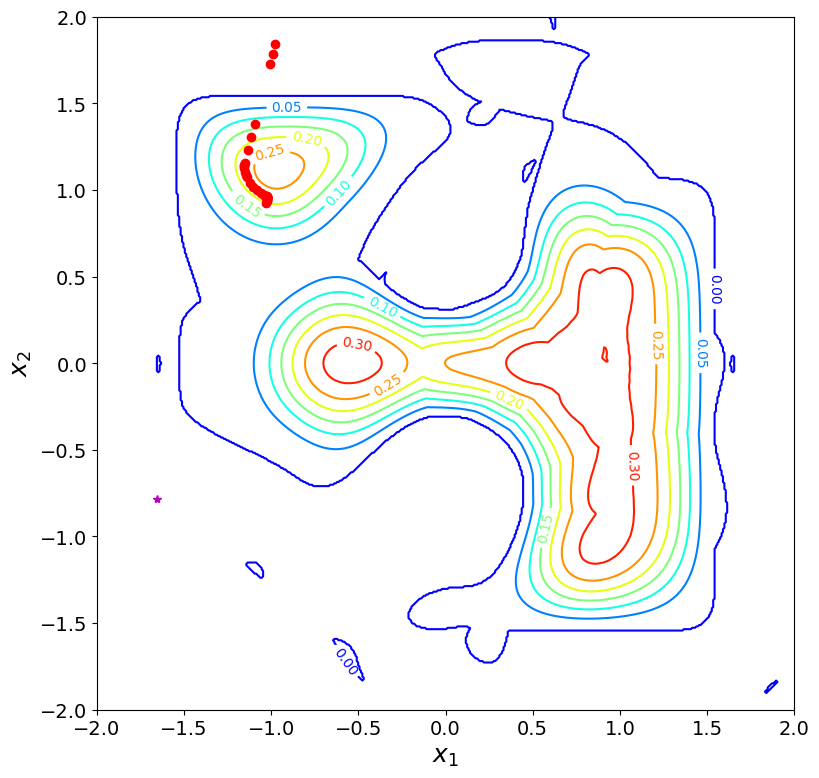

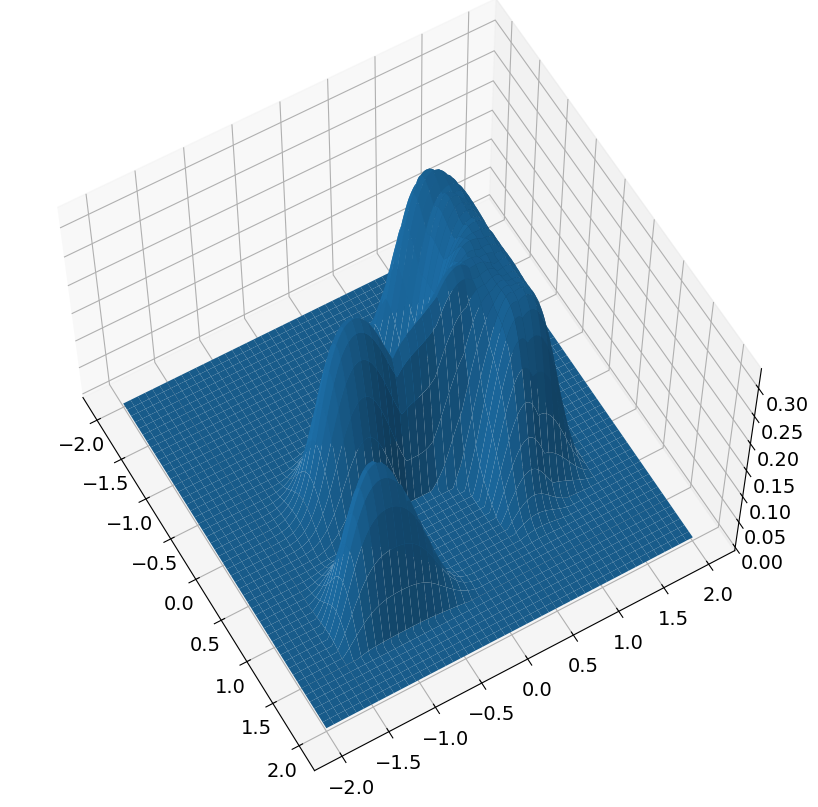

new position is [-1.02730739  0.92753227]
h is now 0.2
new time is 300
dx: 0.91359048895567


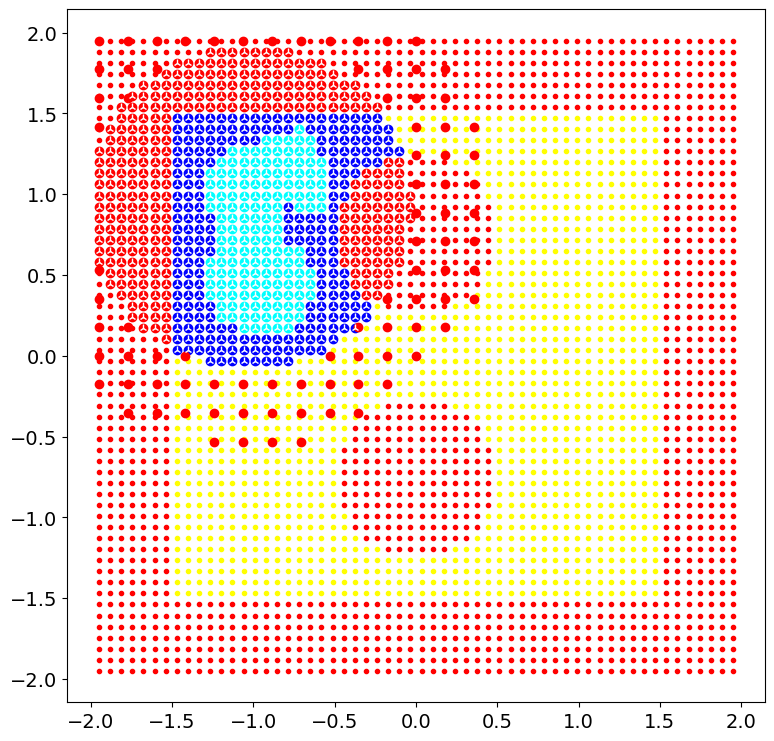

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          669     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.44440D+06    |proj g|=  1.28964D+02


 This problem is unconstrained.



At iterate   50    f=  6.23115D+02    |proj g|=  1.02179D+00

At iterate  100    f=  6.22708D+02    |proj g|=  1.61850D+00

At iterate  150    f=  6.22652D+02    |proj g|=  1.94044D+00

At iterate  200    f=  6.22613D+02    |proj g|=  1.32875D+00

At iterate  250    f=  6.22594D+02    |proj g|=  1.00691D+00

At iterate  300    f=  6.22577D+02    |proj g|=  1.44354D+00

At iterate  350    f=  6.22562D+02    |proj g|=  9.30905D-01

At iterate  400    f=  6.22552D+02    |proj g|=  9.37808D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  669    427    621      1     0     0   1.310D+00   6.225D+02
  F =   622.549194577

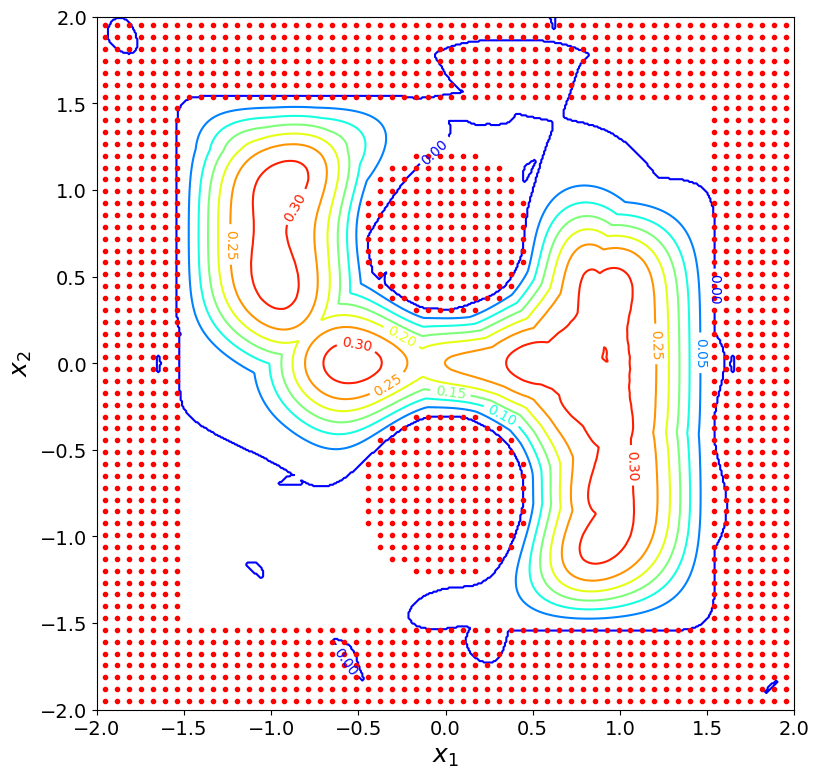

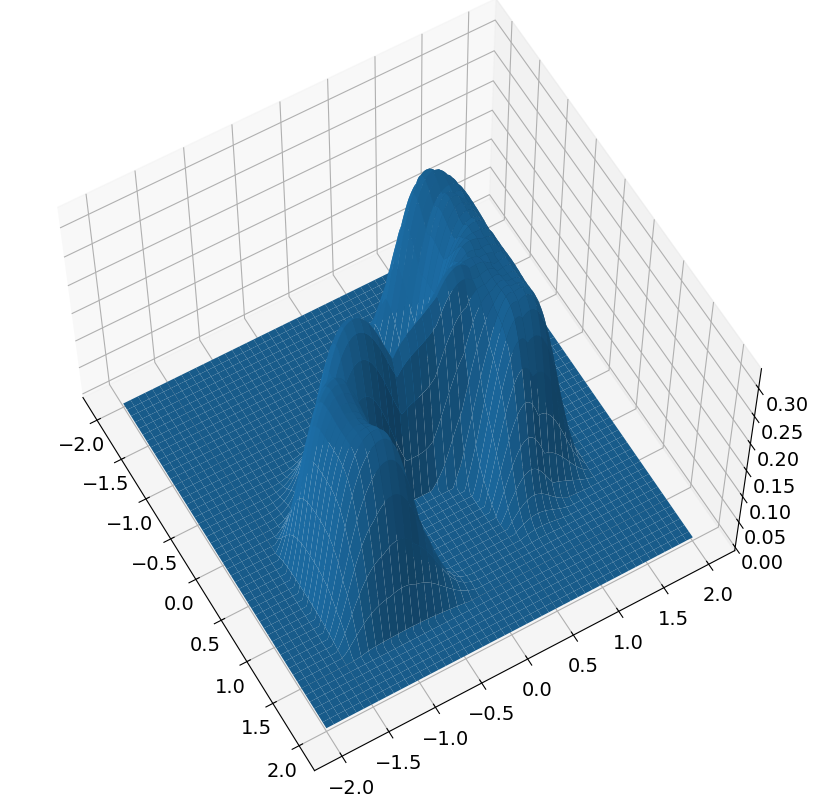

target: [-1.86940405  1.67517732]
target in goto [-1.86940405  1.67517732]
position is [-1.02730739  0.92753227]
h is 0.3102020705495503
start time is 300


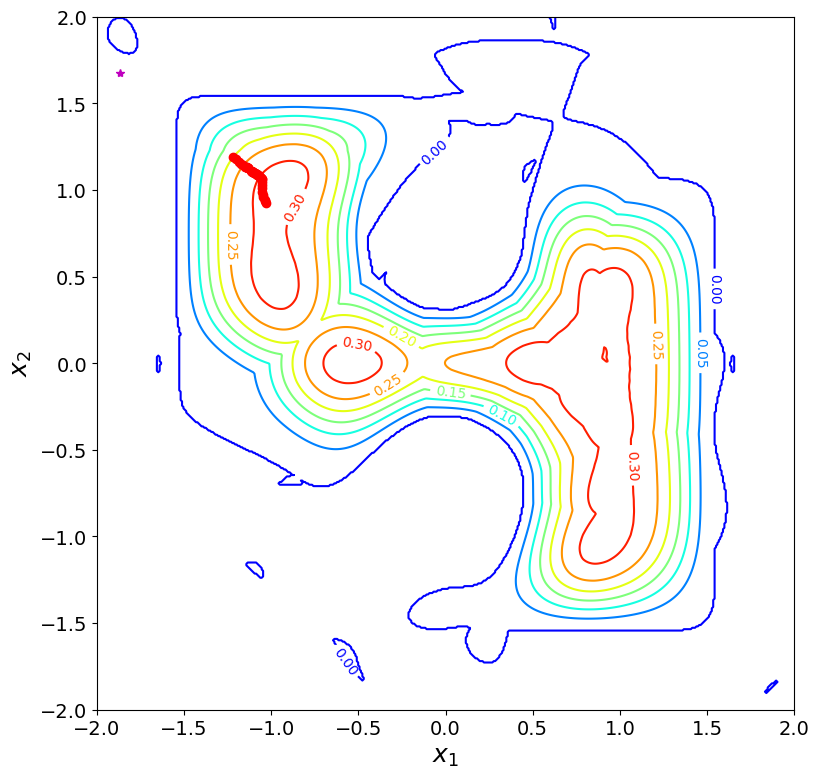

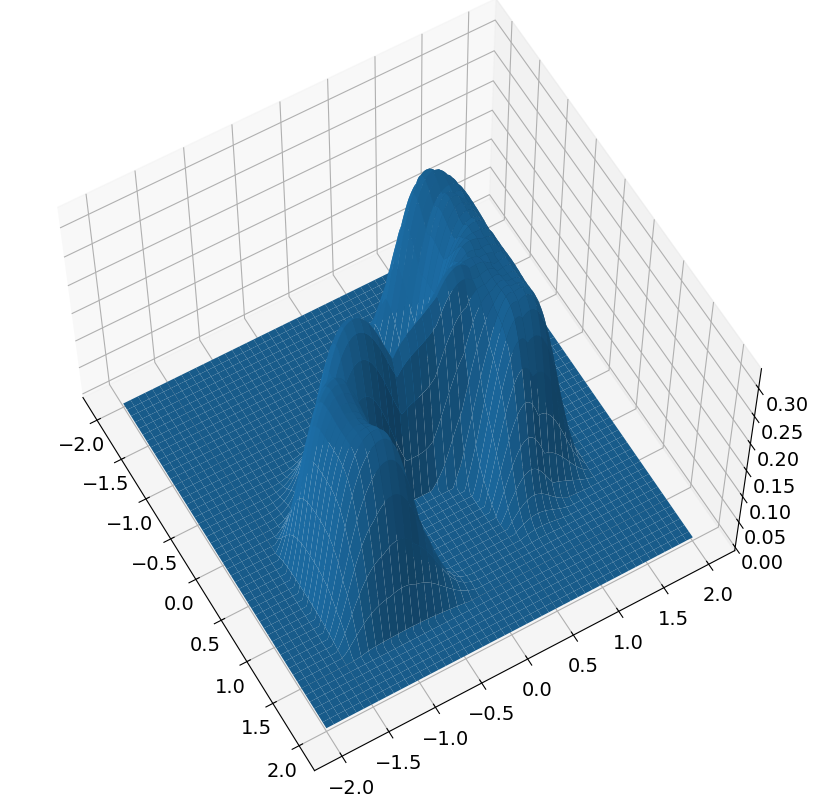

new position is [-1.21737285  1.19005279]
h is now 0.20000000000000004
new time is 350
dx: 0.3241016868647124


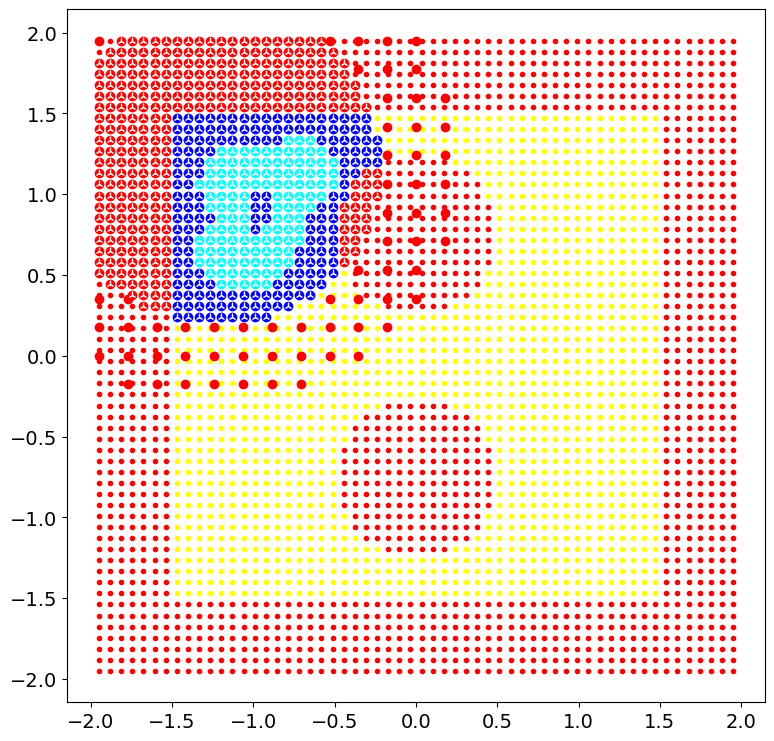

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          593     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.27160D+06    |proj g|=  1.27255D+02


 This problem is unconstrained.



At iterate   50    f=  5.62177D+02    |proj g|=  2.01220D+00

At iterate  100    f=  5.61795D+02    |proj g|=  1.18652D+00

At iterate  150    f=  5.61536D+02    |proj g|=  8.13172D-01

At iterate  200    f=  5.61508D+02    |proj g|=  9.04768D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  593    244    371      1     0     0   1.190D+00   5.615D+02
  F =   561.49597218879785     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(593, 2)
numc 593
cmax before 680
numc <= self.cmax
Cnew shape before (593, 2)
Cnew shape 

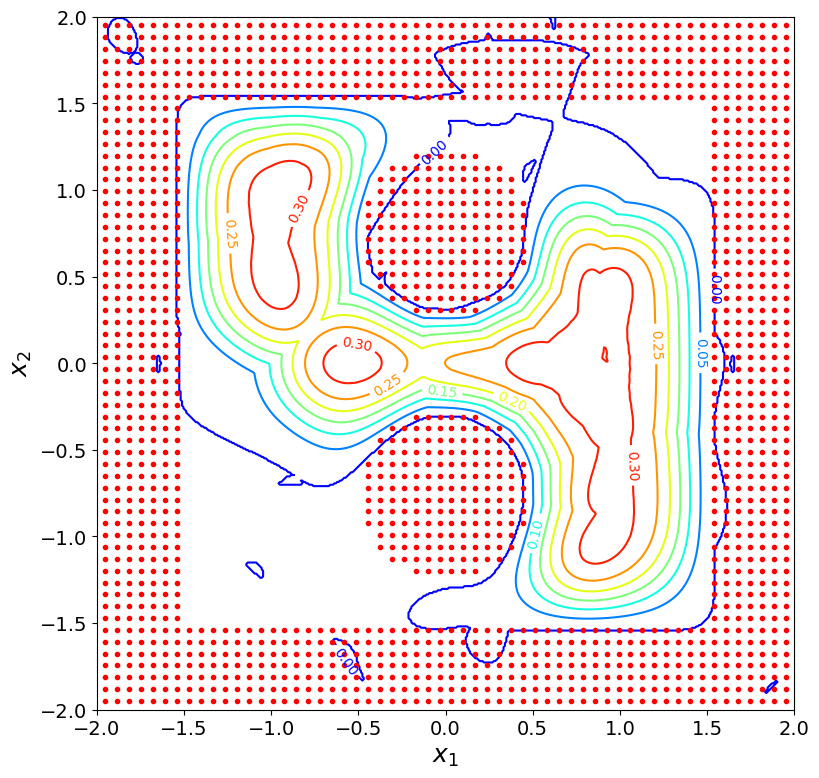

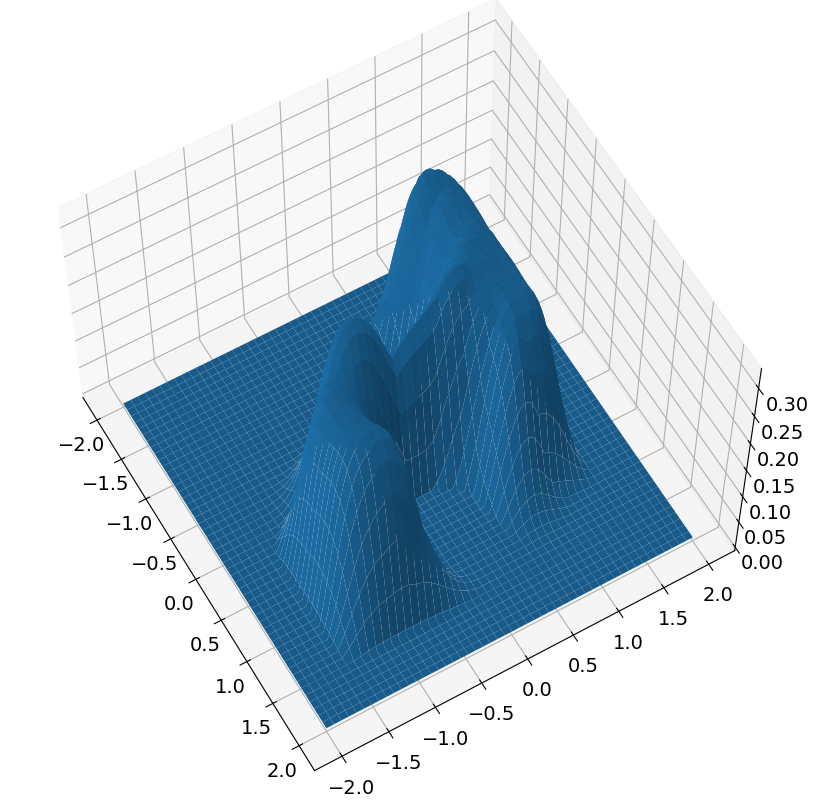

target: [ 1.81362098 -1.55906735]
target in goto [ 1.81362098 -1.55906735]
position is [-1.21737285  1.19005279]
h is 0.216279273102569
start time is 350


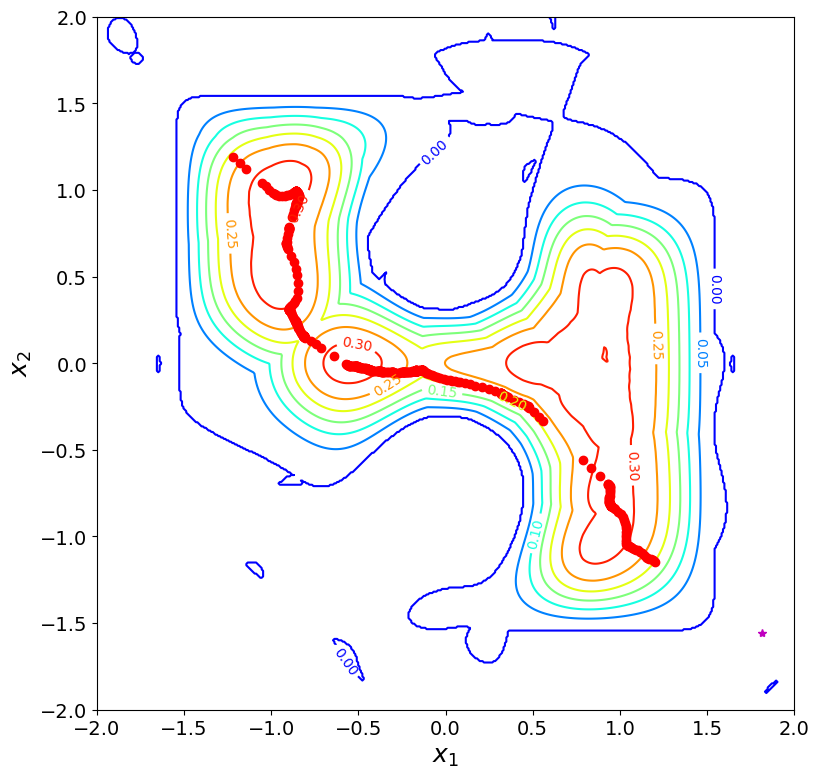

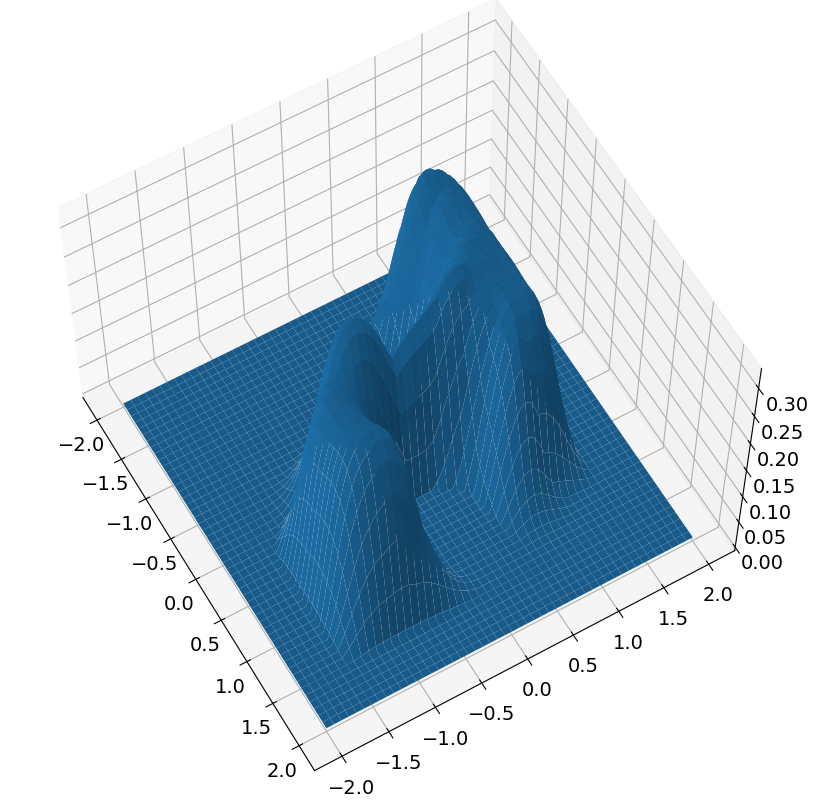

new position is [ 1.19842721 -1.14599669]
h is now 0.1999999999999999
new time is 400
dx: 3.3605382164082793


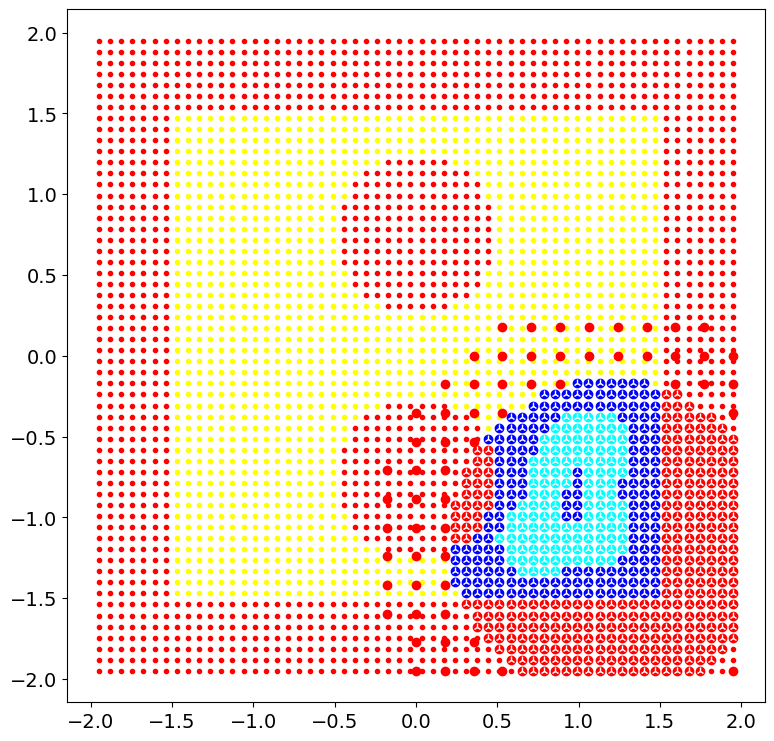

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          607     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30067D+06    |proj g|=  1.25912D+02


 This problem is unconstrained.



At iterate   50    f=  5.58983D+02    |proj g|=  2.13313D+00

At iterate  100    f=  5.58372D+02    |proj g|=  1.50218D+00

At iterate  150    f=  5.58254D+02    |proj g|=  1.27457D+00

At iterate  200    f=  5.58235D+02    |proj g|=  8.84218D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  607    202    296      1     0     0   7.776D-01   5.582D+02
  F =   558.23495288616880     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(607, 2)
numc 607
cmax before 680
numc <= self.cmax
Cnew shape before (607, 2)
Cn

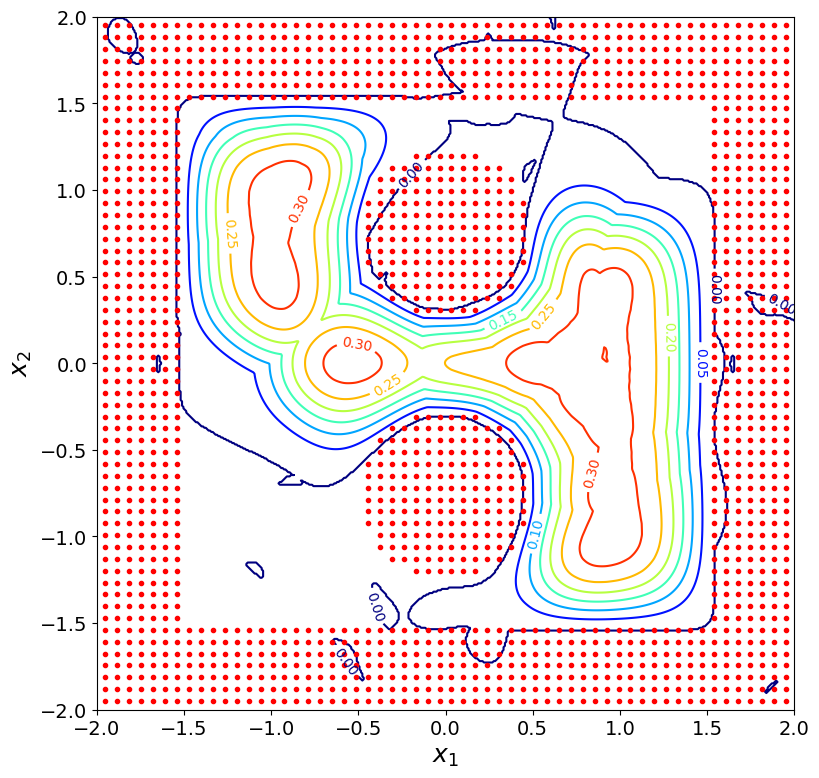

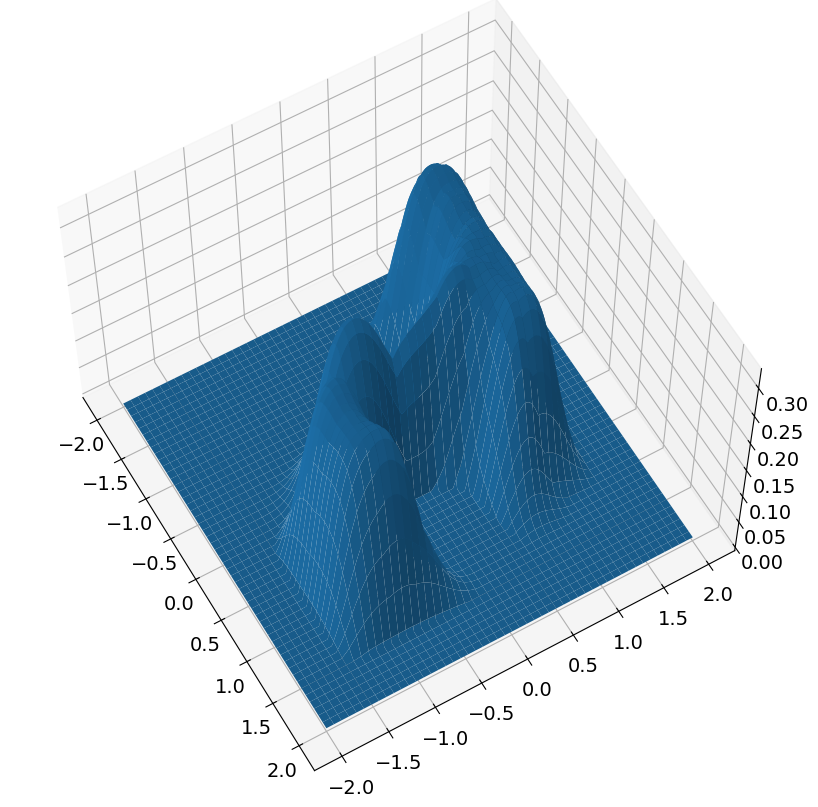

target: [-1.22908467 -1.55967824]
target in goto [-1.22908467 -1.55967824]
position is [ 1.19842721 -1.14599669]
h is 0.24224116857142589
start time is 400


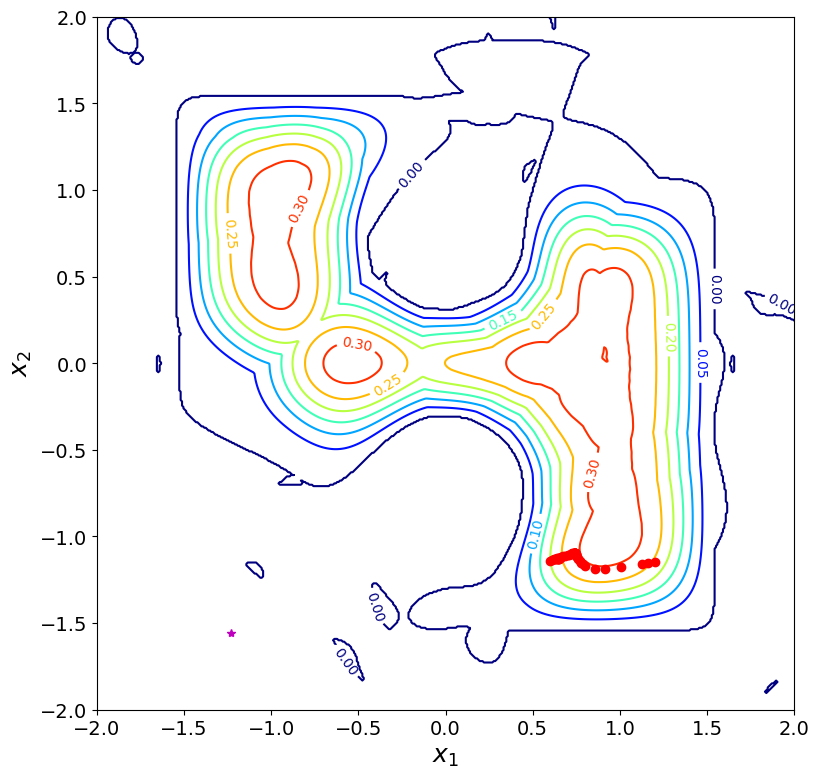

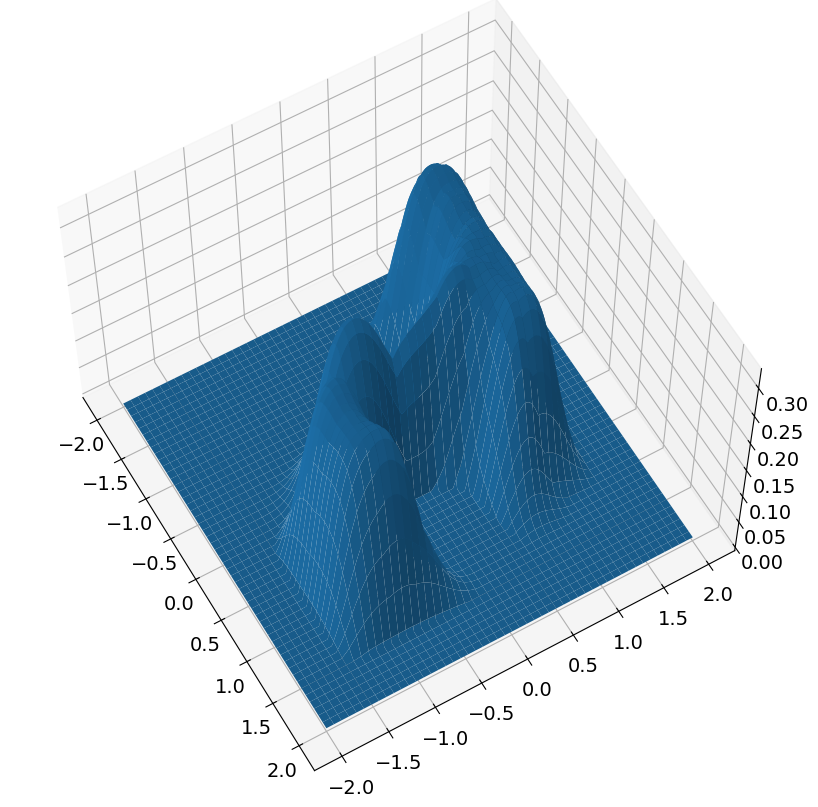

new position is [ 0.60157432 -1.13873176]
h is now 0.2
new time is 450
dx: 0.596897110924064


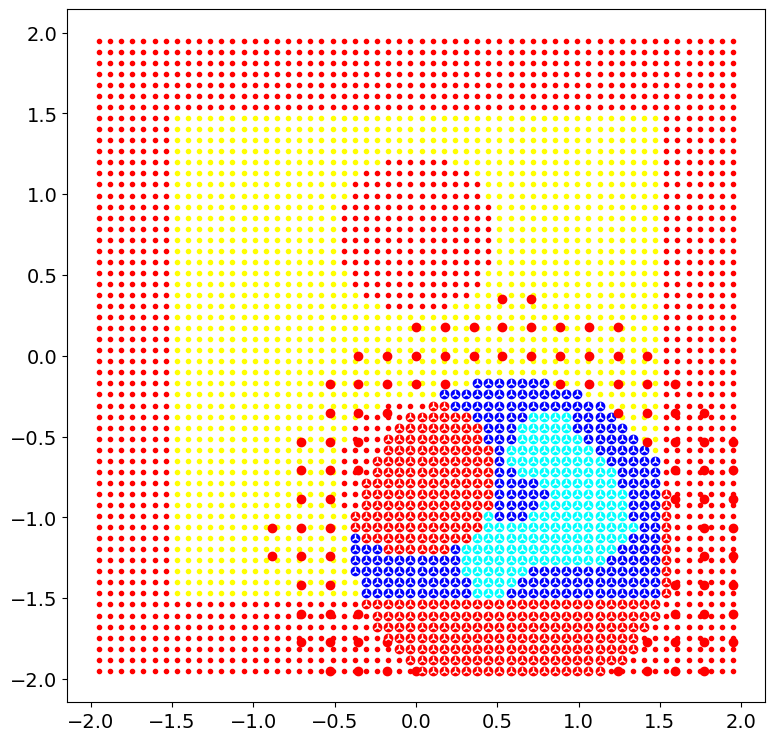

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          648     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42349D+06    |proj g|=  1.29929D+02


 This problem is unconstrained.



At iterate   50    f=  7.05918D+02    |proj g|=  1.77321D+00

At iterate  100    f=  7.05385D+02    |proj g|=  1.59953D+00

At iterate  150    f=  7.05285D+02    |proj g|=  2.18122D+00

At iterate  200    f=  7.05245D+02    |proj g|=  9.63981D-01

At iterate  250    f=  7.05237D+02    |proj g|=  1.18030D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  648    273    355      1     0     0   8.104D-01   7.052D+02
  F =   705.23339975766760     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(648, 2)
n

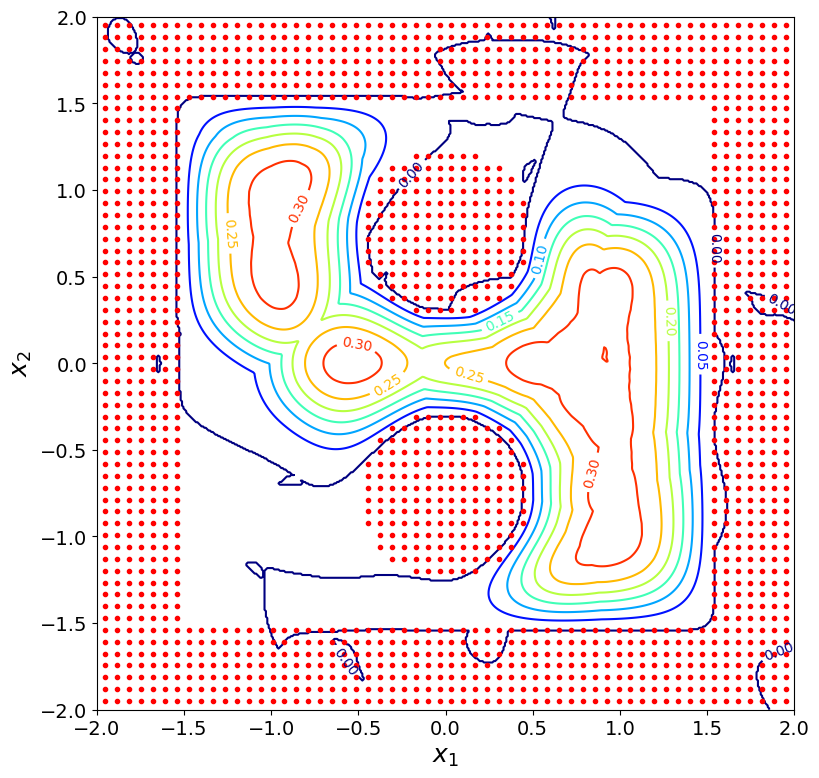

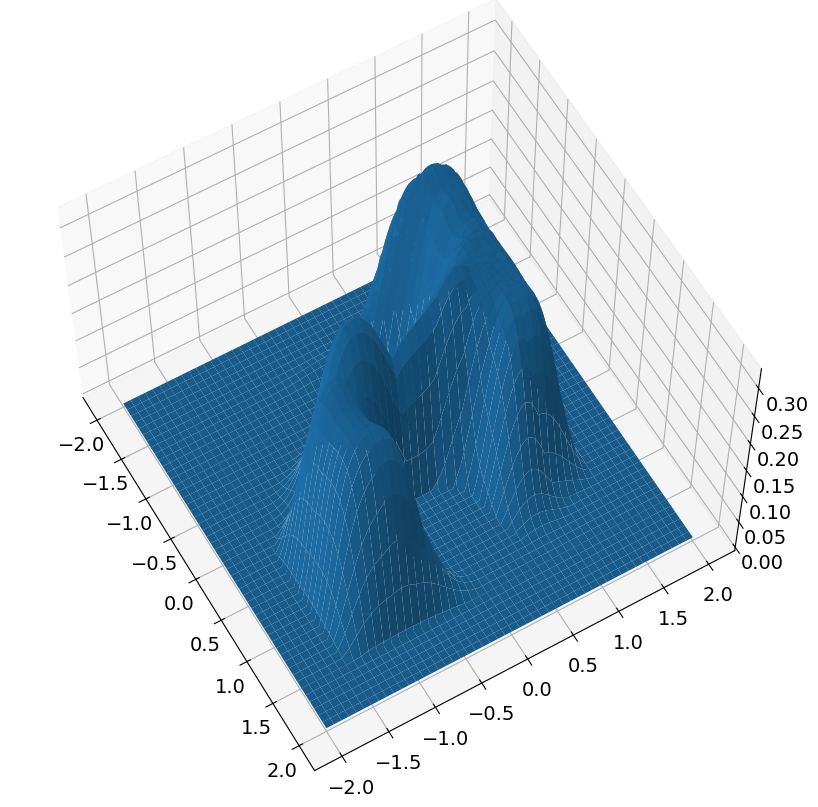

target: [ 0.2899006  -0.42089125]
target in goto [ 0.2899006  -0.42089125]
position is [ 0.60157432 -1.13873176]
h is 0.24764583325825068
start time is 450


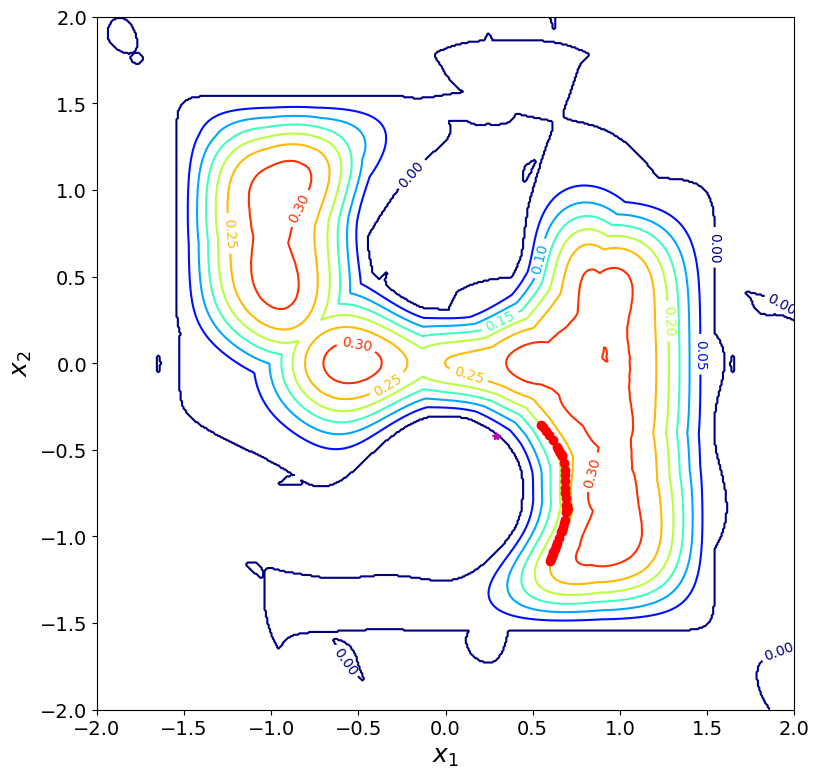

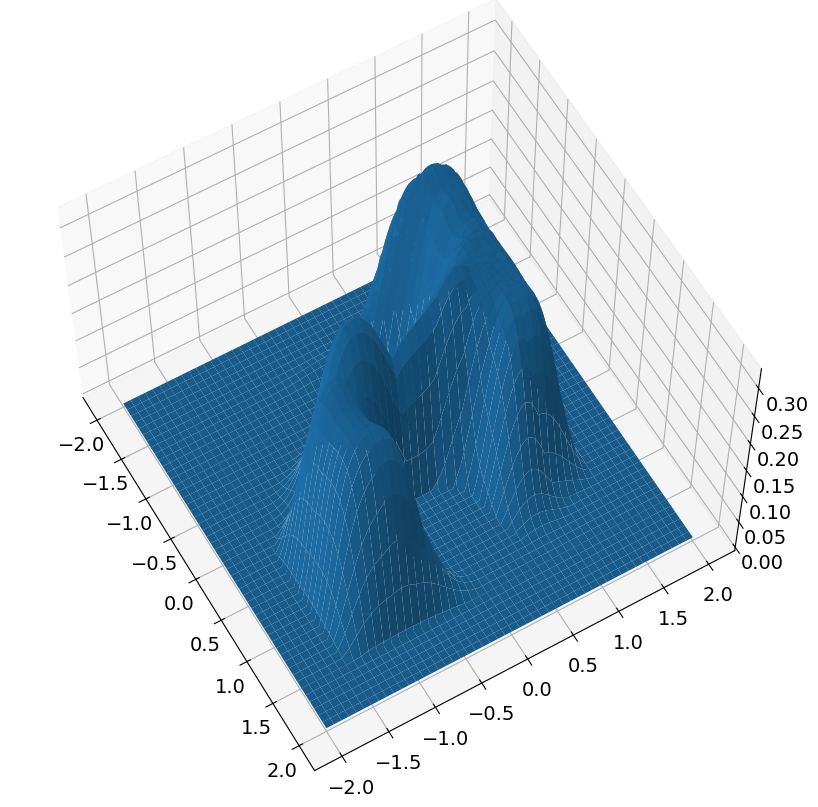

new position is [ 0.54625162 -0.35804467]
h is now 0.20000000000000007
new time is 500
dx: 0.782644832086874


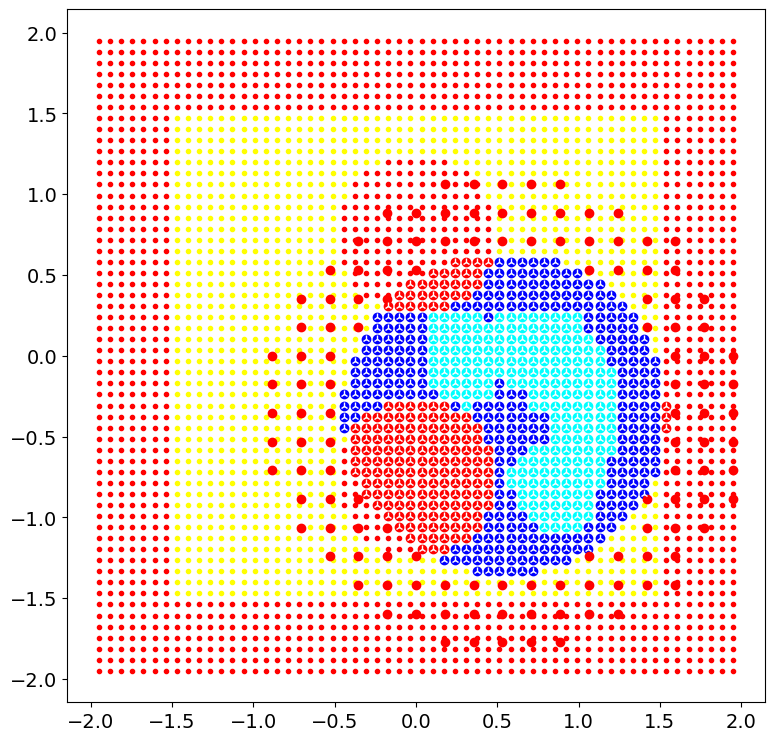

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          669     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.53903D+06    |proj g|=  1.27651D+02


 This problem is unconstrained.



At iterate   50    f=  8.27816D+02    |proj g|=  1.14856D+00

At iterate  100    f=  8.27738D+02    |proj g|=  8.87297D-01

At iterate  150    f=  8.27727D+02    |proj g|=  4.82375D-01

At iterate  200    f=  8.27718D+02    |proj g|=  9.57547D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  669    218    312      1     0     0   1.159D+00   8.277D+02
  F =   827.71730239278406     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(669, 2)
numc 669
cmax before 680
numc <= self.cmax
Cnew shape 

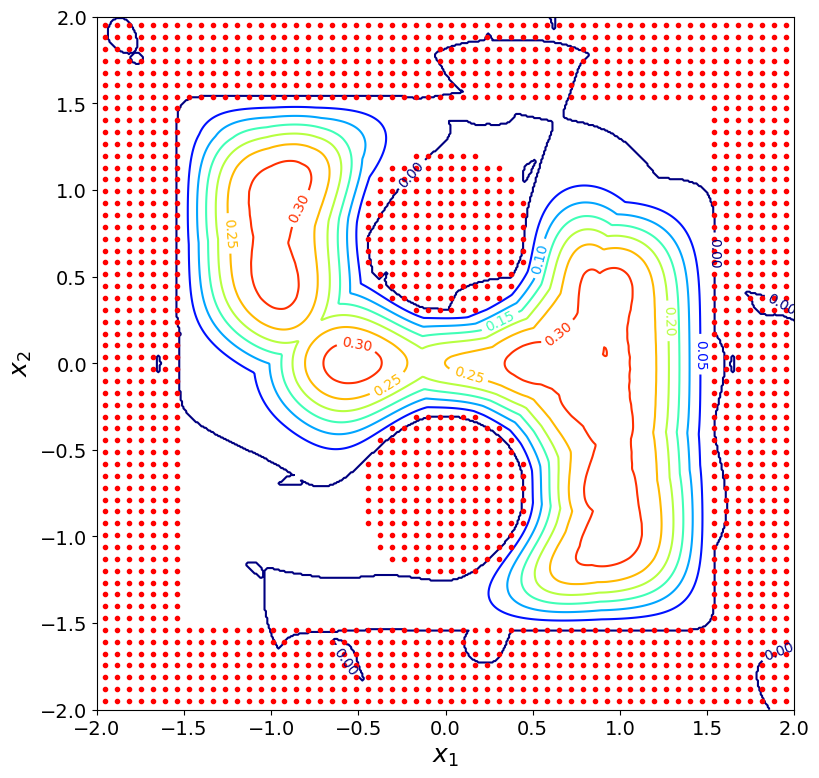

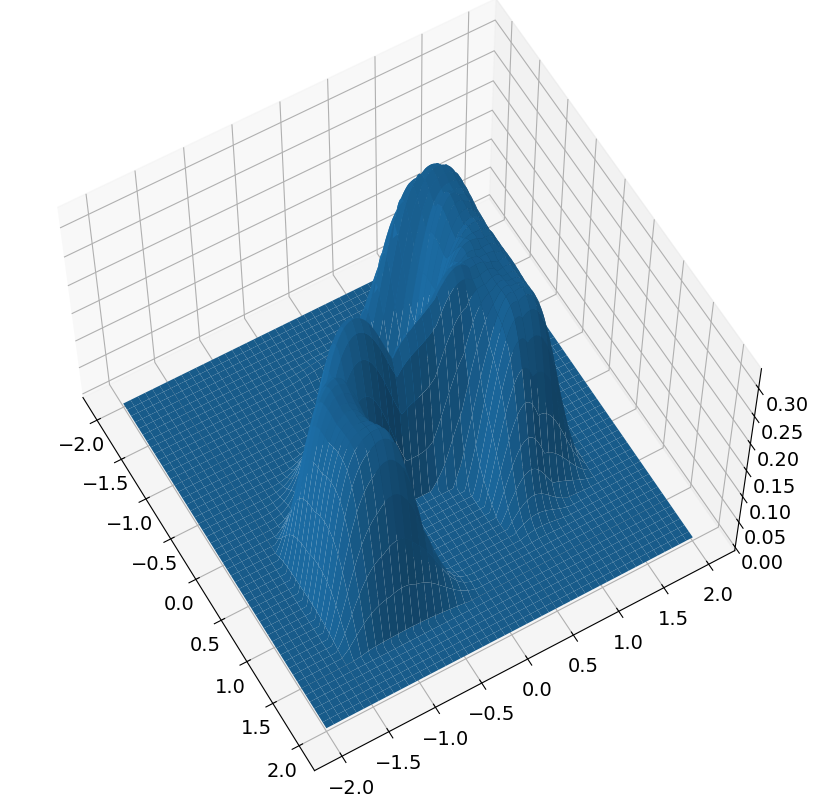

target: [-1.16904225 -0.80684154]
target in goto [-1.16904225 -0.80684154]
position is [ 0.54625162 -0.35804467]
h is 0.20000000000000007
start time is 500


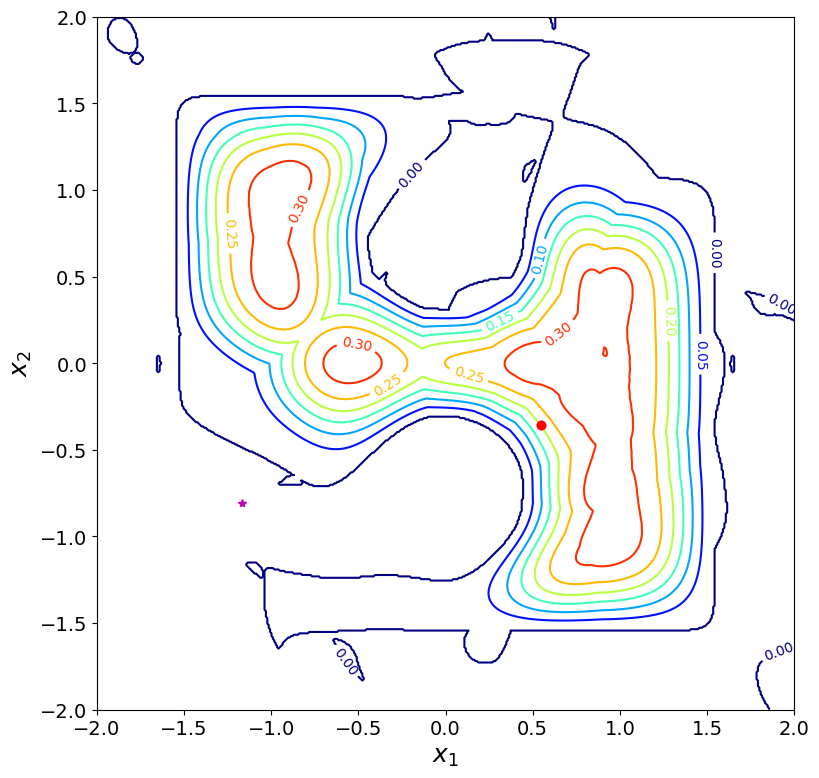

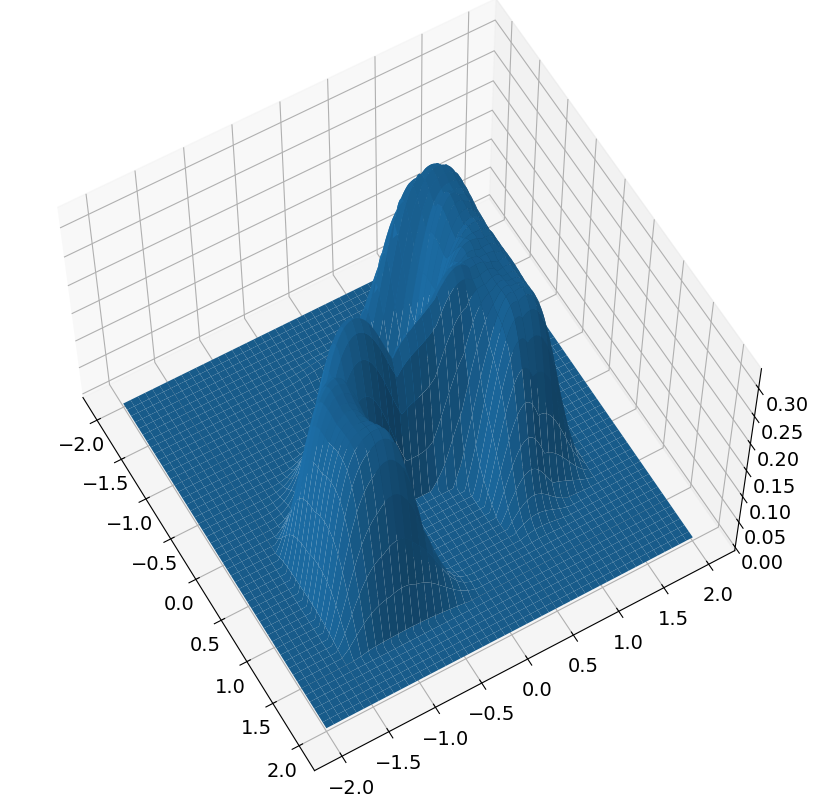

new position is [ 0.54625162 -0.35804467]
h is now 0.20000000000000007
new time is 550
dx: 5.551115123125783e-17
target: [-1.73397409  1.01137193]
target in goto [-1.73397409  1.01137193]
position is [ 0.54625162 -0.35804467]
h is 0.20000000000000007
start time is 550


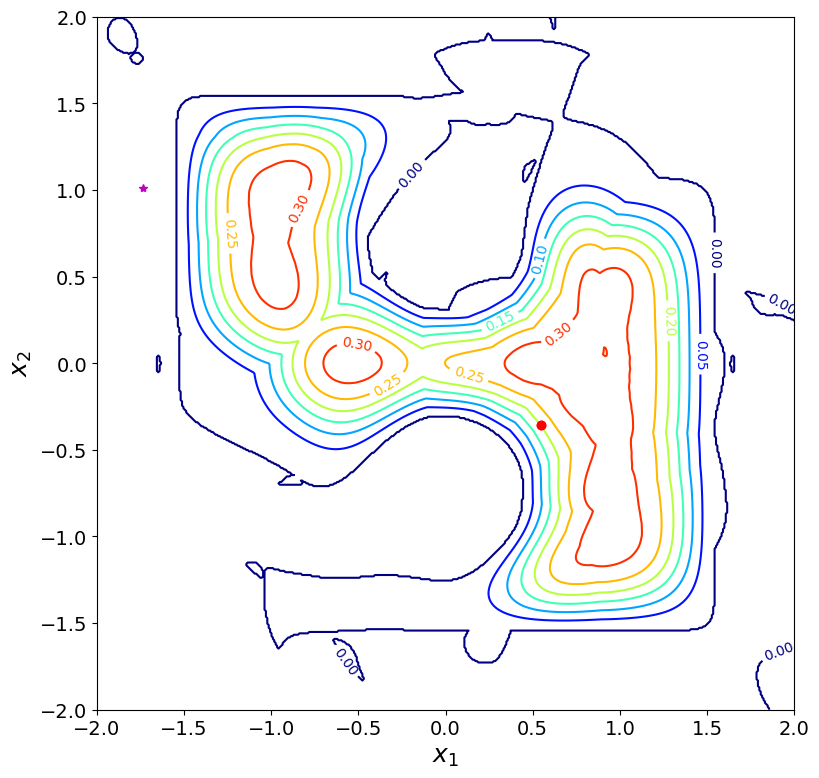

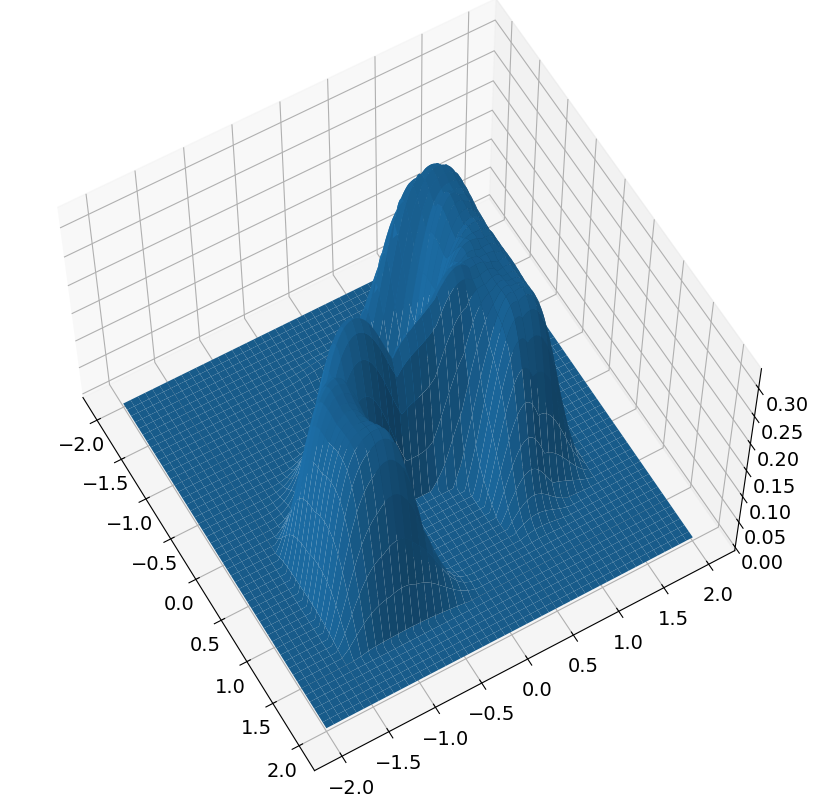

new position is [ 0.54625162 -0.35804467]
h is now 0.20000000000000012
new time is 600
dx: 1.2412670766236366e-16
target: [-1.6354454   0.93488331]
target in goto [-1.6354454   0.93488331]
position is [ 0.54625162 -0.35804467]
h is 0.20000000000000012
start time is 600


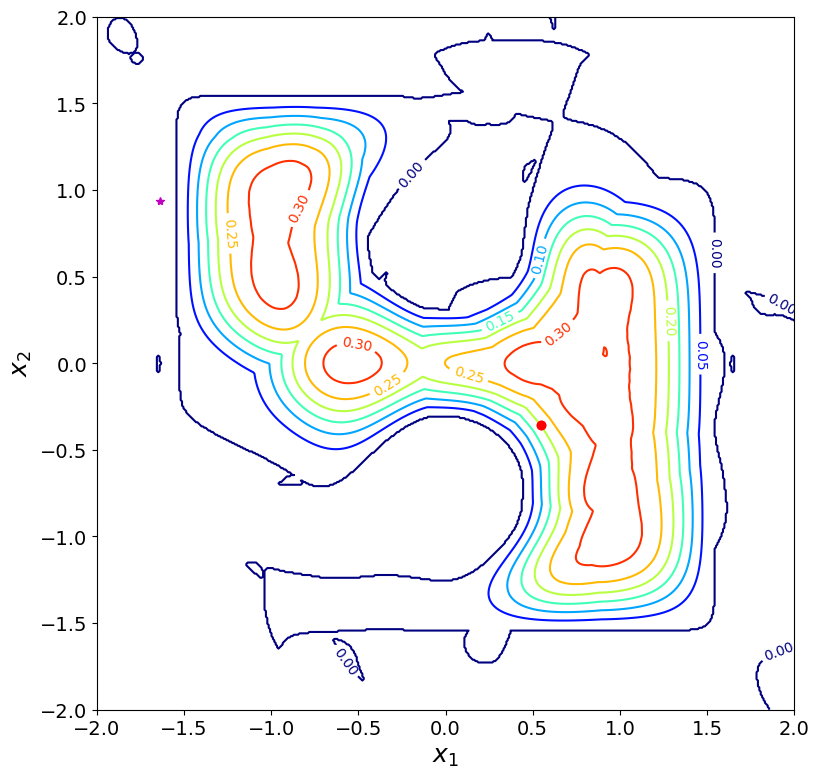

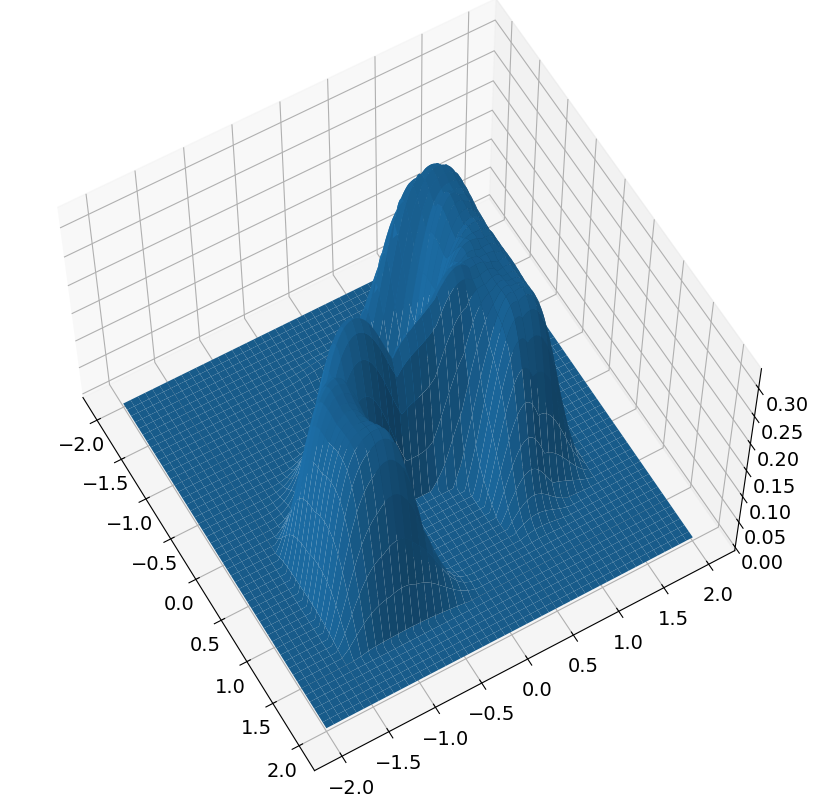

new position is [ 0.54625162 -0.35804467]
h is now 0.20000000000000012
new time is 650
dx: 1.1102230246251565e-16
target: [-0.73088808 -1.93225475]
target in goto [-0.73088808 -1.93225475]
position is [ 0.54625162 -0.35804467]
h is 0.20000000000000012
start time is 650


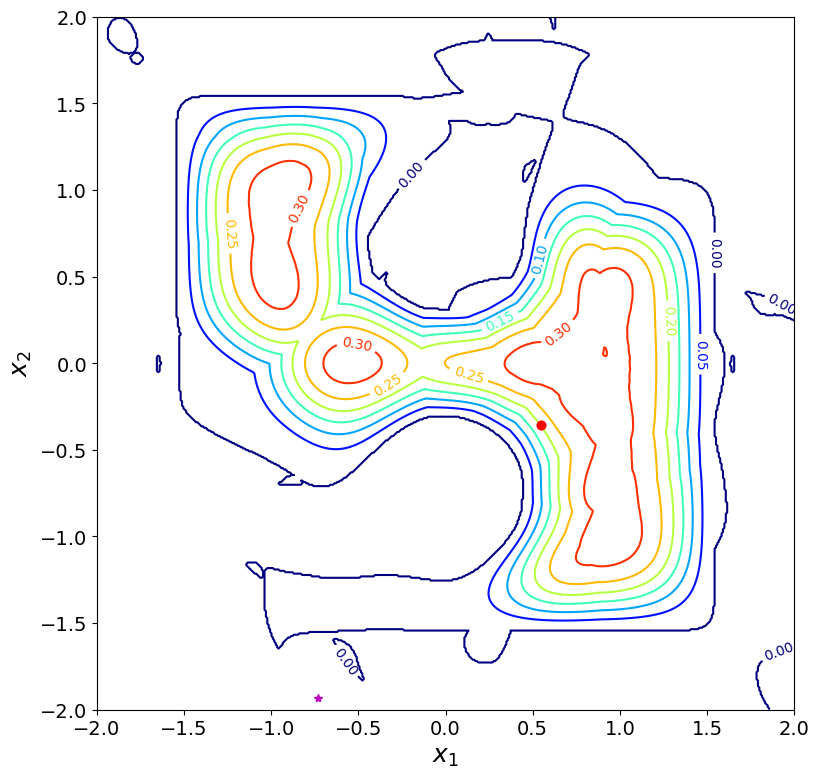

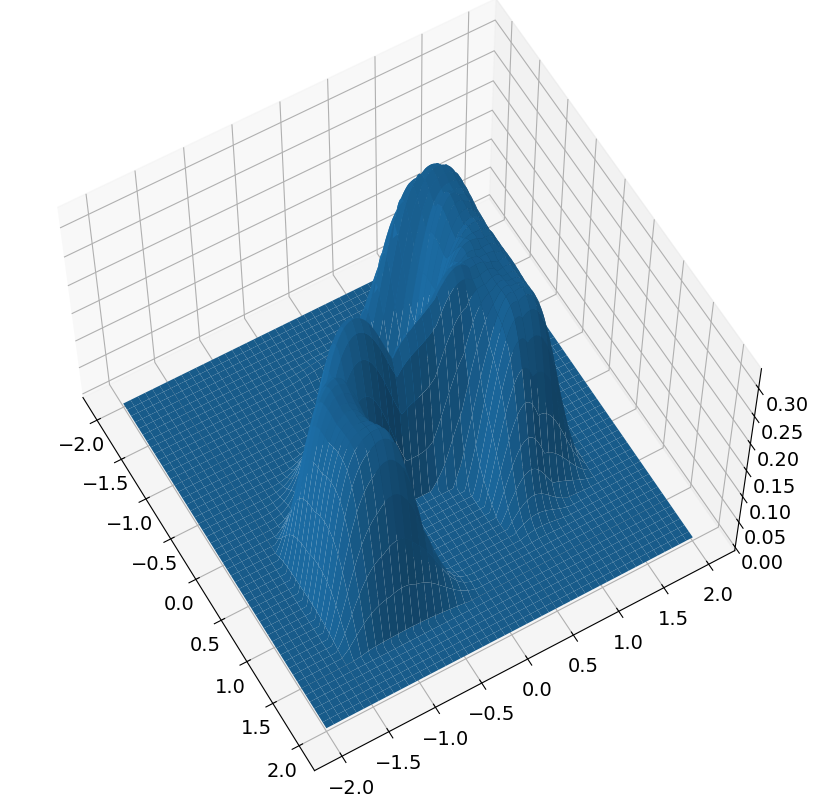

new position is [ 0.54625162 -0.35804467]
h is now 0.19999999999999998
new time is 700
dx: 6.9963873153611206e-15
target: [-1.86562326 -1.55881383]
target in goto [-1.86562326 -1.55881383]
position is [ 0.54625162 -0.35804467]
h is 0.19999999999999998
start time is 700


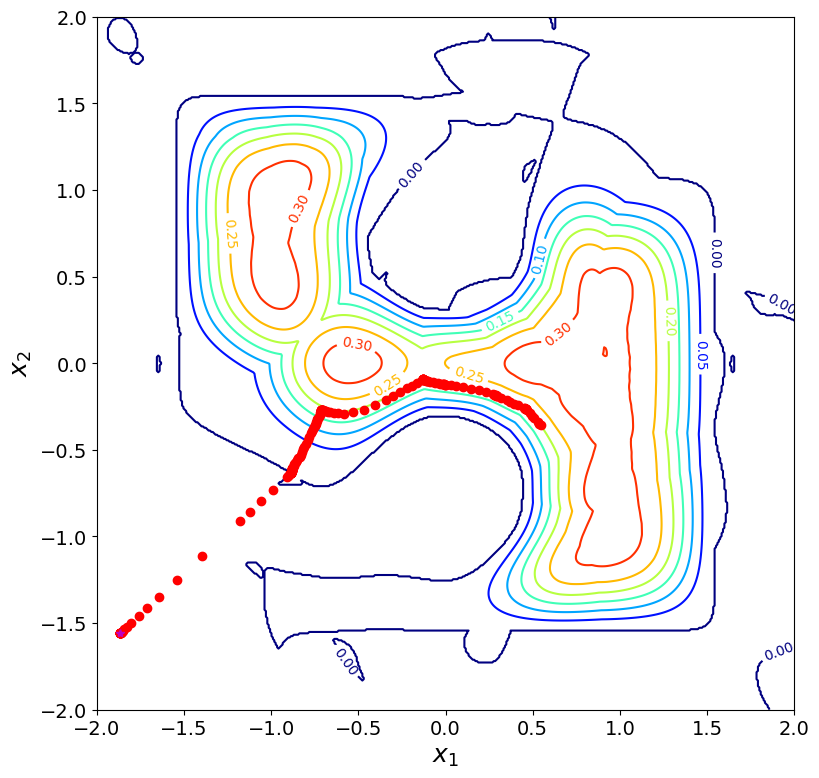

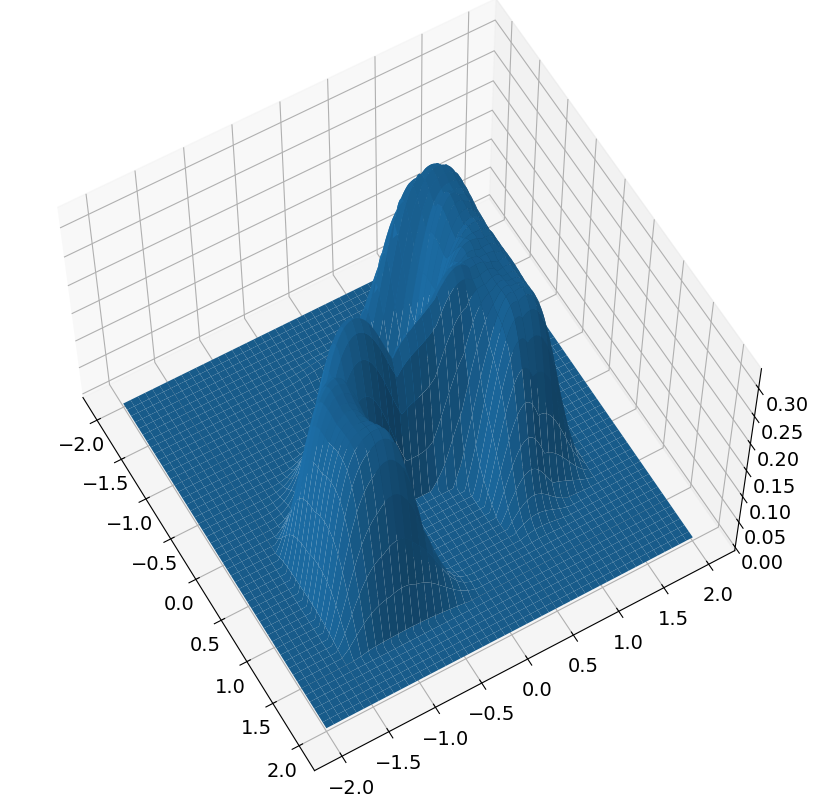

new position is [-1.86561232 -1.55881376]
h is now 0.0
new time is 750
dx: 2.694240904970575


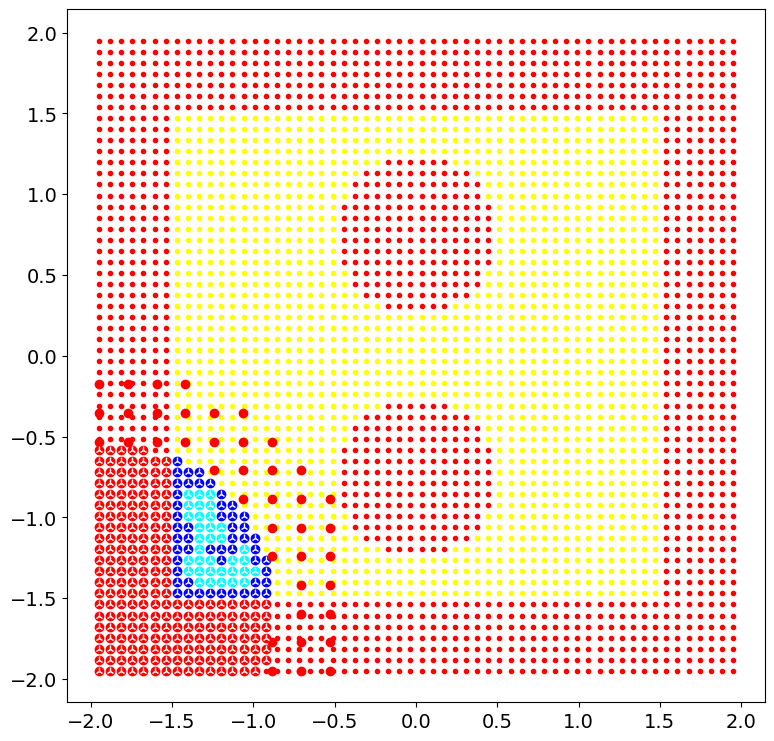

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          292     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  6.04493D+05    |proj g|=  1.12786D+02


 This problem is unconstrained.



At iterate   50    f=  2.59758D+02    |proj g|=  1.21260D+00

At iterate  100    f=  2.59621D+02    |proj g|=  9.22740D-01

At iterate  150    f=  2.59596D+02    |proj g|=  1.08083D+00

At iterate  200    f=  2.59591D+02    |proj g|=  9.25258D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  292    204    307      1     0     0   4.610D-01   2.596D+02
  F =   259.59109461734681     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(292, 2)
numc 292
cmax before 680
numc <= self.cmax
Cn

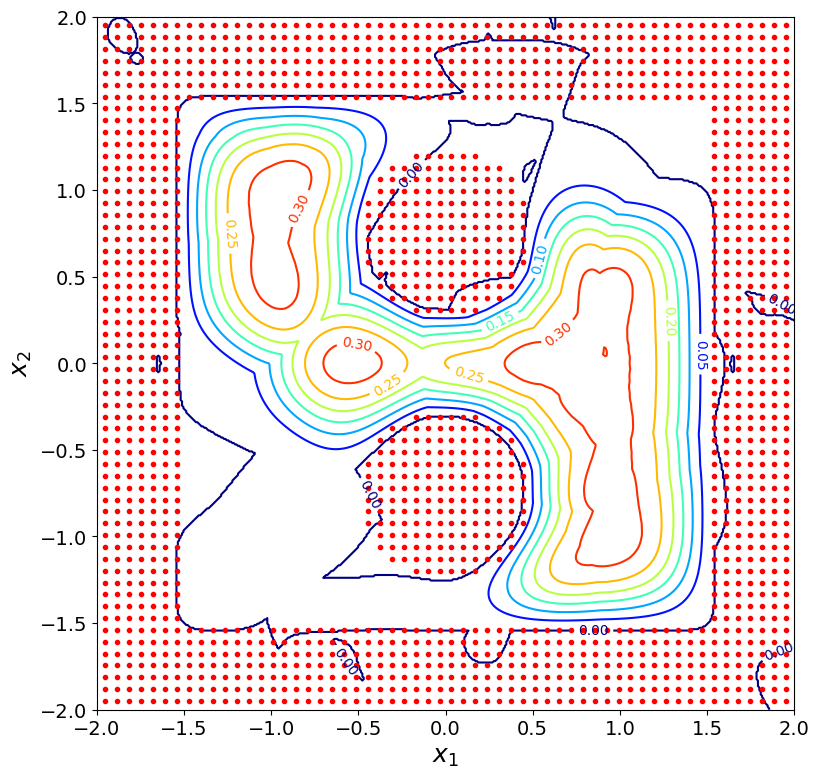

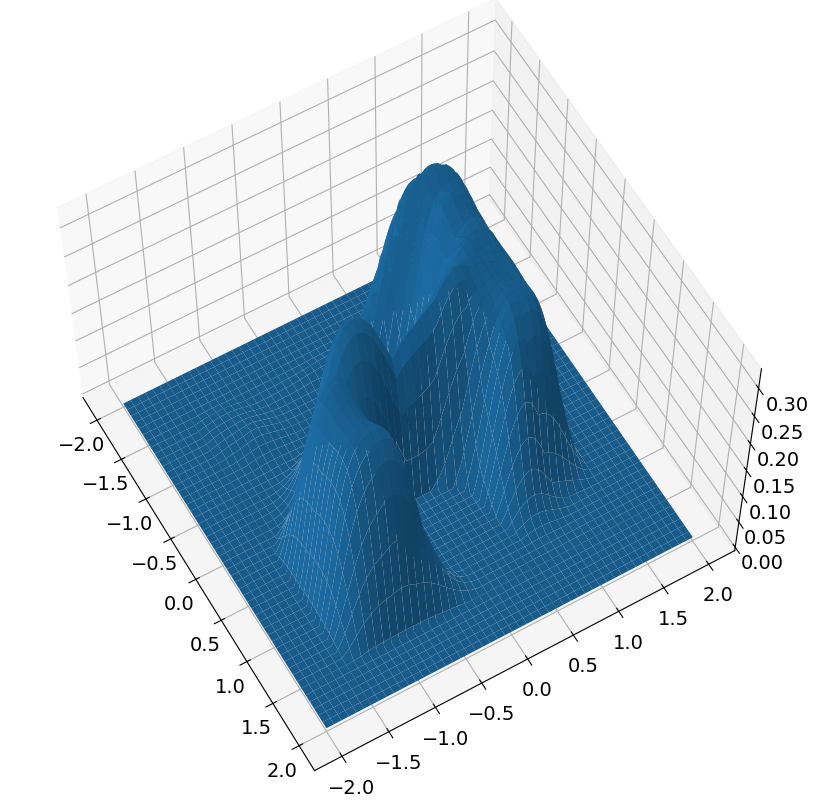

target: [0.61600355 1.92841725]
target in goto [0.61600355 1.92841725]
position is [-1.86561232 -1.55881376]
h is 0.0
start time is 750


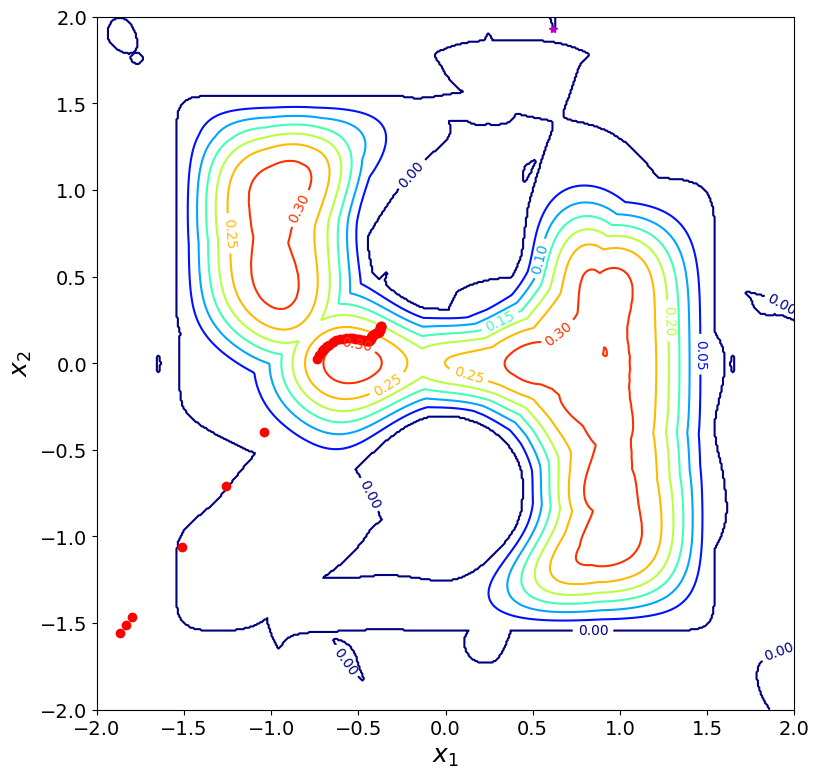

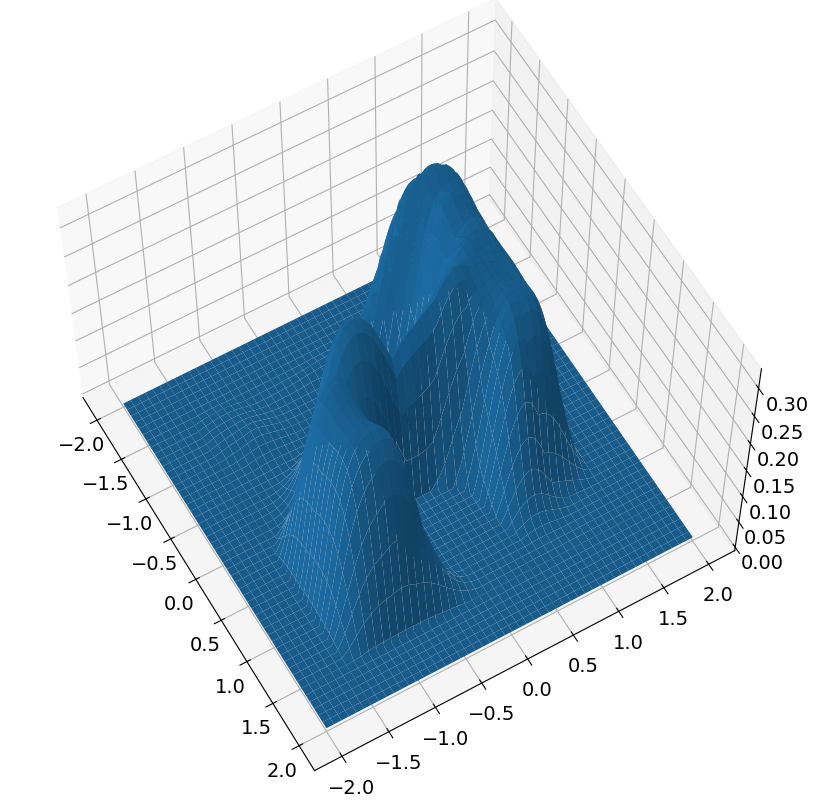

new position is [-0.37005799  0.2161865 ]
h is now 0.20000000000000007
new time is 800
dx: 2.321057665102787


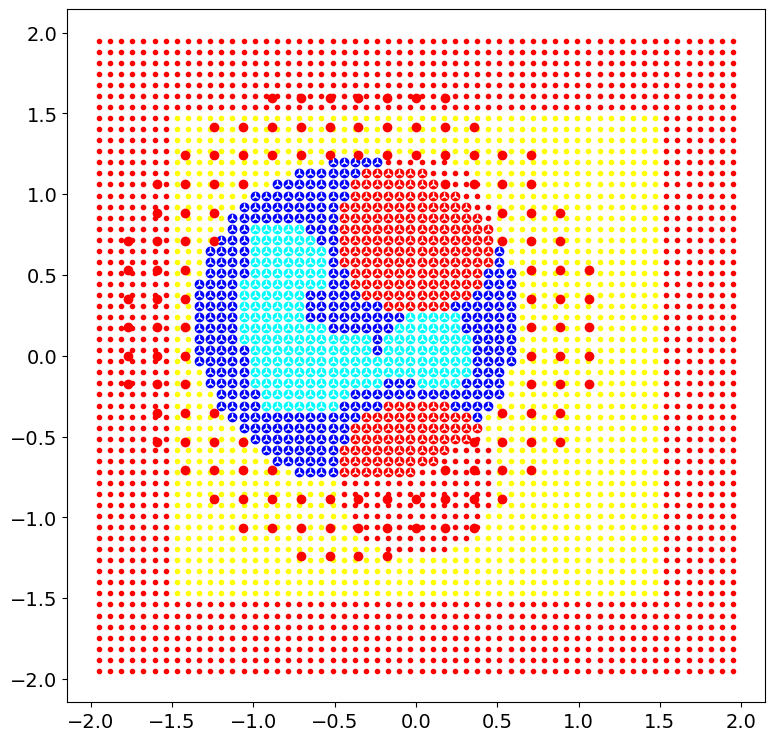

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          671     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.52698D+06    |proj g|=  1.26097D+02


 This problem is unconstrained.



At iterate   50    f=  8.60688D+02    |proj g|=  9.54780D-01

At iterate  100    f=  8.60651D+02    |proj g|=  3.85122D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  671    107    163      1     0     0   1.056D+00   8.606D+02
  F =   860.64963396738608     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(671, 2)
numc 671
cmax before 680
numc <= self.cmax
Cnew shape before (671, 2)
Cnew shape after (671, 2)
theta shape before (671,)
theta_shape after (680,)
cmax after 68

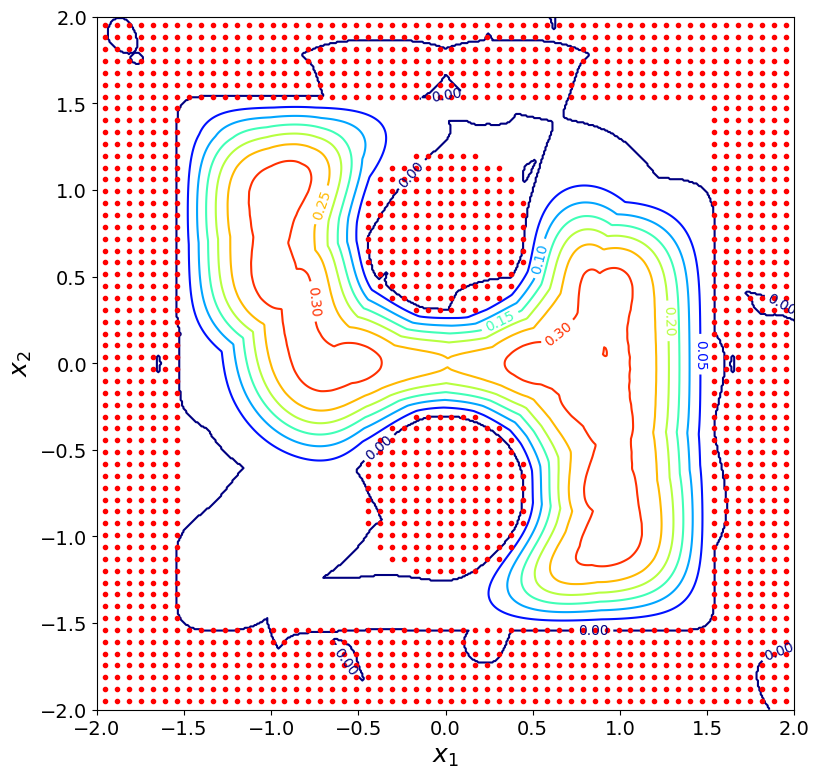

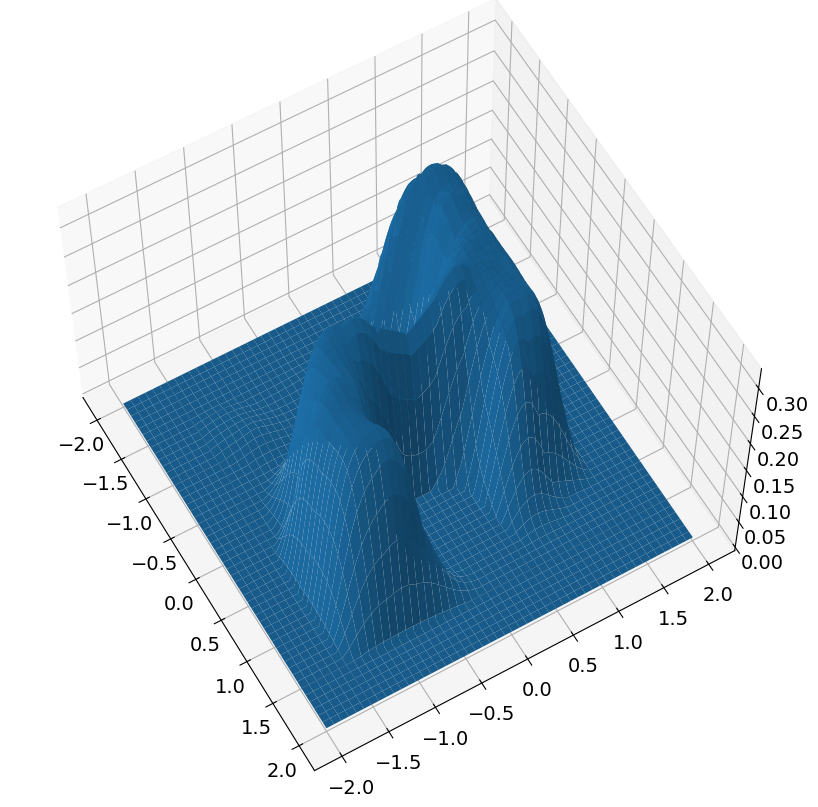

target: [0.00494705 0.90441212]
target in goto [0.00494705 0.90441212]
position is [-0.37005799  0.2161865 ]
h is 0.20000000000000007
start time is 800


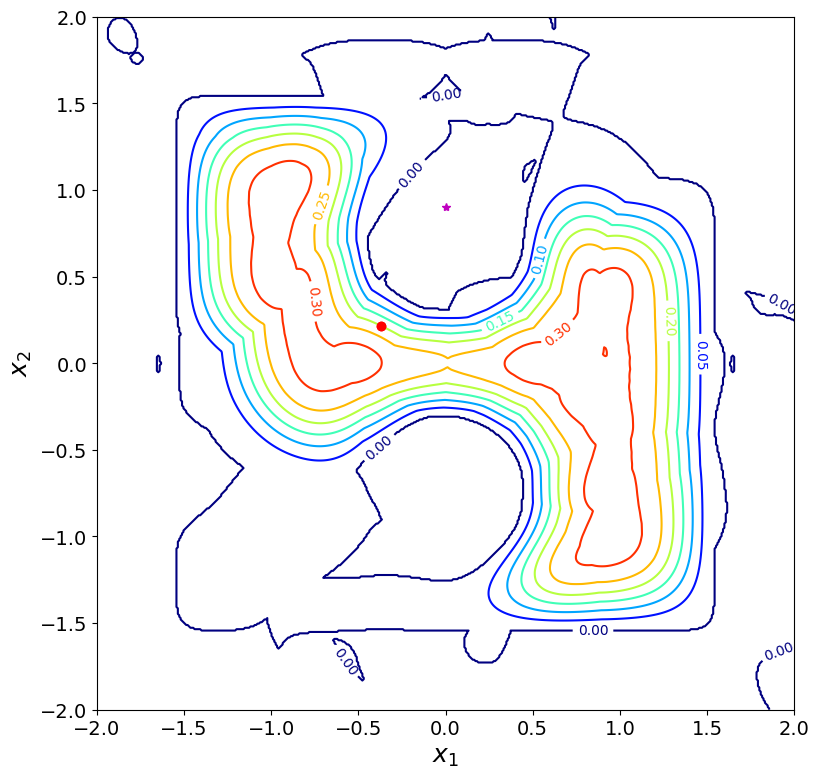

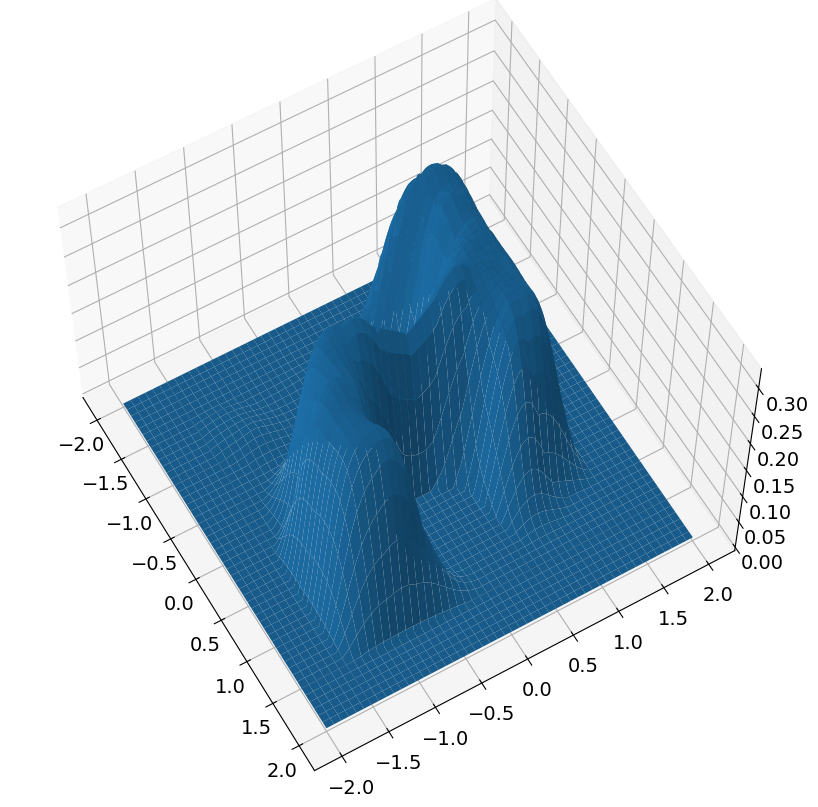

new position is [-0.37005799  0.2161865 ]
h is now 0.19999999999999996
new time is 850
dx: 2.0014830212433605e-16
target: [-1.71578146  1.30843035]
target in goto [-1.71578146  1.30843035]
position is [-0.37005799  0.2161865 ]
h is 0.19999999999999996
start time is 850


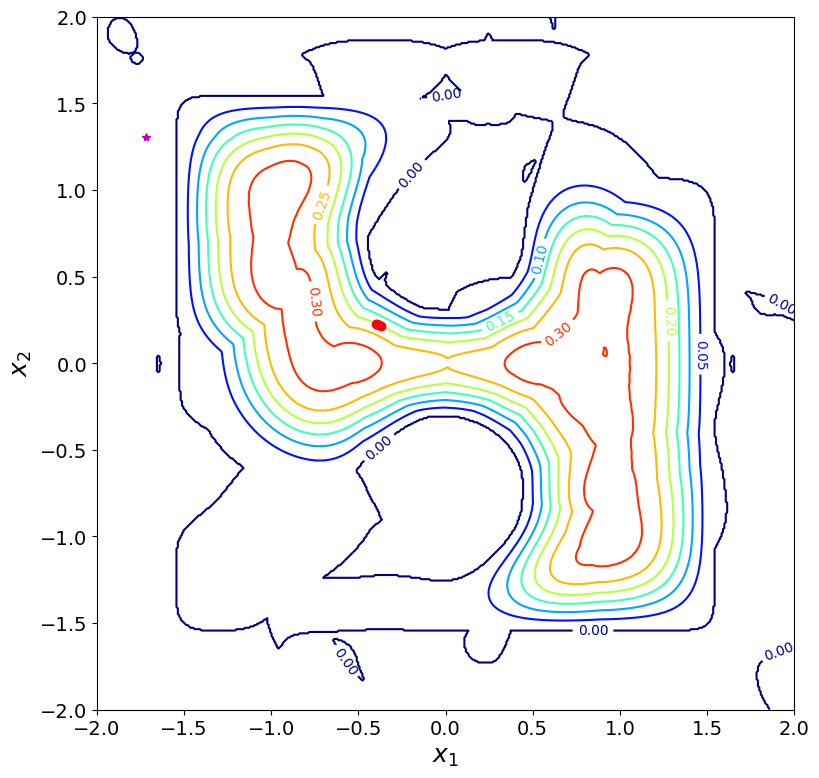

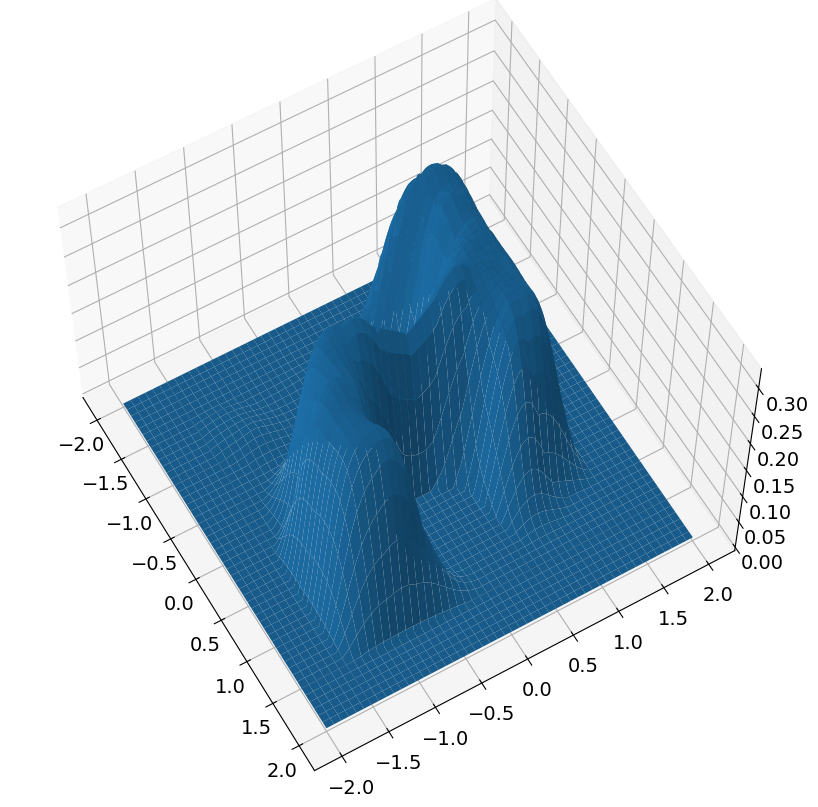

new position is [-0.396533    0.22863624]
h is now 0.2
new time is 900
dx: 0.02925615085149927
target: [-1.07426898 -1.76539956]
target in goto [-1.07426898 -1.76539956]
position is [-0.396533    0.22863624]
h is 0.2
start time is 900


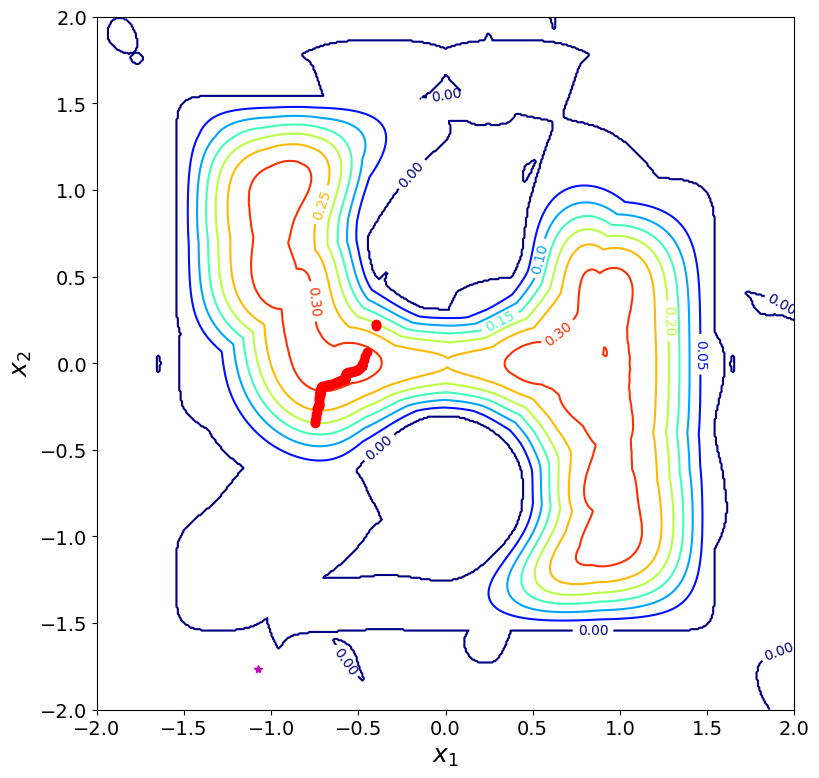

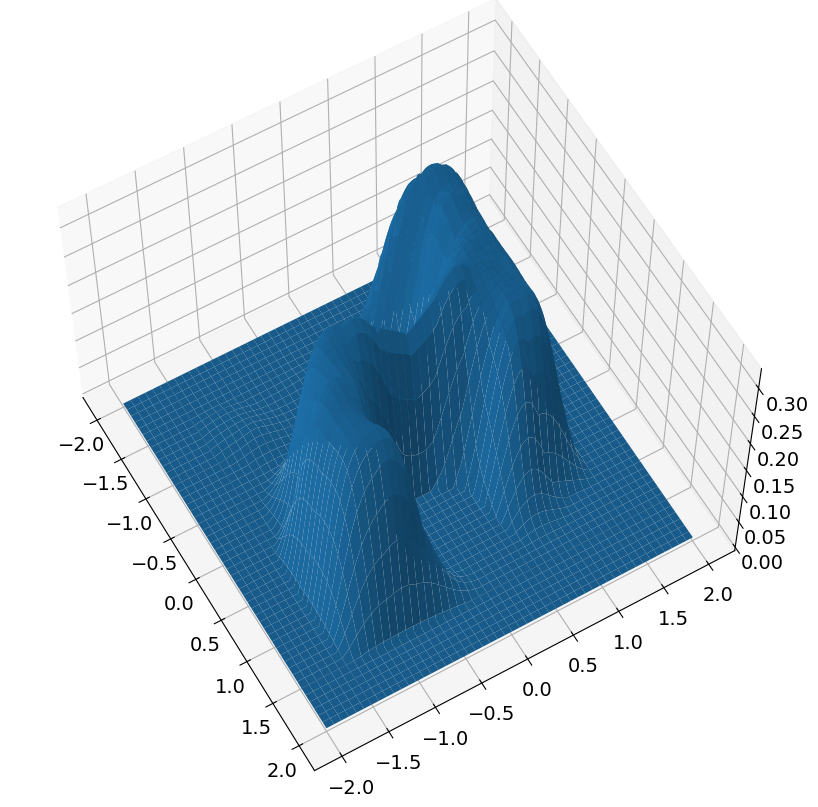

new position is [-0.75060213 -0.34438306]
h is now 0.19999999999999996
new time is 950
dx: 0.6775338189682037


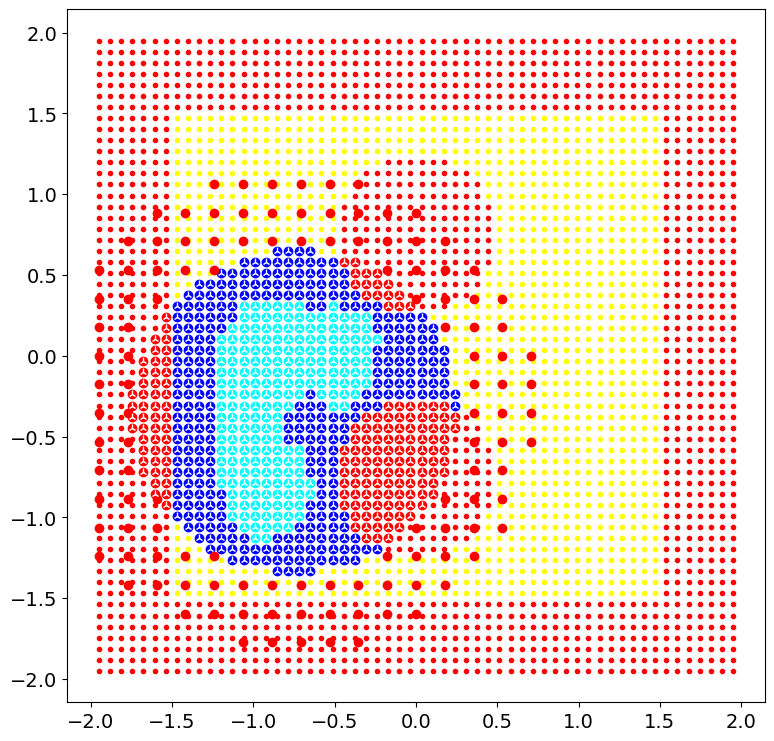

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          676     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.54522D+06    |proj g|=  1.27845D+02


 This problem is unconstrained.



At iterate   50    f=  7.55872D+02    |proj g|=  8.66667D-01

At iterate  100    f=  7.55555D+02    |proj g|=  1.14798D+00

At iterate  150    f=  7.55505D+02    |proj g|=  1.52209D+00

At iterate  200    f=  7.55482D+02    |proj g|=  1.09374D+00

At iterate  250    f=  7.55464D+02    |proj g|=  5.60446D-01

At iterate  300    f=  7.55454D+02    |proj g|=  9.05457D-01

centers shape before:
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(676, 2)
numc 676
cmax before 680
numc <= self.cmax
Cnew shape before (676, 2)
Cnew shape after (676, 2)
theta shape before (676,)
theta_shape after (680,)
cmax after 680
centers shape after
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = 


   evaluations in the last line search.  Termination
   may possibly be caused by a bad search direction.


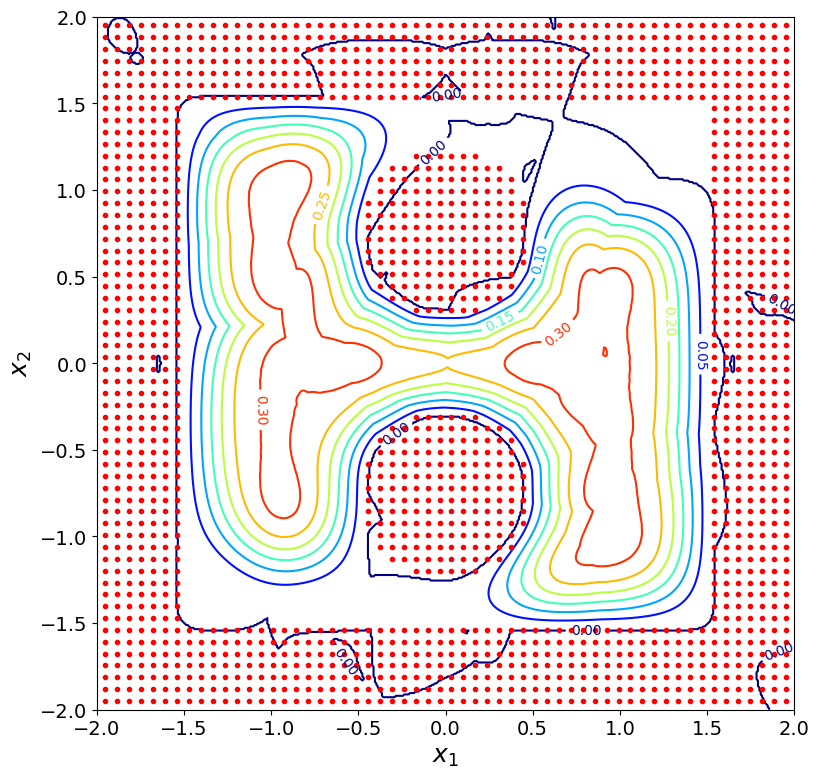

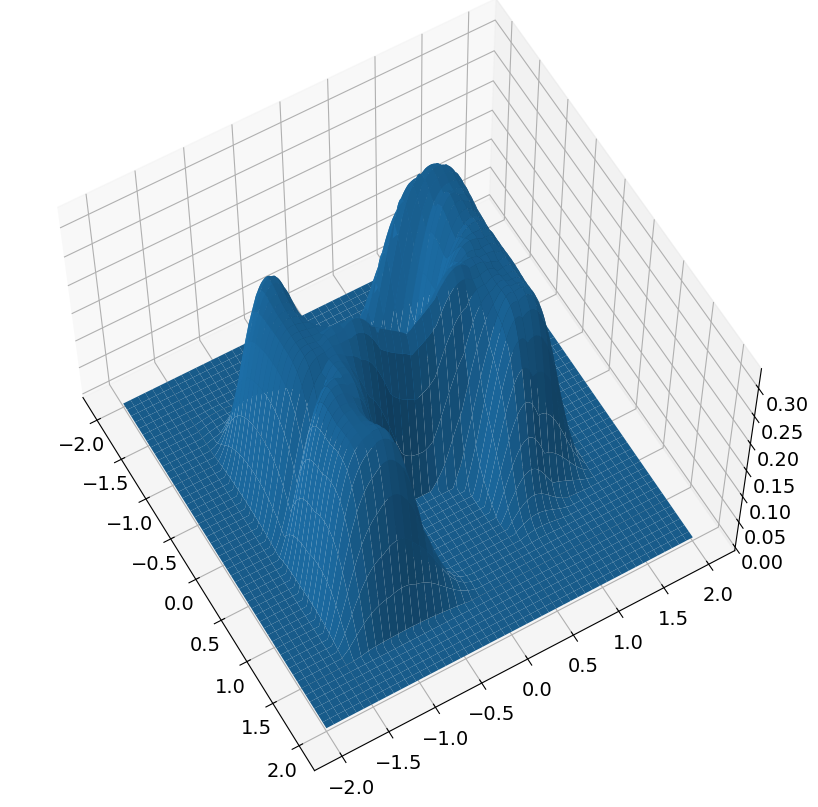

target: [1.88195101 1.33983337]
target in goto [1.88195101 1.33983337]
position is [-0.75060213 -0.34438306]
h is 0.2826528222900213
start time is 950


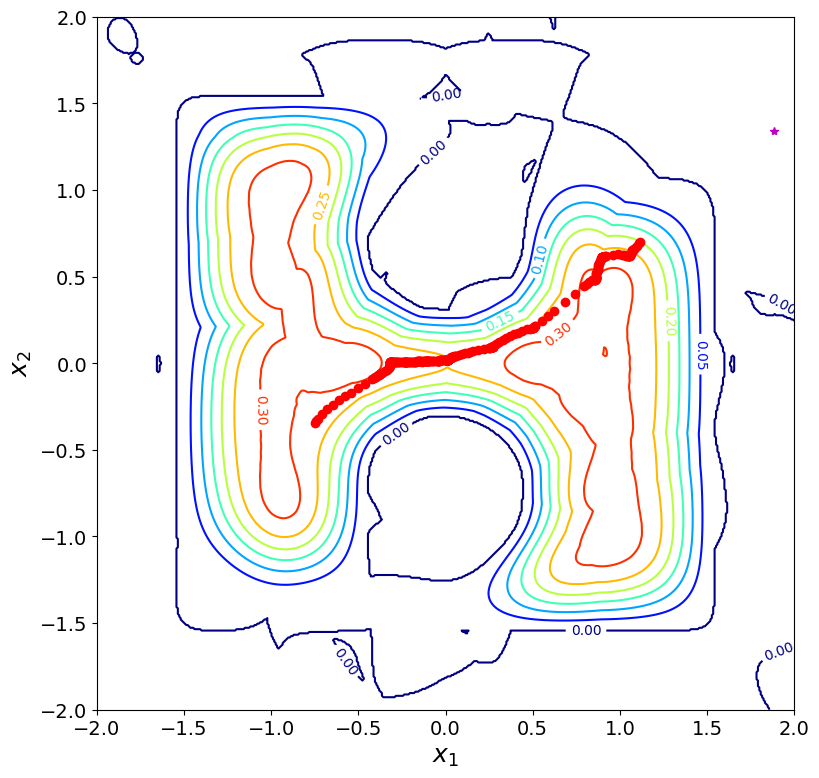

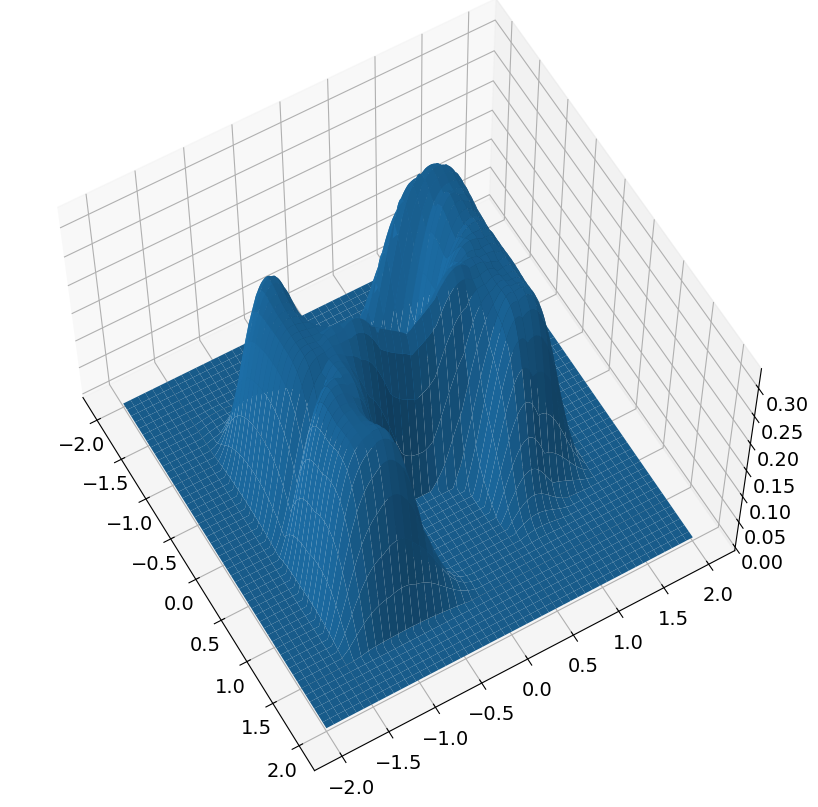

new position is [1.11613465 0.70184503]
h is now 0.20000000000000004
new time is 1000
dx: 2.13992976903829


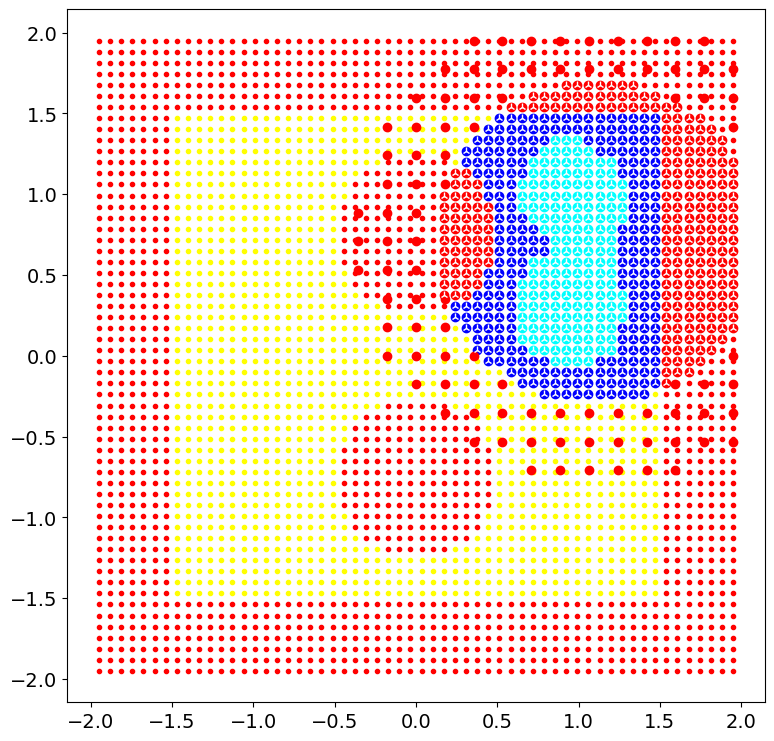

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          652     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.44176D+06    |proj g|=  1.30636D+02


 This problem is unconstrained.



At iterate   50    f=  6.36702D+02    |proj g|=  6.23347D-01

At iterate  100    f=  6.36051D+02    |proj g|=  2.13728D+00

At iterate  150    f=  6.35895D+02    |proj g|=  9.65672D-01

At iterate  200    f=  6.35839D+02    |proj g|=  1.41437D+00

At iterate  250    f=  6.35811D+02    |proj g|=  1.97980D+00

At iterate  300    f=  6.35792D+02    |proj g|=  1.96331D+00

At iterate  350    f=  6.35782D+02    |proj g|=  1.44770D+00

At iterate  400    f=  6.35776D+02    |proj g|=  2.10311D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  652    418    622      1     0     0   1.133D+00   6.358D+02
  F =   635.772714365

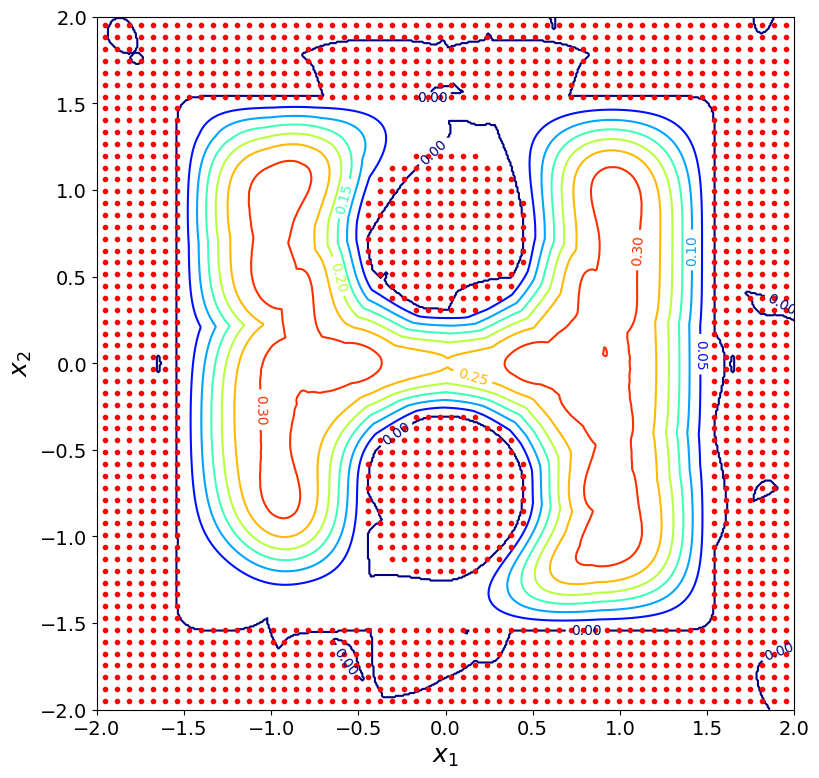

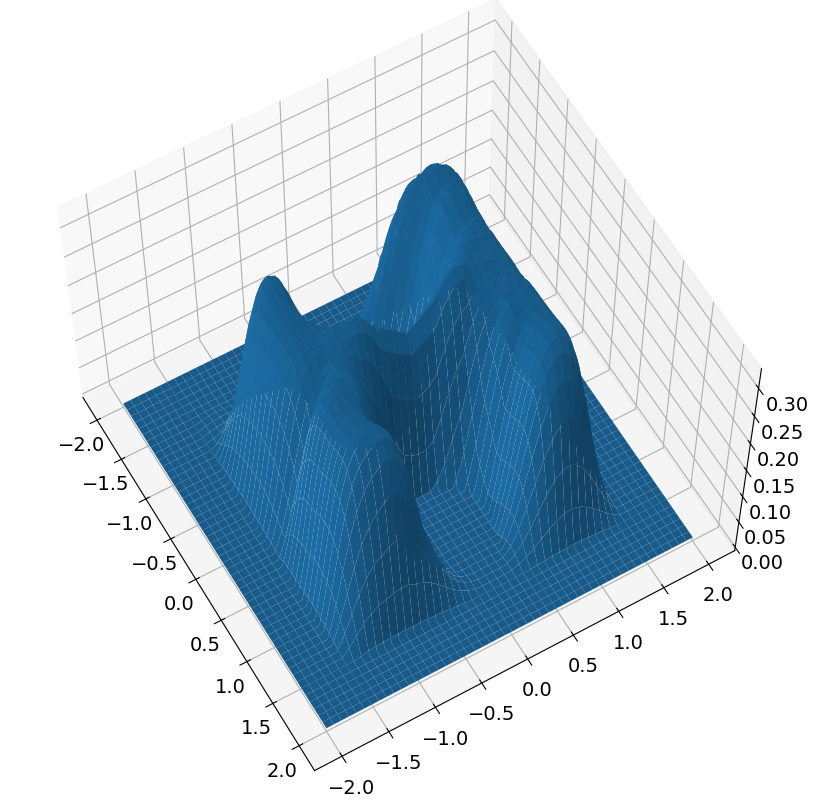

target: [-1.5490326   1.30818533]
target in goto [-1.5490326   1.30818533]
position is [1.11613465 0.70184503]
h is 0.2983013232176974
start time is 1000


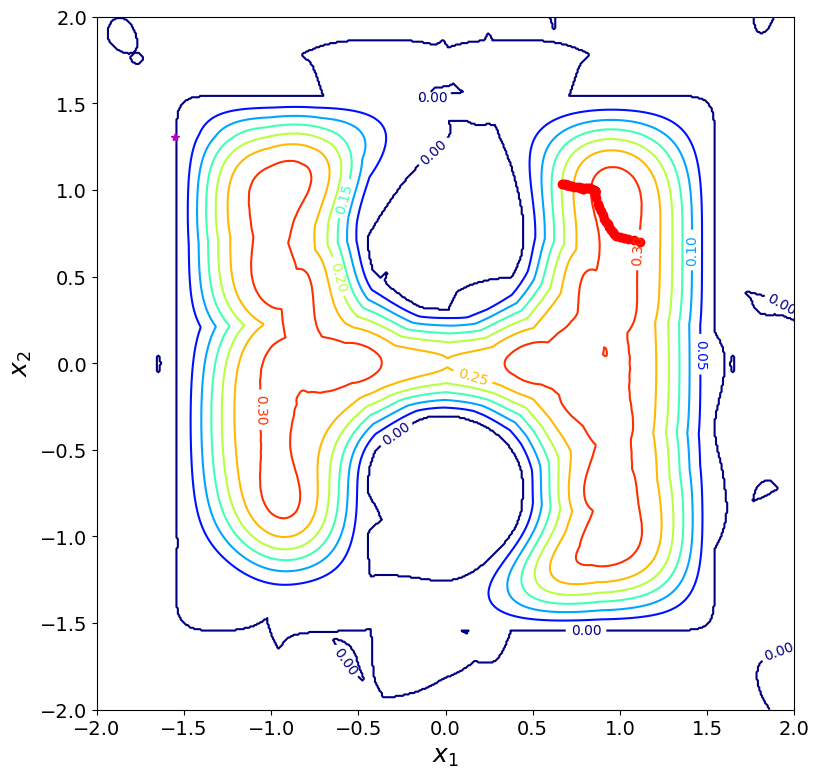

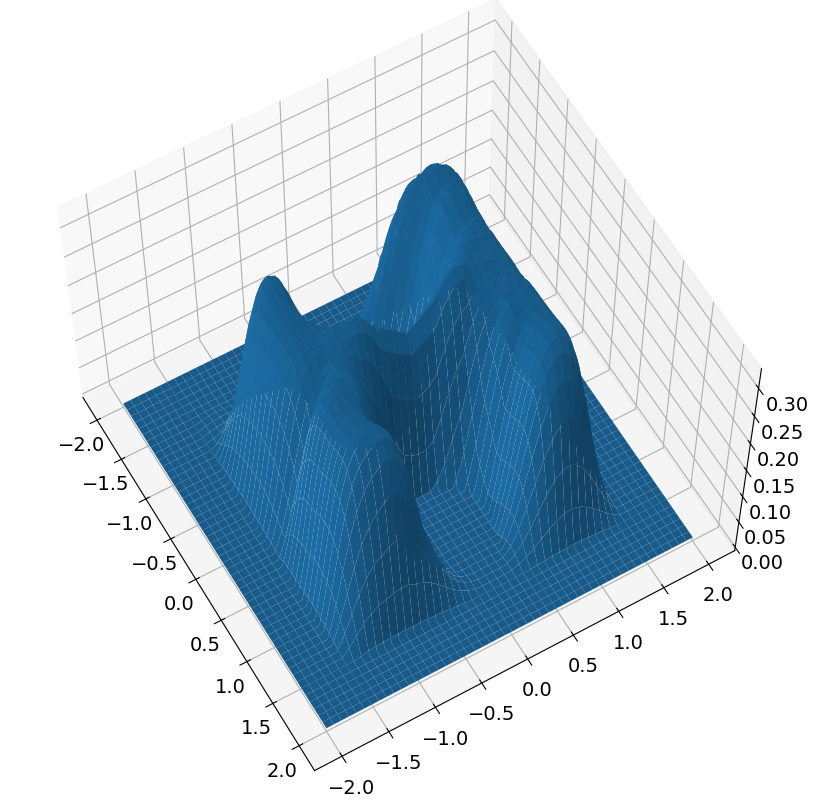

new position is [0.66716552 1.03725535]
h is now 0.2
new time is 1050
dx: 0.5604224862171452


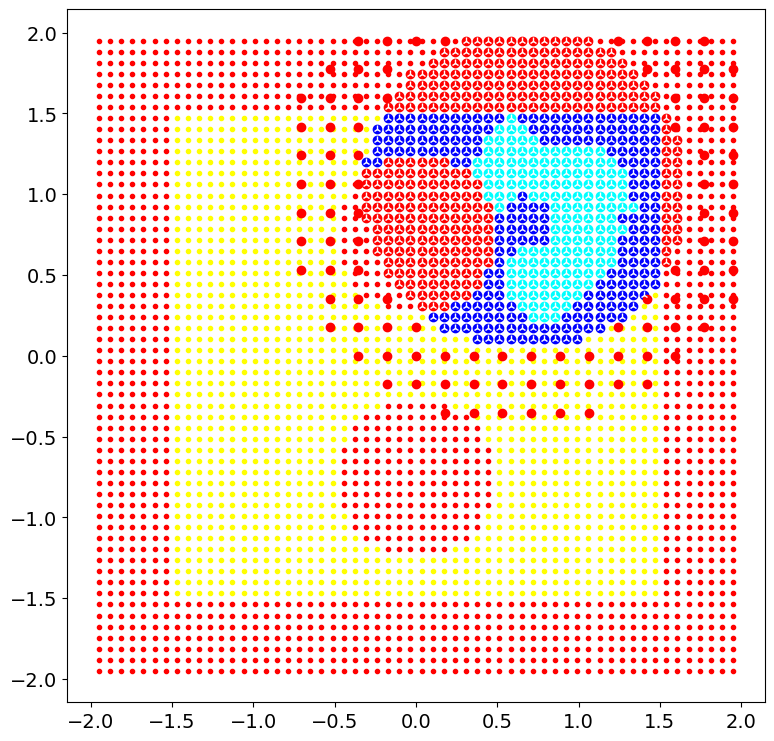

 This problem is unconstrained.


RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          664     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.46031D+06    |proj g|=  1.29163D+02

At iterate   50    f=  7.11456D+02    |proj g|=  1.08199D+00

At iterate  100    f=  7.10909D+02    |proj g|=  1.83575D+00

At iterate  150    f=  7.10844D+02    |proj g|=  1.51780D+00

At iterate  200    f=  7.10830D+02    |proj g|=  9.53518D-01

At iterate  250    f=  7.10812D+02    |proj g|=  1.32073D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  664    273    366      1     0     0   

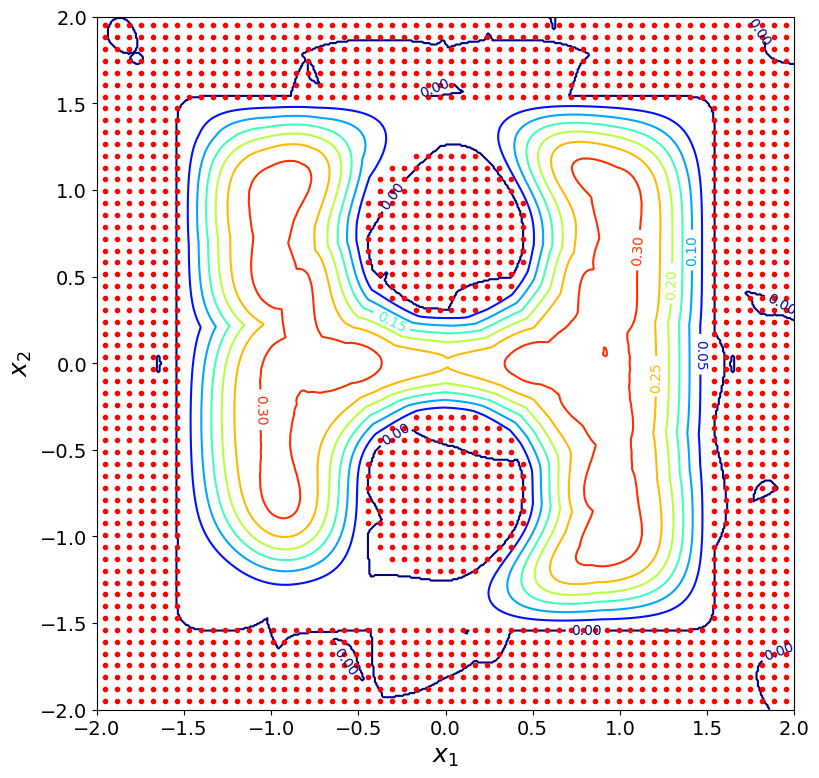

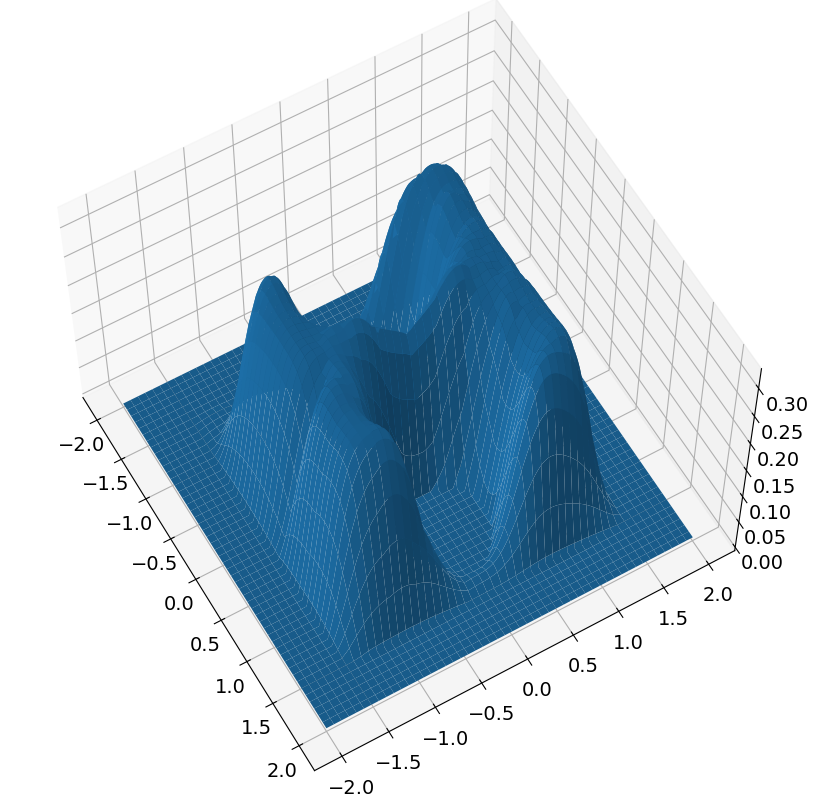

target: [-1.92524396 -1.07005604]
target in goto [-1.92524396 -1.07005604]
position is [0.66716552 1.03725535]
h is 0.26209677353580507
start time is 1050


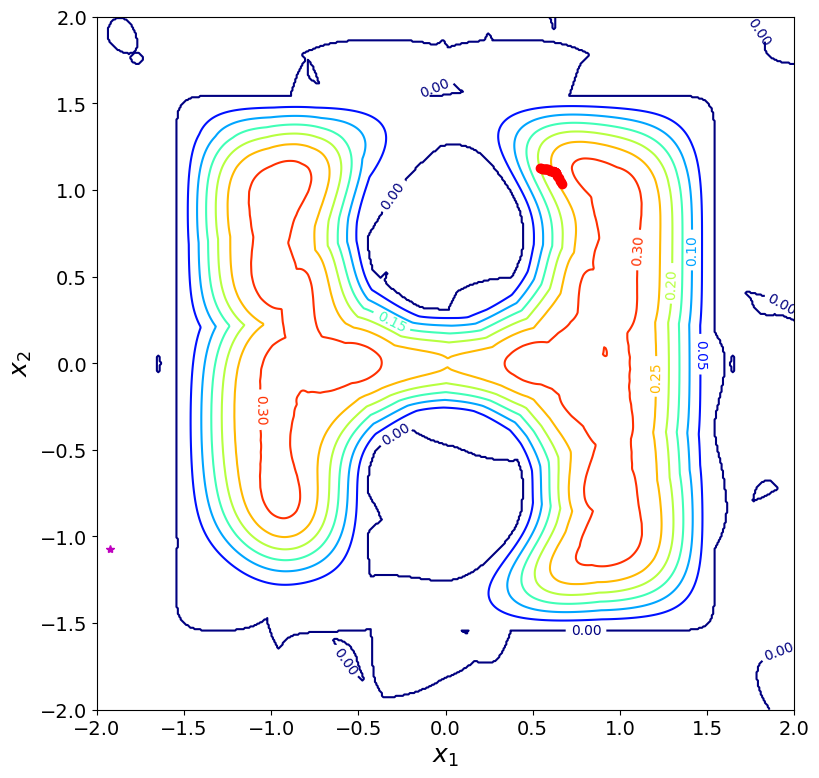

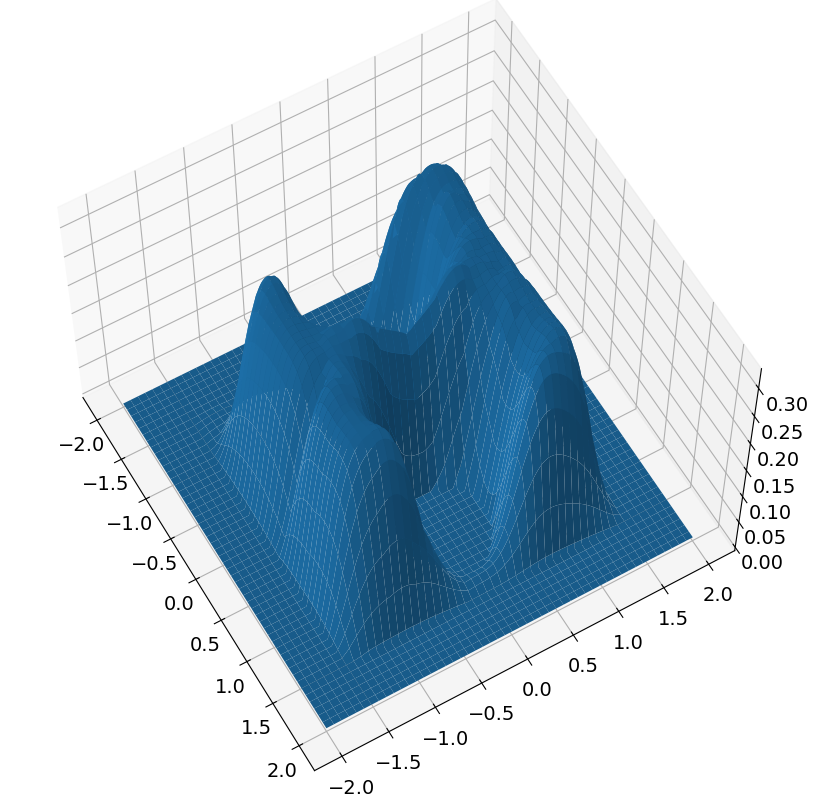

new position is [0.54032155 1.12813057]
h is now 0.19999999999999996
new time is 1100
dx: 0.15603748122411237
target: [-1.64200548  1.02097338]
target in goto [-1.64200548  1.02097338]
position is [0.54032155 1.12813057]
h is 0.19999999999999996
start time is 1100


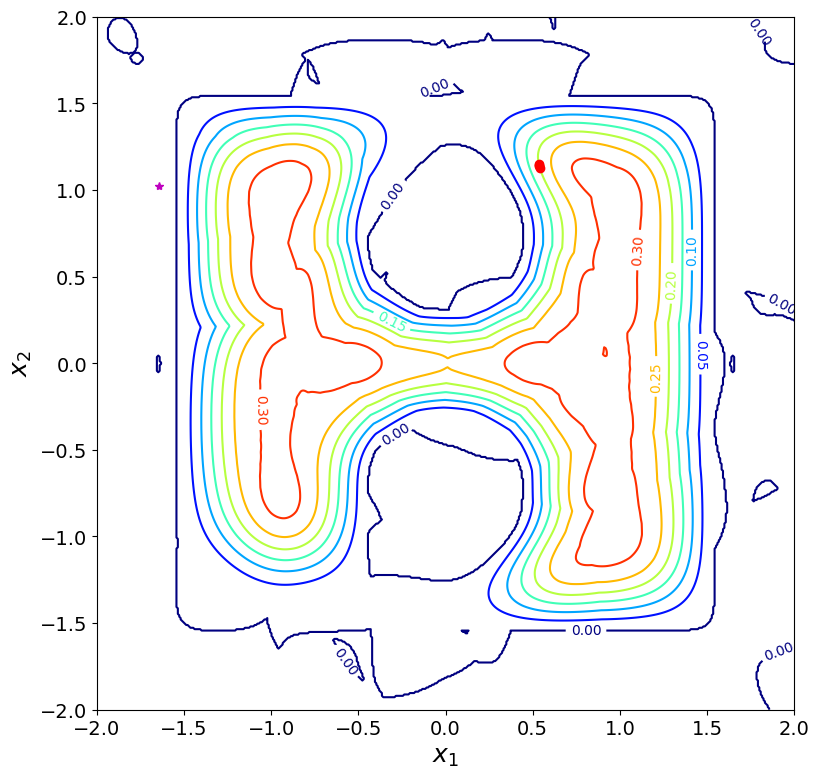

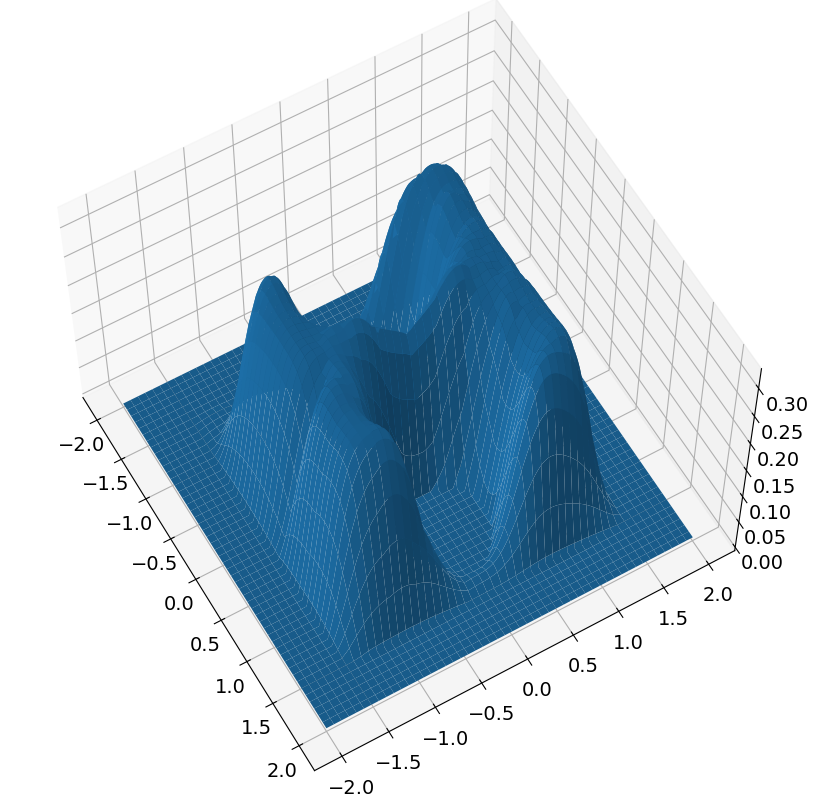

new position is [0.53462027 1.15140677]
h is now 0.19999999999999996
new time is 1150
dx: 0.17492509663044253
target: [-1.68147099  0.84766871]
target in goto [-1.68147099  0.84766871]
position is [0.53462027 1.15140677]
h is 0.19999999999999996
start time is 1150


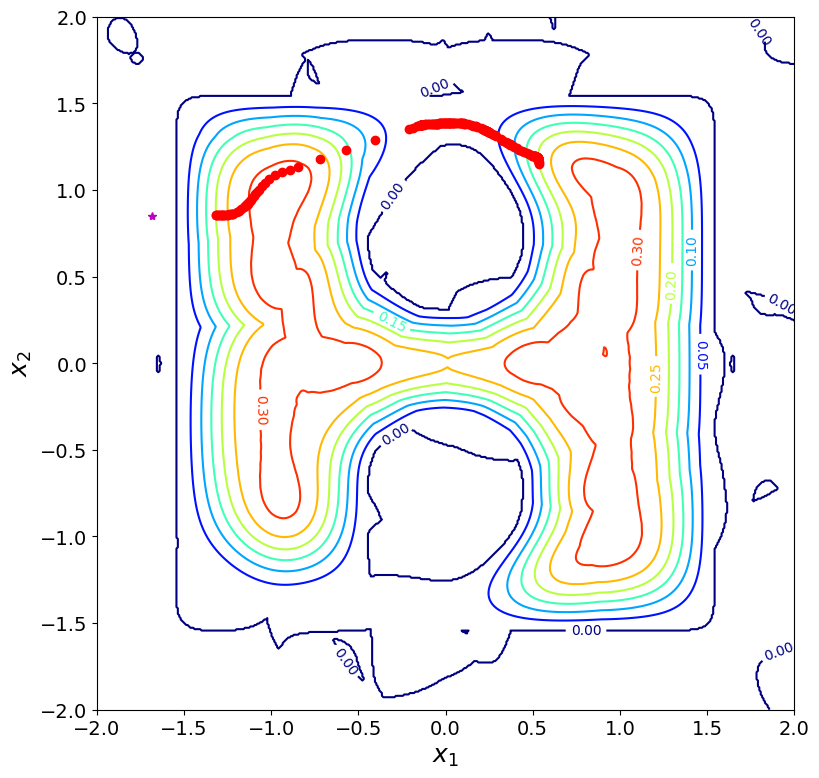

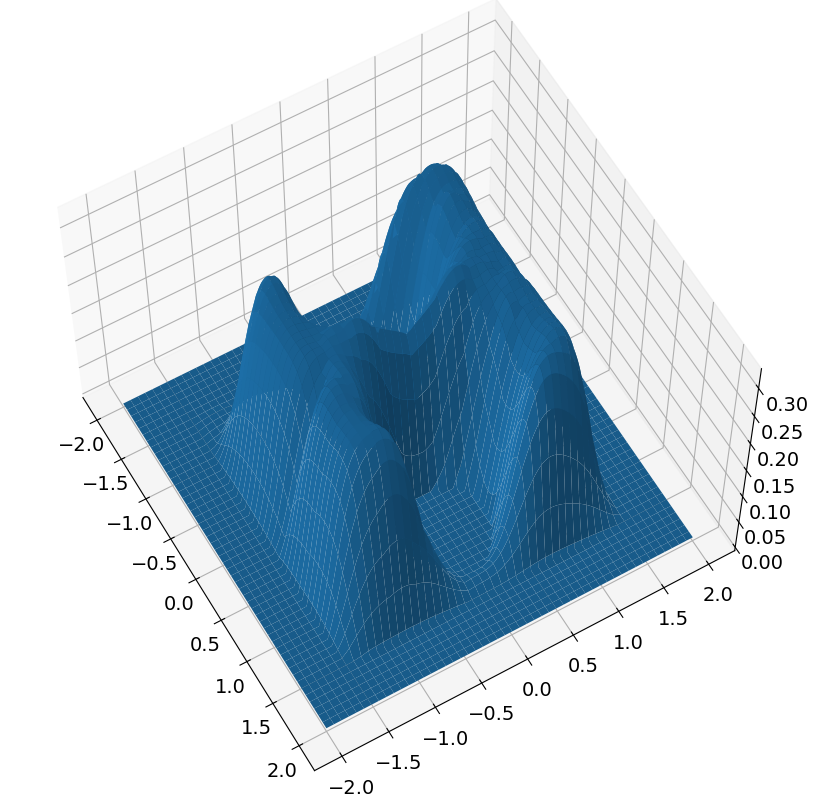

new position is [-1.31704638  0.85276794]
h is now 0.20000000000000007
new time is 1200
dx: 1.9927700456761002


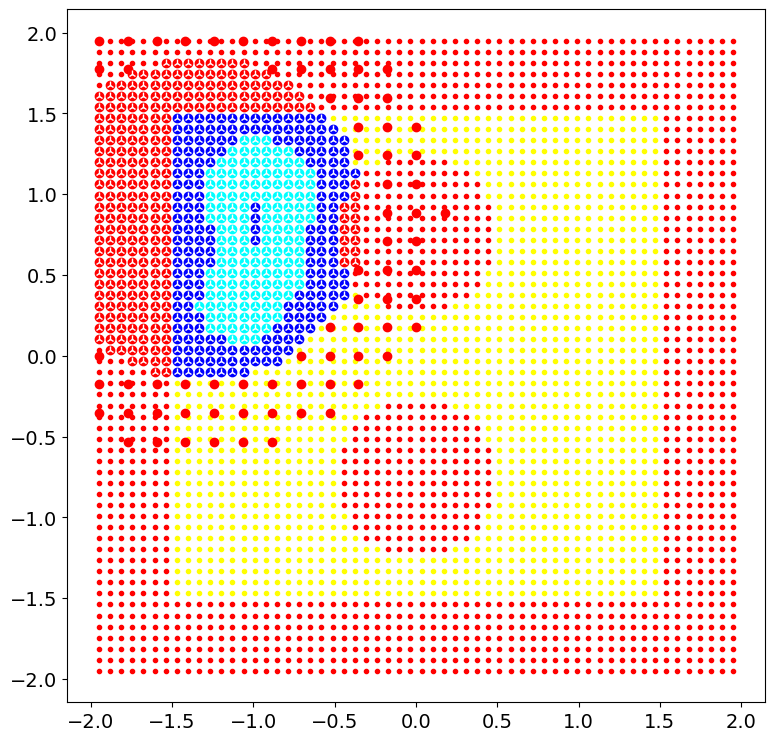

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          596     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30491D+06    |proj g|=  1.29175D+02


 This problem is unconstrained.



At iterate   50    f=  6.03240D+02    |proj g|=  1.66757D+00

At iterate  100    f=  6.02960D+02    |proj g|=  7.22849D-01

At iterate  150    f=  6.02831D+02    |proj g|=  1.52819D+00

At iterate  200    f=  6.02786D+02    |proj g|=  2.12779D+00

At iterate  250    f=  6.02771D+02    |proj g|=  8.31661D-01

At iterate  300    f=  6.02761D+02    |proj g|=  7.96065D-01

At iterate  350    f=  6.02758D+02    |proj g|=  1.31231D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  596    362    516      1     0     0   9.985D-01   6.028D+02
  F =   602.75811772599116     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

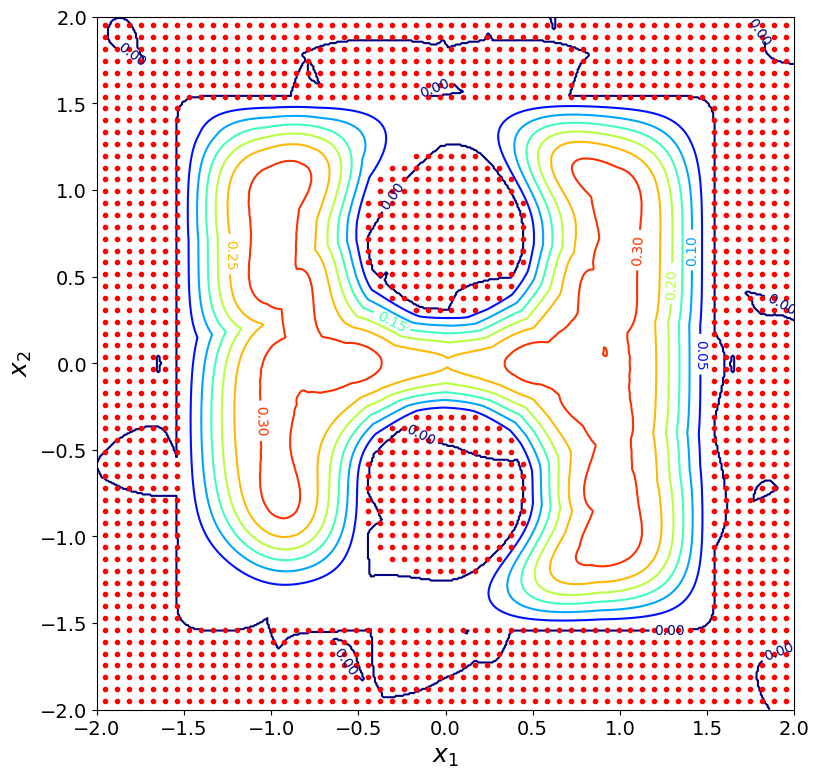

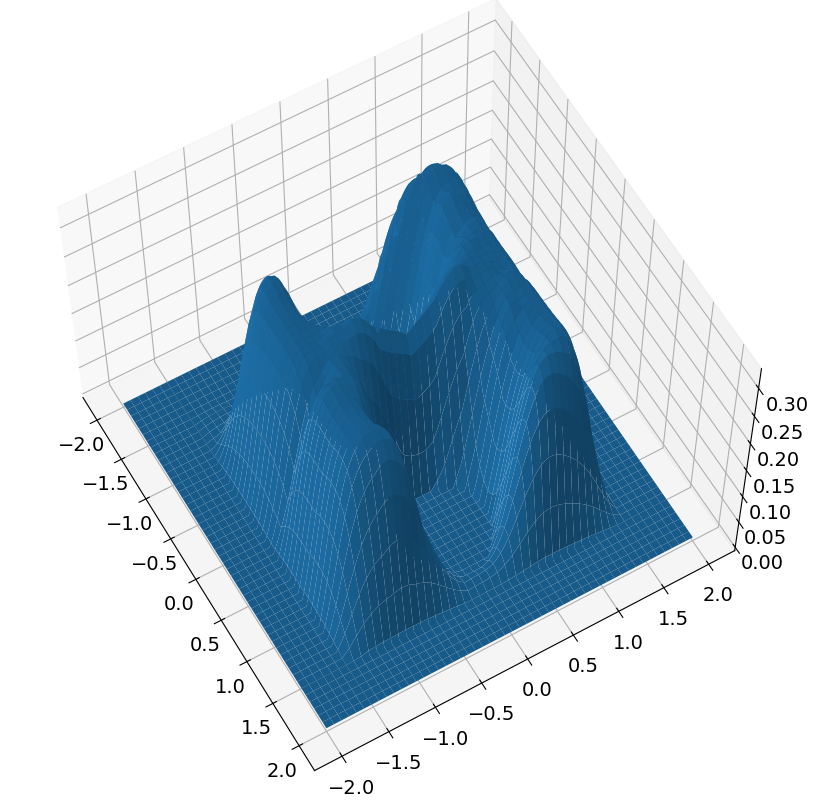

target: [-1.89795718 -1.39740682]
target in goto [-1.89795718 -1.39740682]
position is [-1.31704638  0.85276794]
h is 0.20000000000000007
start time is 1200


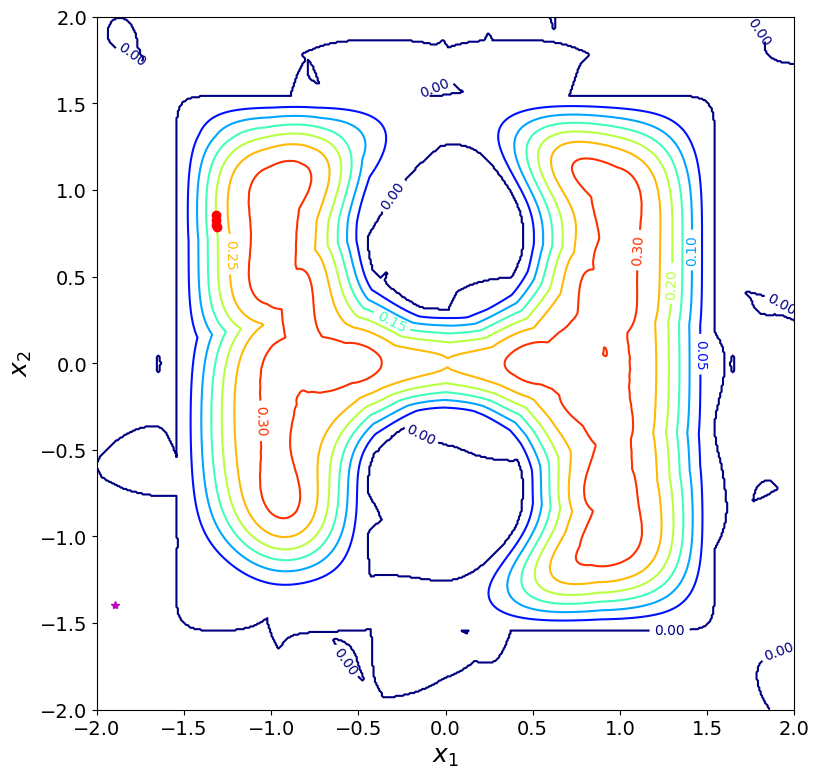

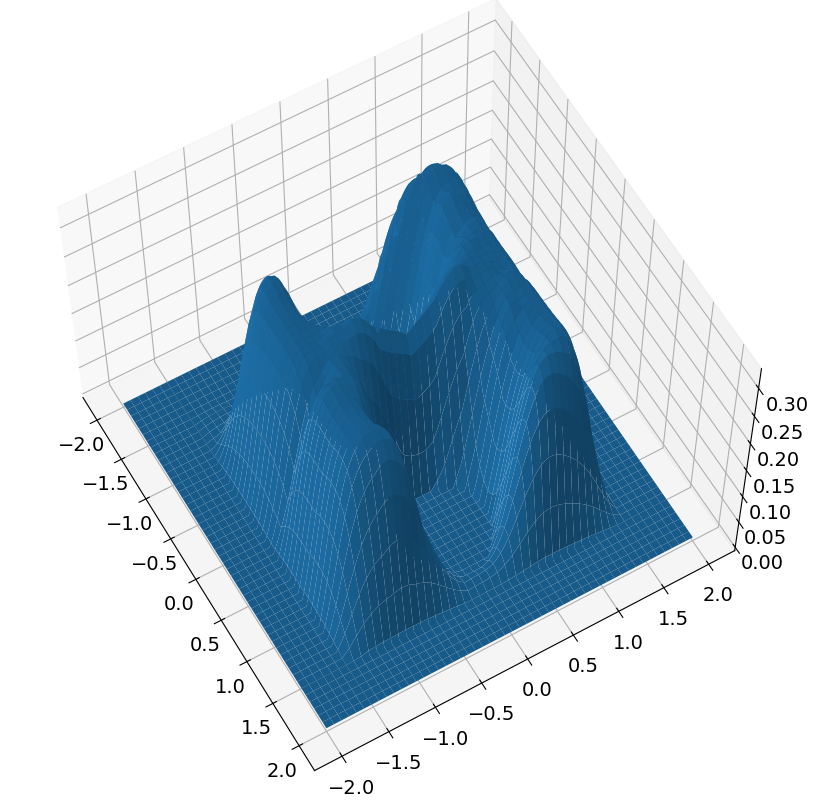

new position is [-1.31340899  0.78879015]
h is now 0.20000000000000012
new time is 1250
dx: 0.0640811043159825
target: [-1.15354123 -1.79459991]
target in goto [-1.15354123 -1.79459991]
position is [-1.31340899  0.78879015]
h is 0.20000000000000012
start time is 1250


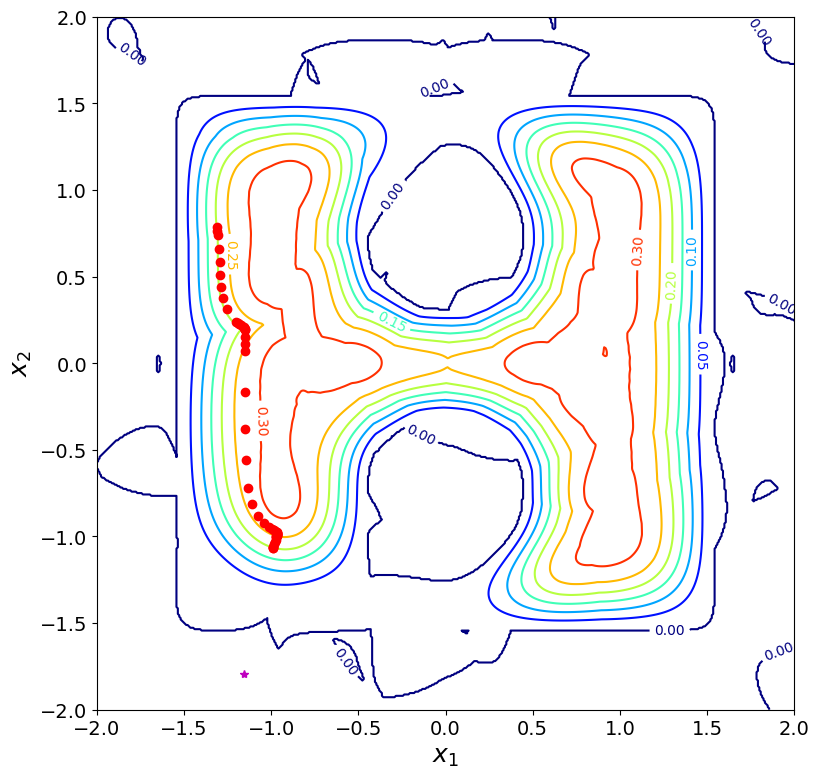

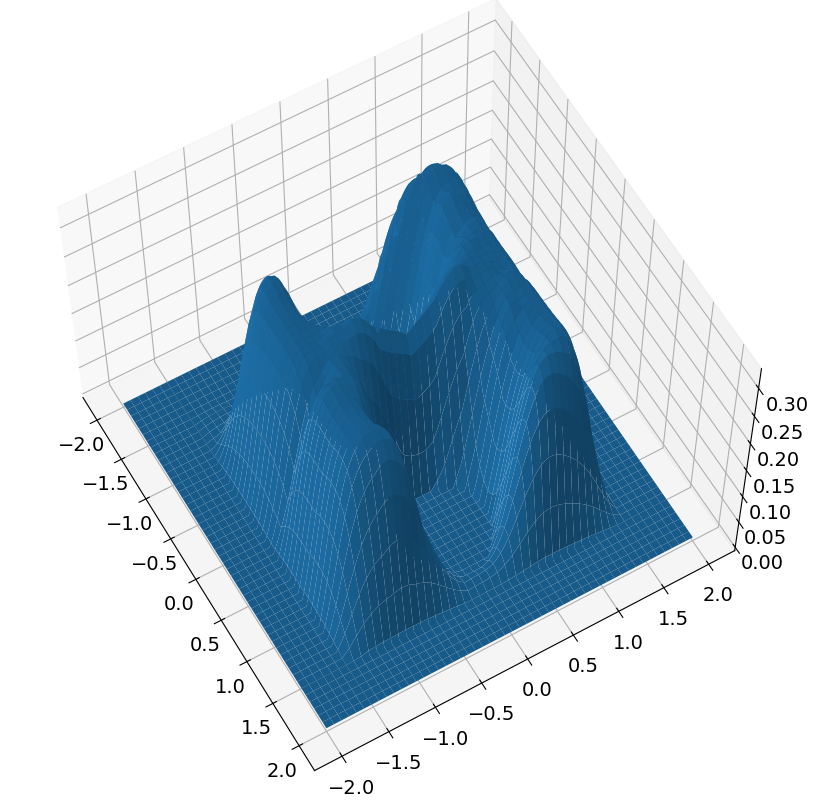

new position is [-0.98920644 -1.06470978]
h is now 0.2
new time is 1300
dx: 1.9453019842052528


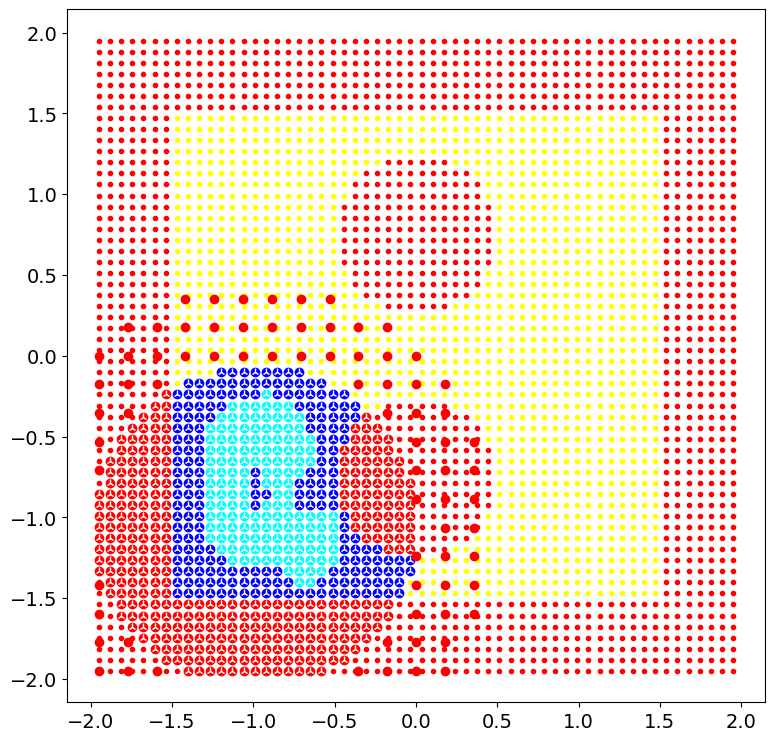

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          662     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.43160D+06    |proj g|=  1.28568D+02


 This problem is unconstrained.



At iterate   50    f=  6.25267D+02    |proj g|=  1.74359D+00

At iterate  100    f=  6.24901D+02    |proj g|=  2.30700D+00

At iterate  150    f=  6.24731D+02    |proj g|=  9.99242D-01

At iterate  200    f=  6.24704D+02    |proj g|=  1.74479D+00

At iterate  250    f=  6.24680D+02    |proj g|=  1.42377D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  662    268    407      1     0     0   1.835D+00   6.247D+02
  F =   624.67854039363442     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(

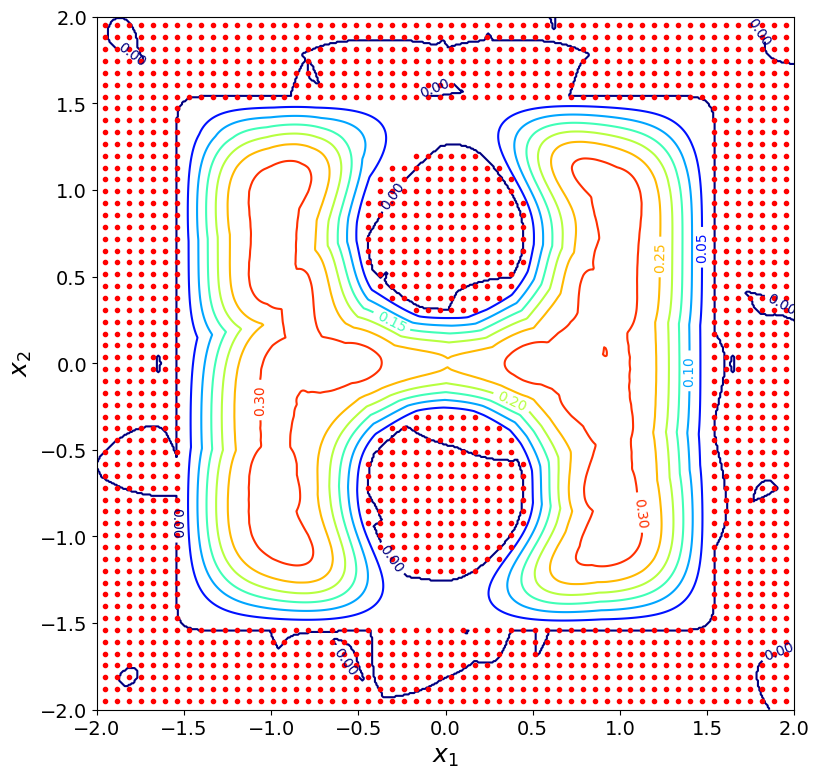

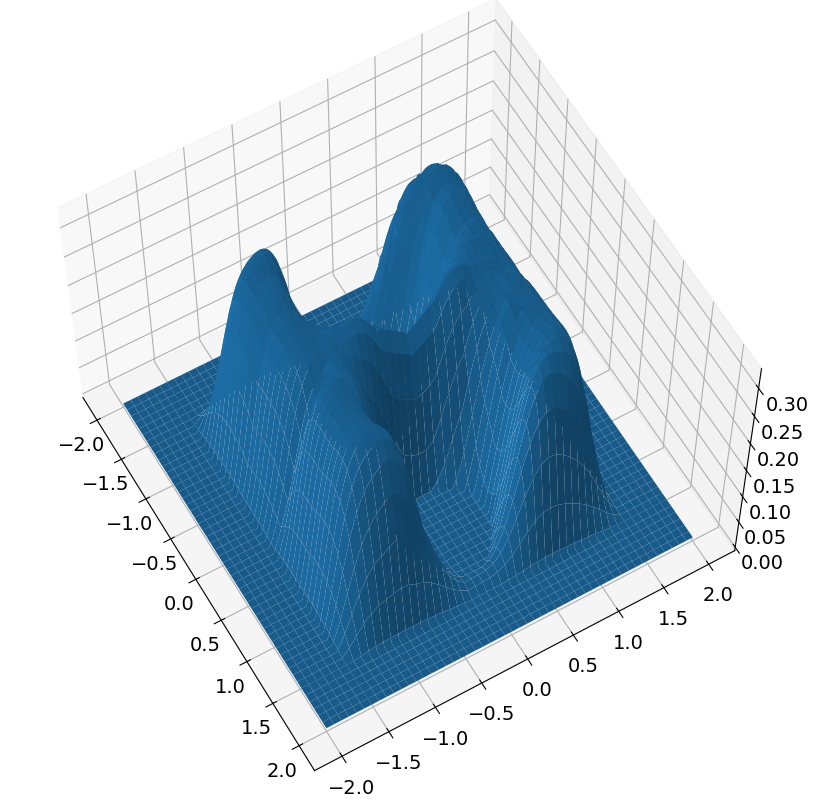

target: [-1.37288897 -1.92029345]
target in goto [-1.37288897 -1.92029345]
position is [-0.98920644 -1.06470978]
h is 0.31148693179991394
start time is 1300


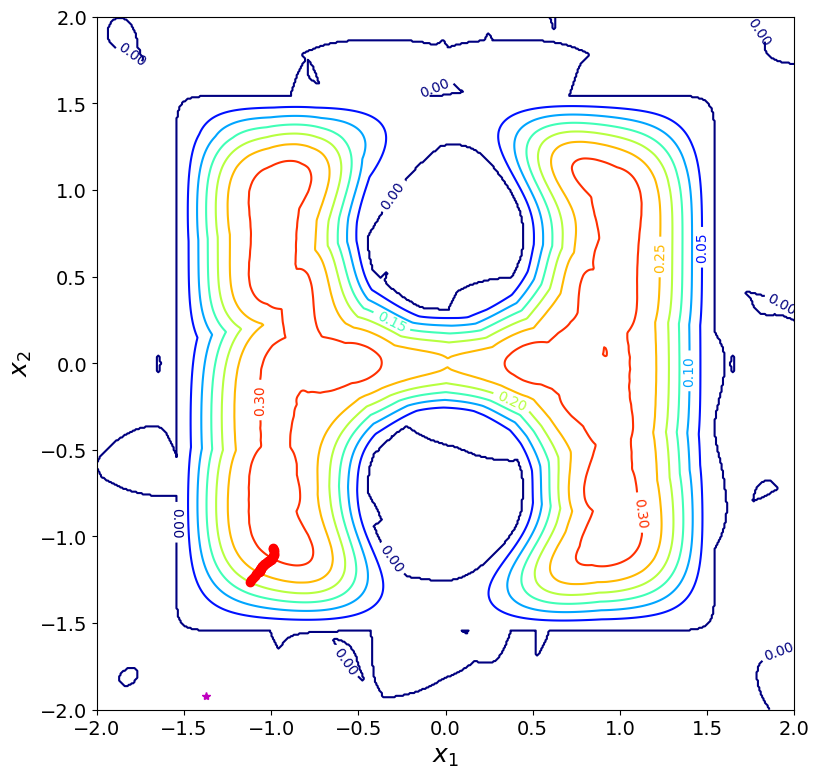

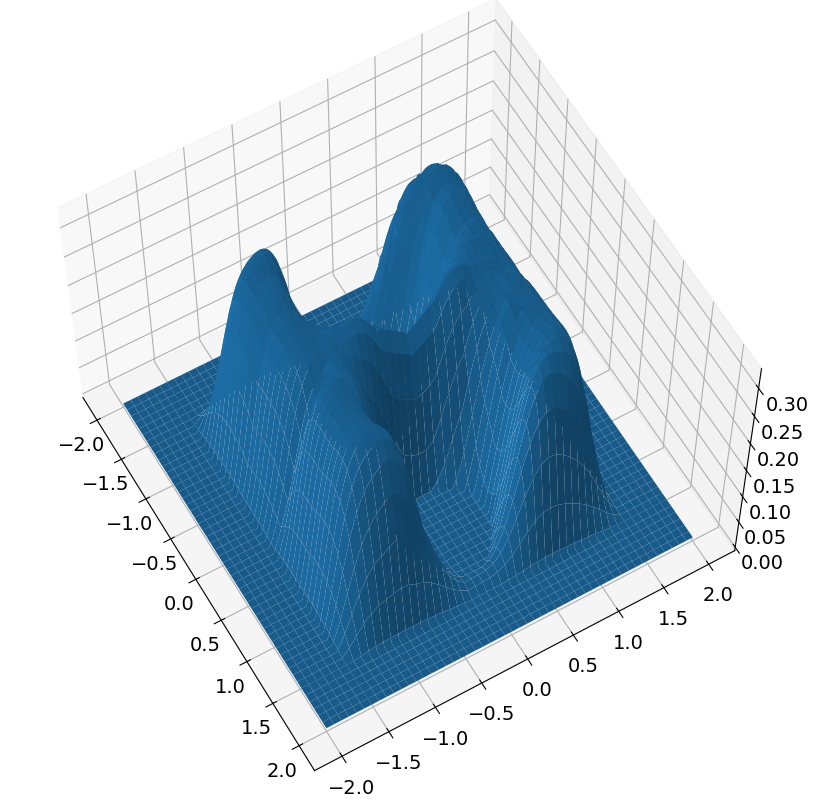

new position is [-1.12323323 -1.26297349]
h is now 0.19999999999999996
new time is 1350
dx: 0.2393150245467909


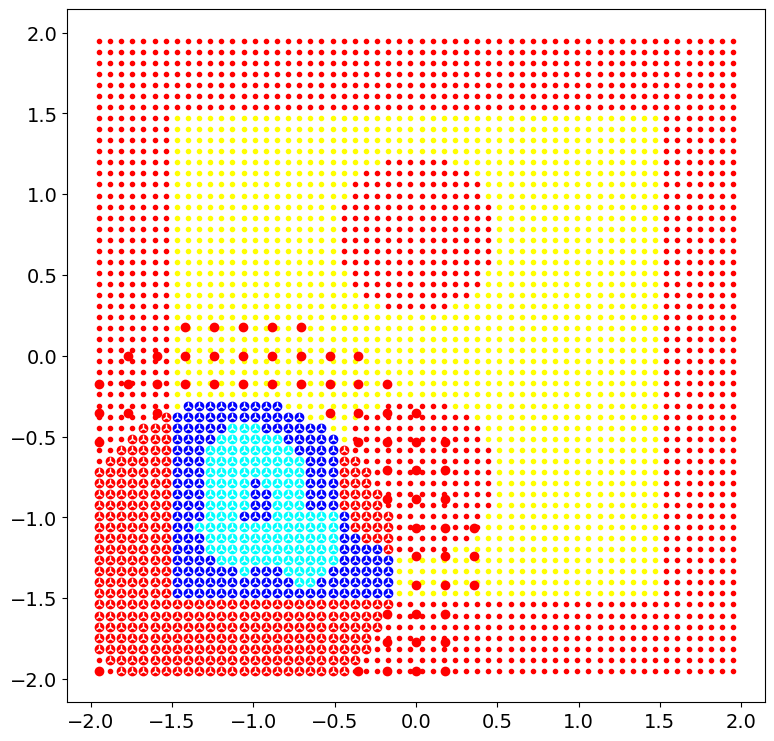

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          593     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.27336D+06    |proj g|=  1.29922D+02


 This problem is unconstrained.



At iterate   50    f=  5.63615D+02    |proj g|=  1.71412D+00

At iterate  100    f=  5.63339D+02    |proj g|=  1.25731D+00

At iterate  150    f=  5.63191D+02    |proj g|=  1.43684D+00

At iterate  200    f=  5.63158D+02    |proj g|=  9.36300D-01

At iterate  250    f=  5.63134D+02    |proj g|=  7.44065D-01

At iterate  300    f=  5.63116D+02    |proj g|=  7.23934D-01

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  593    310    473      1     0     0   1.537D+00   5.631D+02
  F =   563.11558312911802     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(6

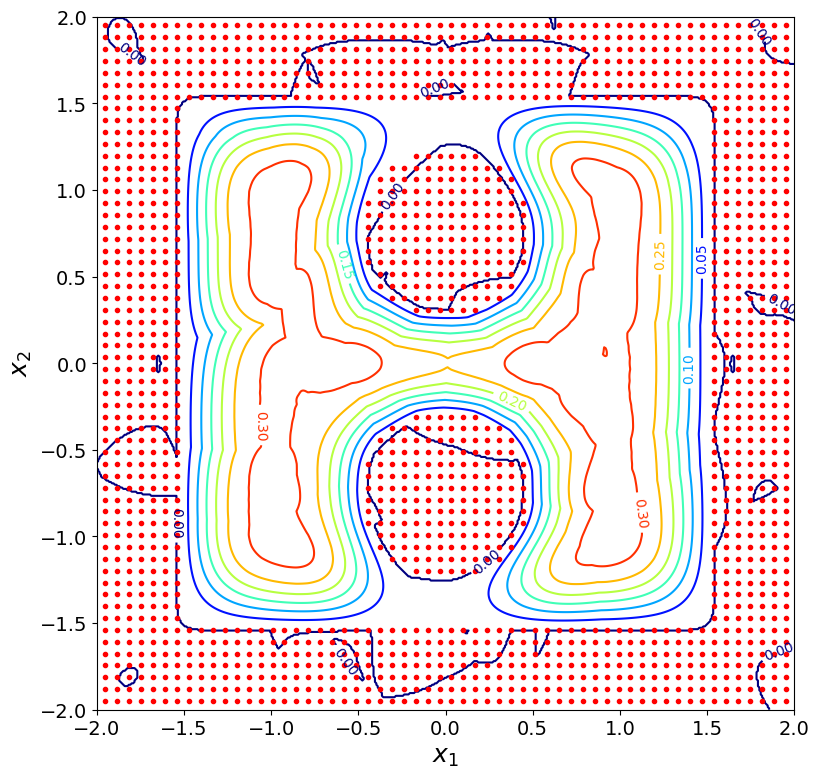

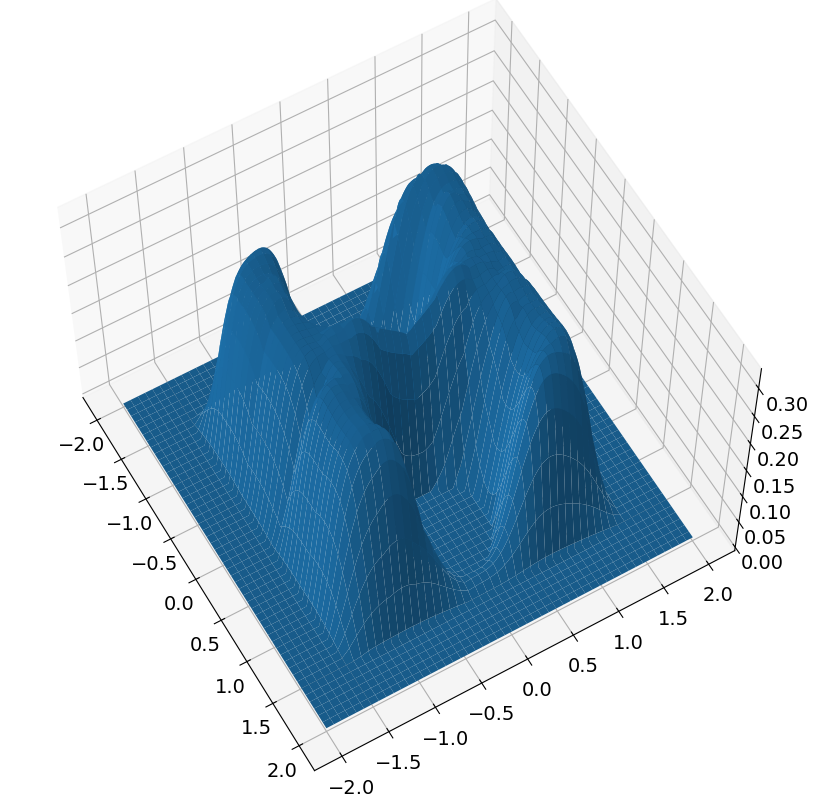

target: [ 1.75020973 -0.18867822]
target in goto [ 1.75020973 -0.18867822]
position is [-1.12323323 -1.26297349]
h is 0.21759595013484093
start time is 1350


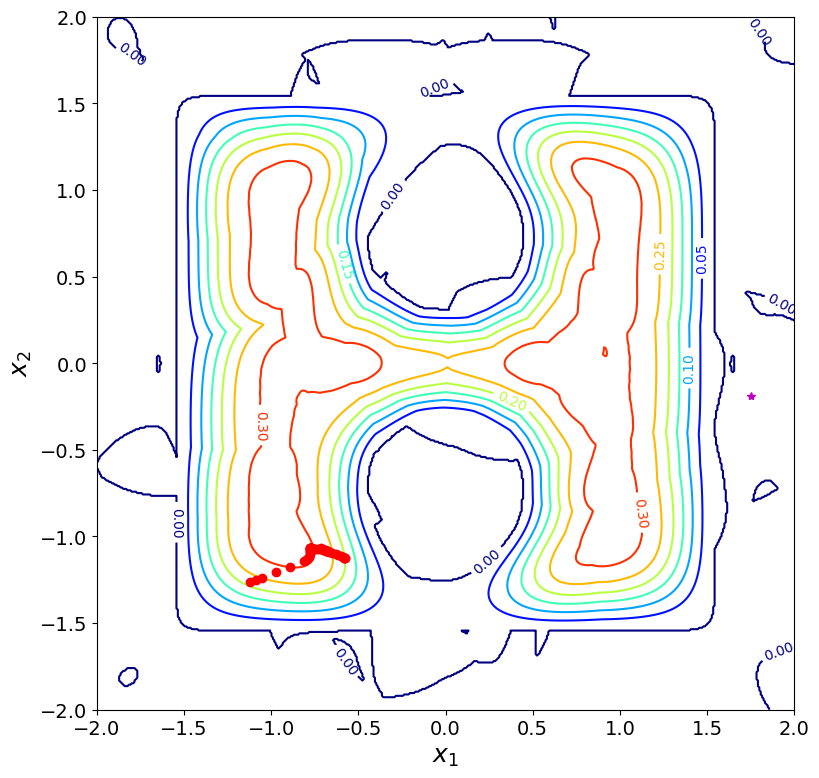

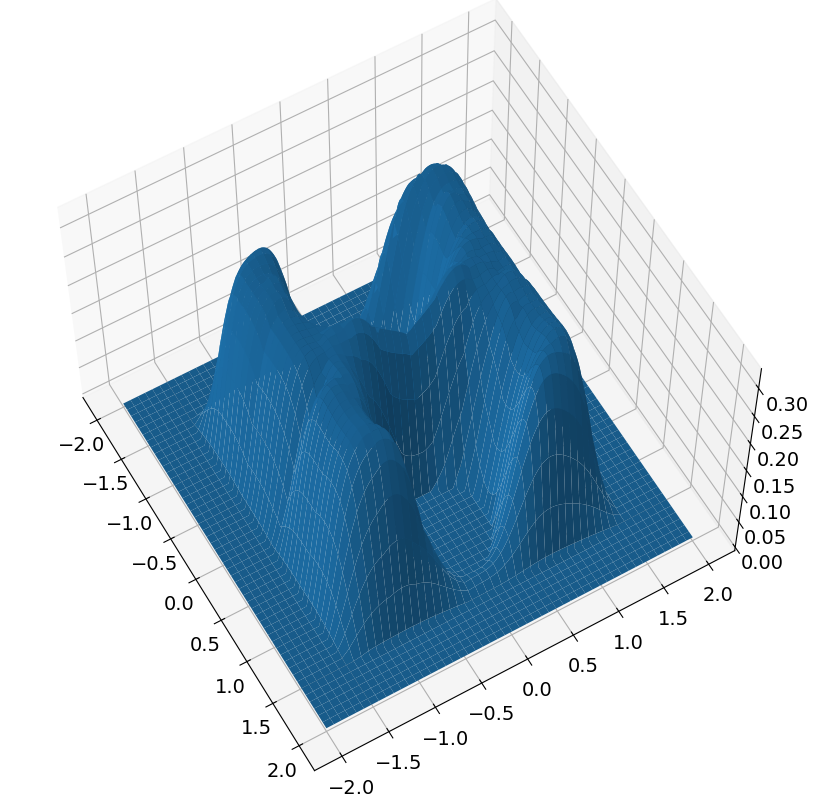

new position is [-0.5776473  -1.12386055]
h is now 0.19999999999999993
new time is 1400
dx: 0.5630421134166739


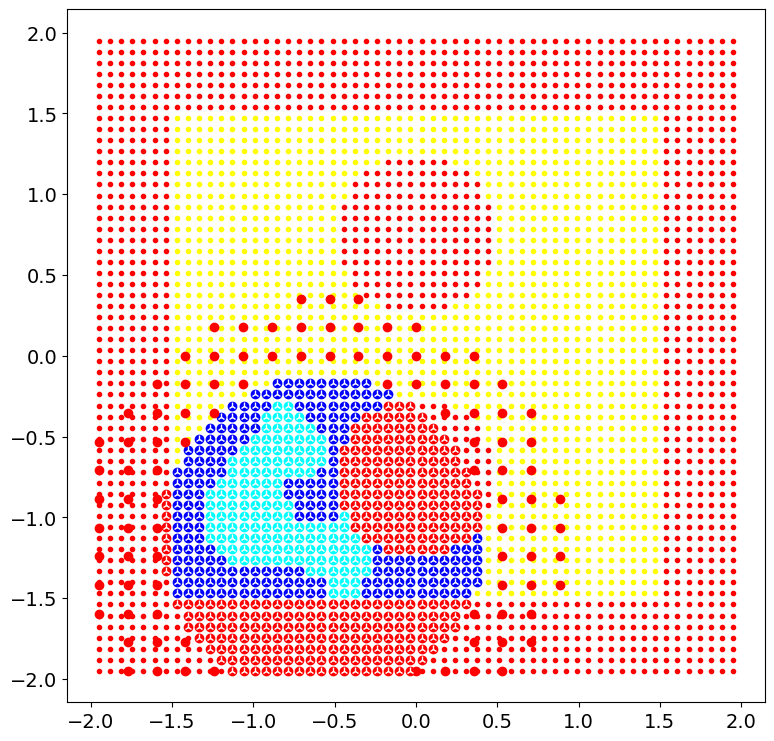

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          650     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.42716D+06    |proj g|=  1.25564D+02


 This problem is unconstrained.



At iterate   50    f=  6.98531D+02    |proj g|=  3.01543D+00

At iterate  100    f=  6.98093D+02    |proj g|=  2.13479D+00

At iterate  150    f=  6.97958D+02    |proj g|=  1.12151D+00

At iterate  200    f=  6.97906D+02    |proj g|=  1.93770D+00

At iterate  250    f=  6.97887D+02    |proj g|=  1.58341D+00

At iterate  300    f=  6.97870D+02    |proj g|=  1.00078D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  650    301    415      1     0     0   1.001D+00   6.979D+02
  F =   697.86972829434330     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(6

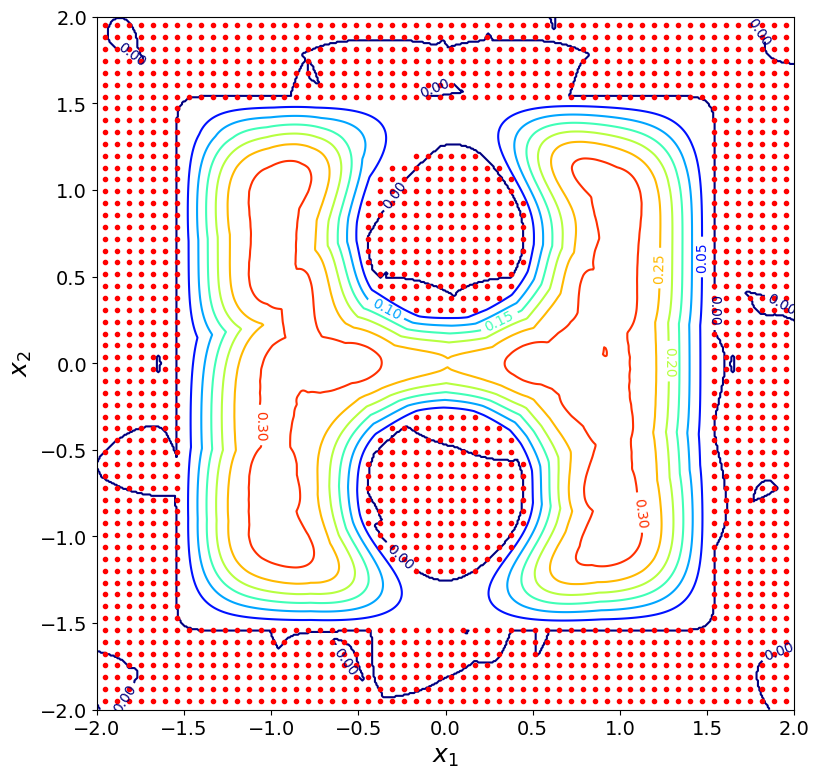

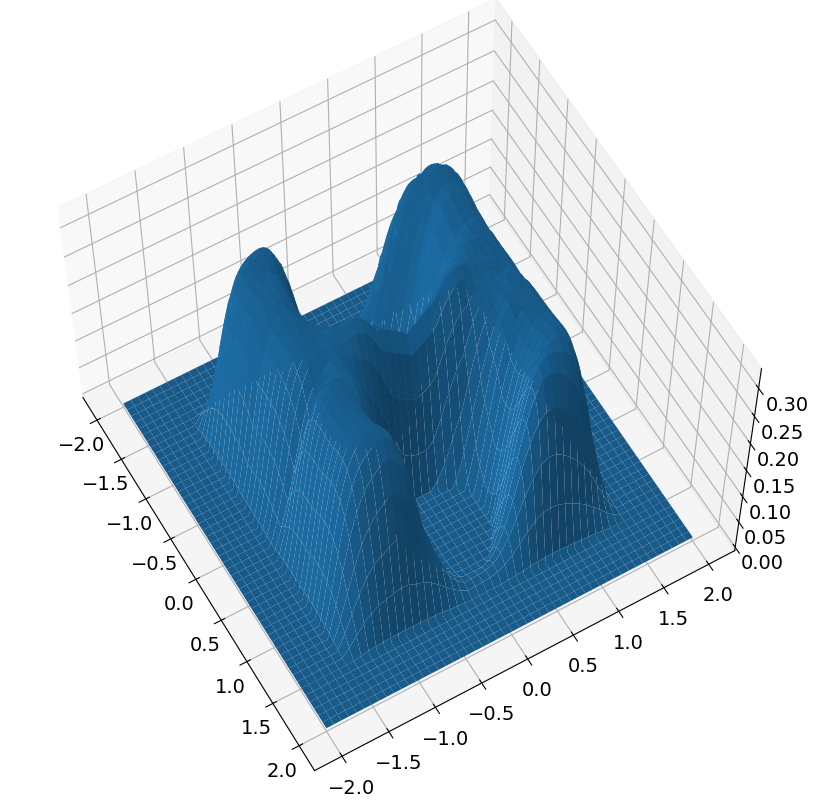

target: [-1.73063462  1.84757095]
target in goto [-1.73063462  1.84757095]
position is [-0.5776473  -1.12386055]
h is 0.22468703390090672
start time is 1400


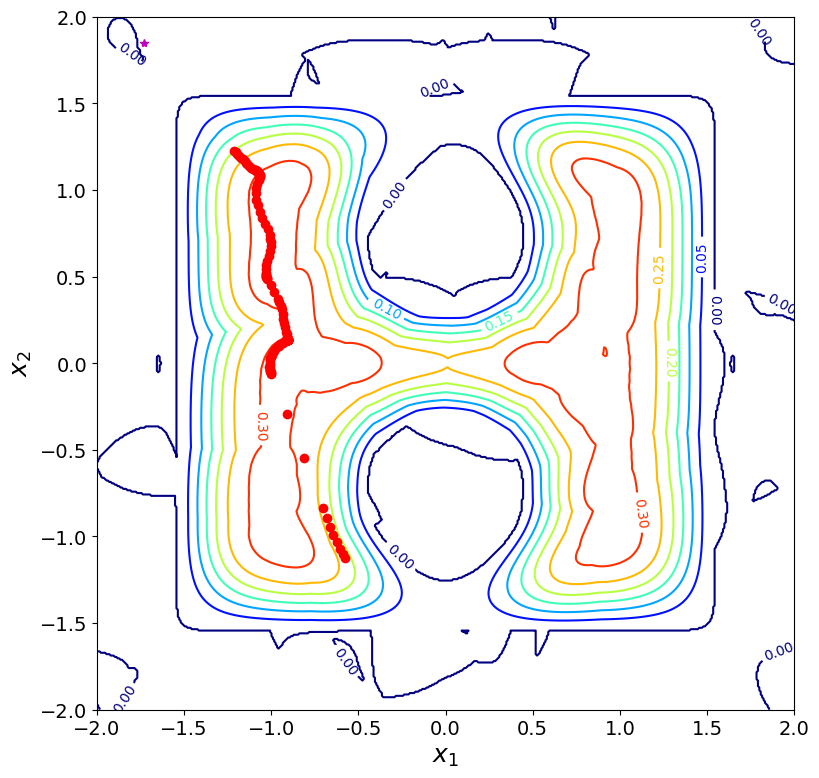

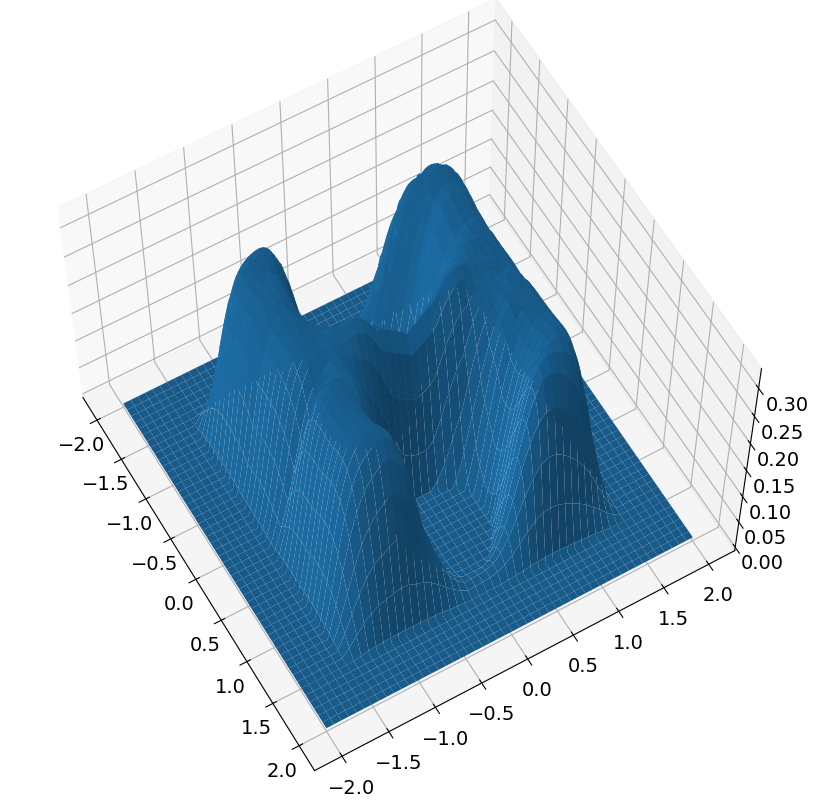

new position is [-1.21131325  1.22750471]
h is now 0.19999999999999996
new time is 1450
dx: 2.435251754709281


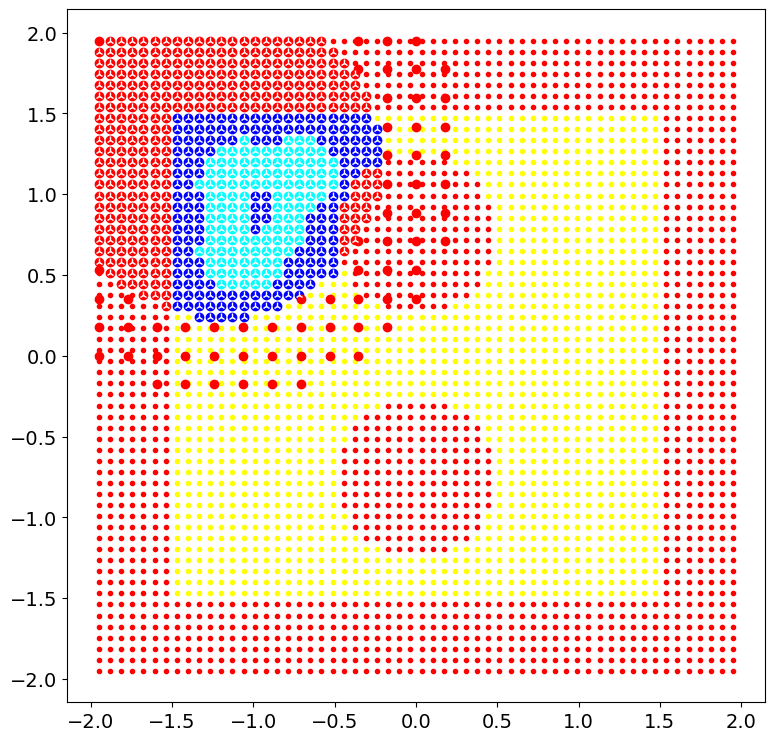

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          583     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.25503D+06    |proj g|=  1.28239D+02


 This problem is unconstrained.



At iterate   50    f=  5.62254D+02    |proj g|=  1.14490D+00

At iterate  100    f=  5.61815D+02    |proj g|=  1.46243D+00

At iterate  150    f=  5.61738D+02    |proj g|=  1.31098D+00

At iterate  200    f=  5.61704D+02    |proj g|=  2.73422D+00

At iterate  250    f=  5.61689D+02    |proj g|=  9.08621D-01

At iterate  300    f=  5.61684D+02    |proj g|=  1.02539D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  583    301    451      1     0     0   1.158D+00   5.617D+02
  F =   561.68383873403059     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(6

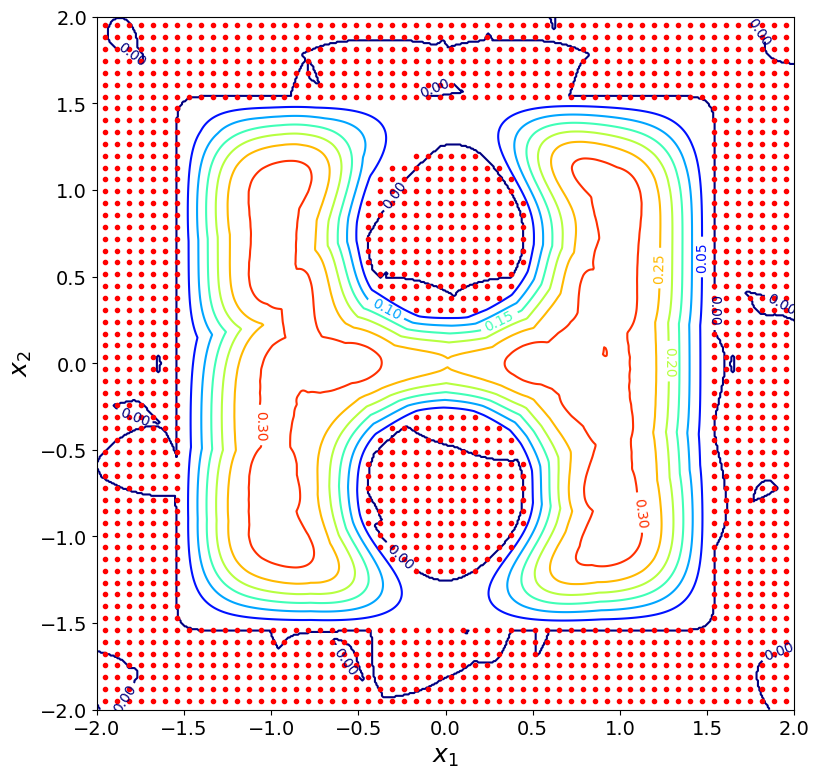

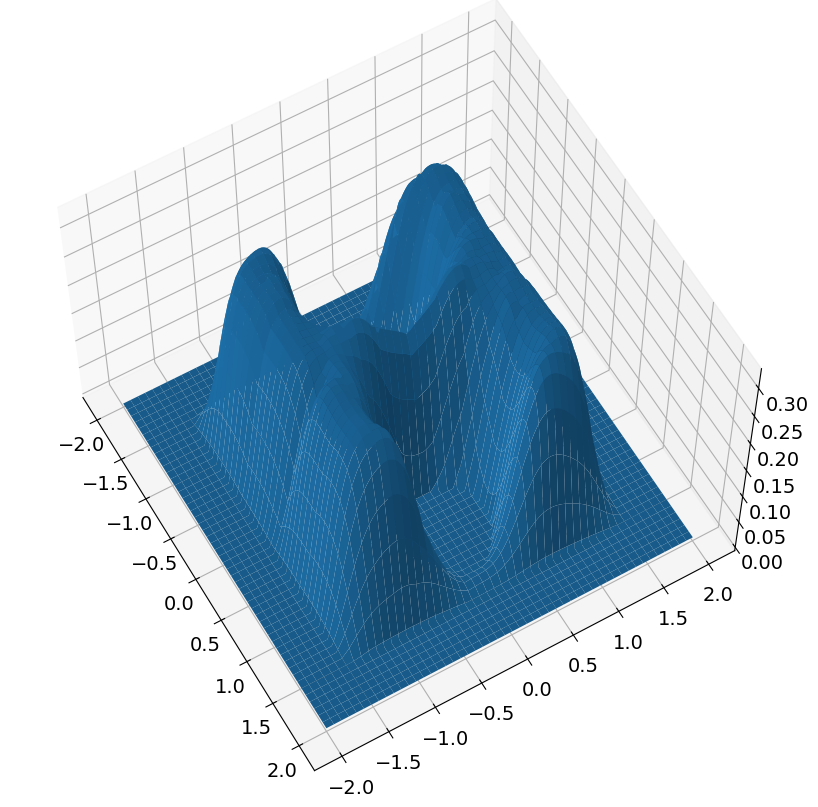

target: [-1.82853607 -0.78052732]
target in goto [-1.82853607 -0.78052732]
position is [-1.21131325  1.22750471]
h is 0.2035993322925294
start time is 1450


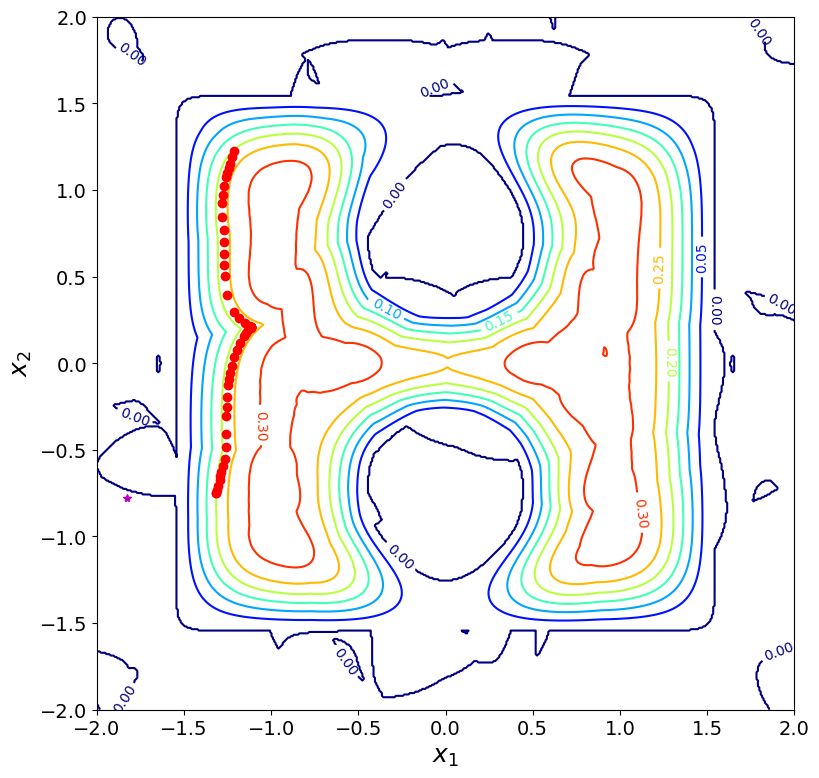

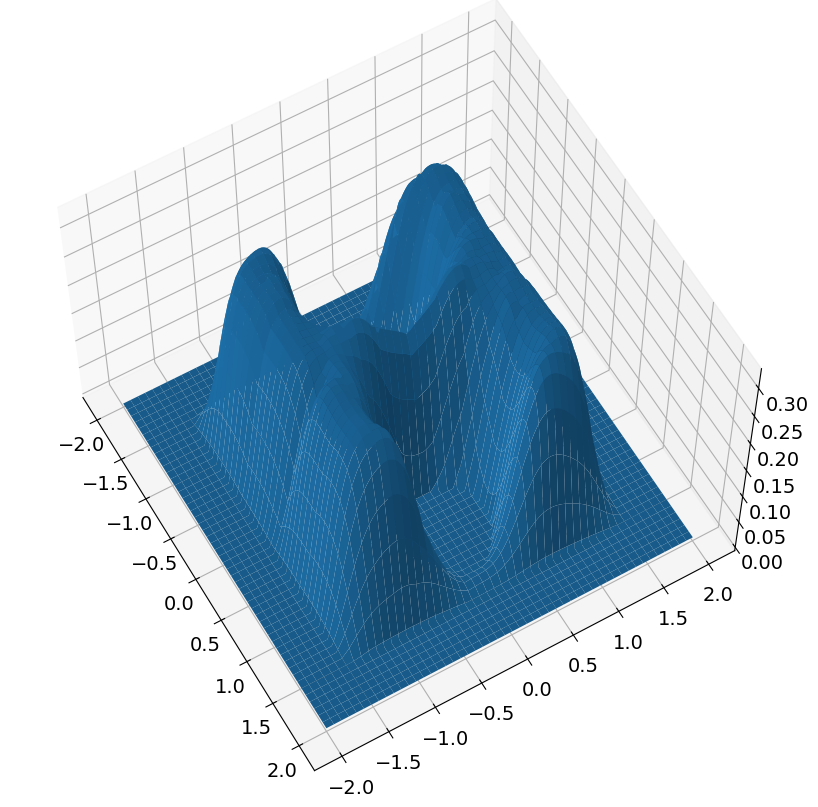

new position is [-1.31424022 -0.75106793]
h is now 0.20000000000000004
new time is 1500
dx: 1.9812479977037503


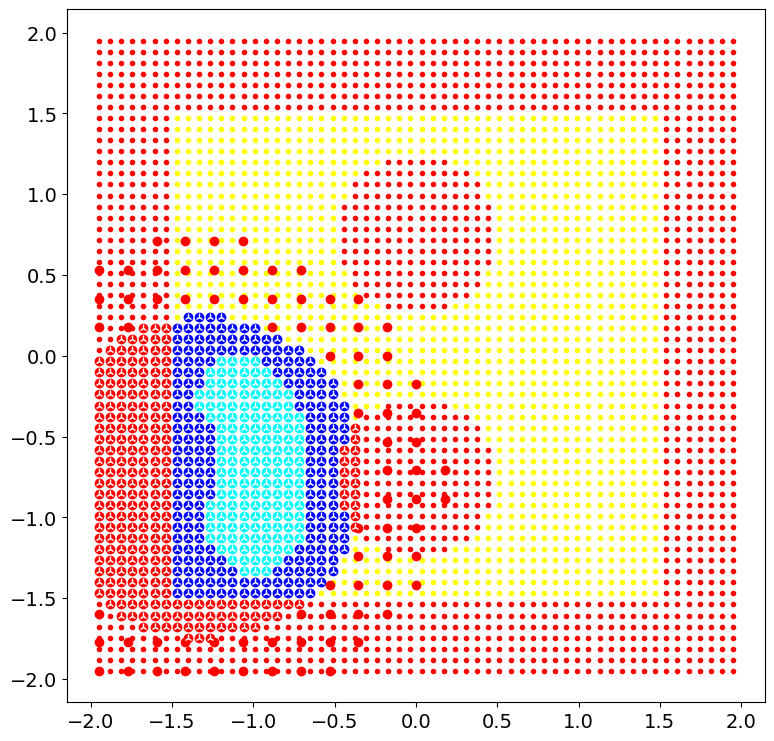

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          597     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.30651D+06    |proj g|=  1.29543D+02


 This problem is unconstrained.



At iterate   50    f=  6.03728D+02    |proj g|=  3.45955D+00

At iterate  100    f=  6.03485D+02    |proj g|=  8.78317D-01

At iterate  150    f=  6.03408D+02    |proj g|=  1.31160D+00

At iterate  200    f=  6.03366D+02    |proj g|=  8.21702D-01

At iterate  250    f=  6.03320D+02    |proj g|=  1.64854D+00

At iterate  300    f=  6.03305D+02    |proj g|=  1.24661D+00

At iterate  350    f=  6.03290D+02    |proj g|=  1.02962D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  597    362    507      1     0     0   1.125D+00   6.033D+02
  F =   603.28932318732438     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH   

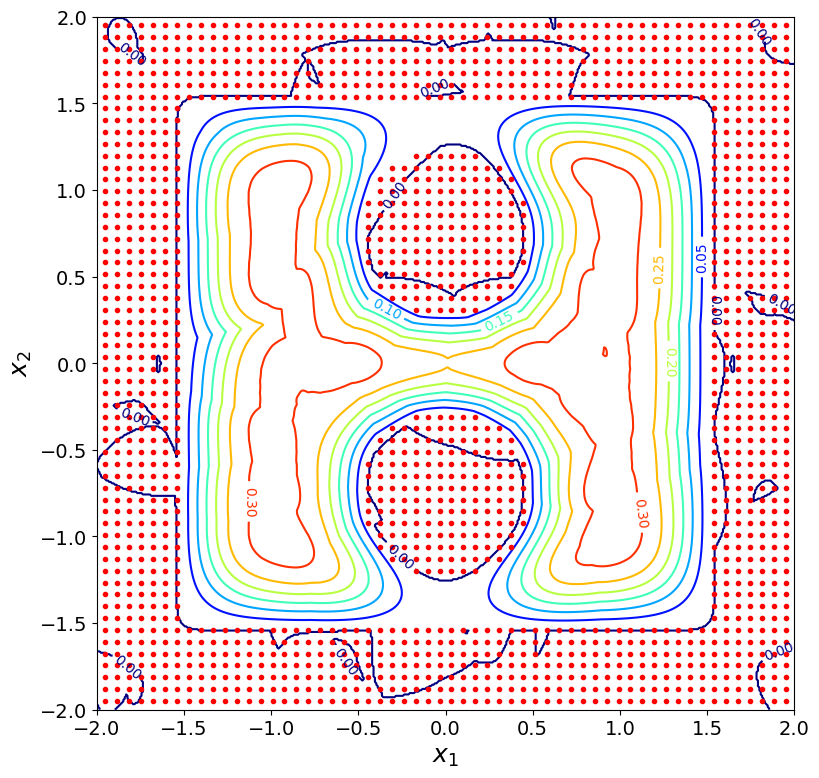

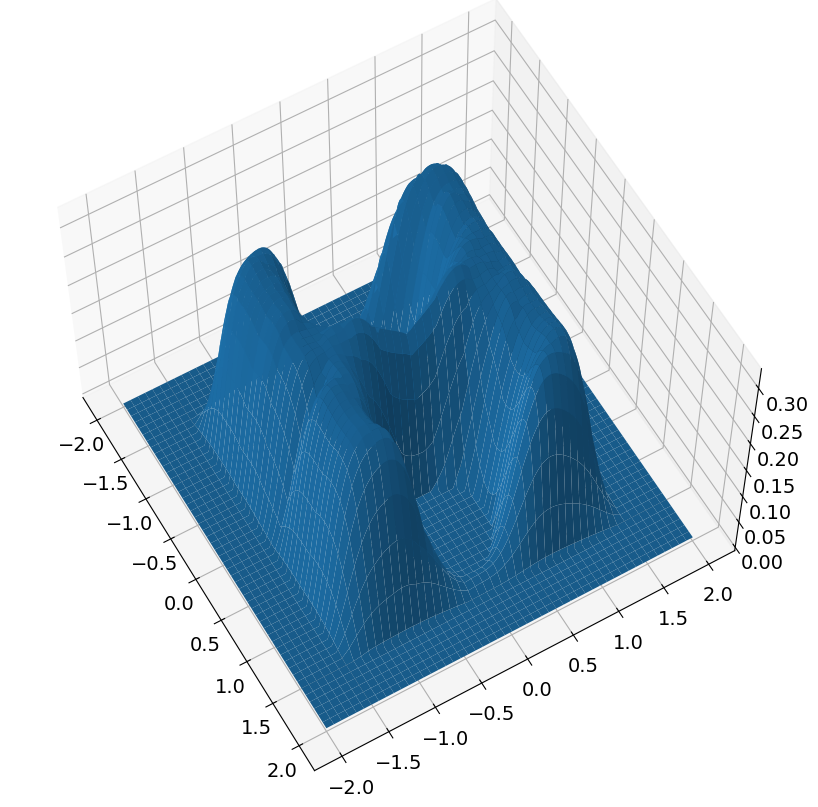

target: [-1.77209326  0.33530424]
target in goto [-1.77209326  0.33530424]
position is [-1.31424022 -0.75106793]
h is 0.20000000000000004
start time is 1500


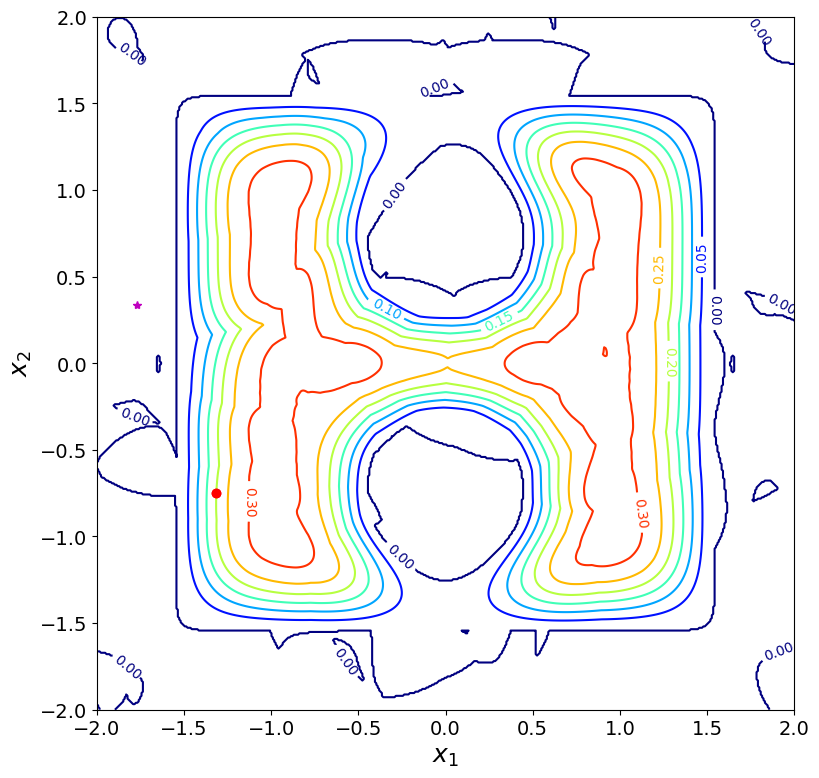

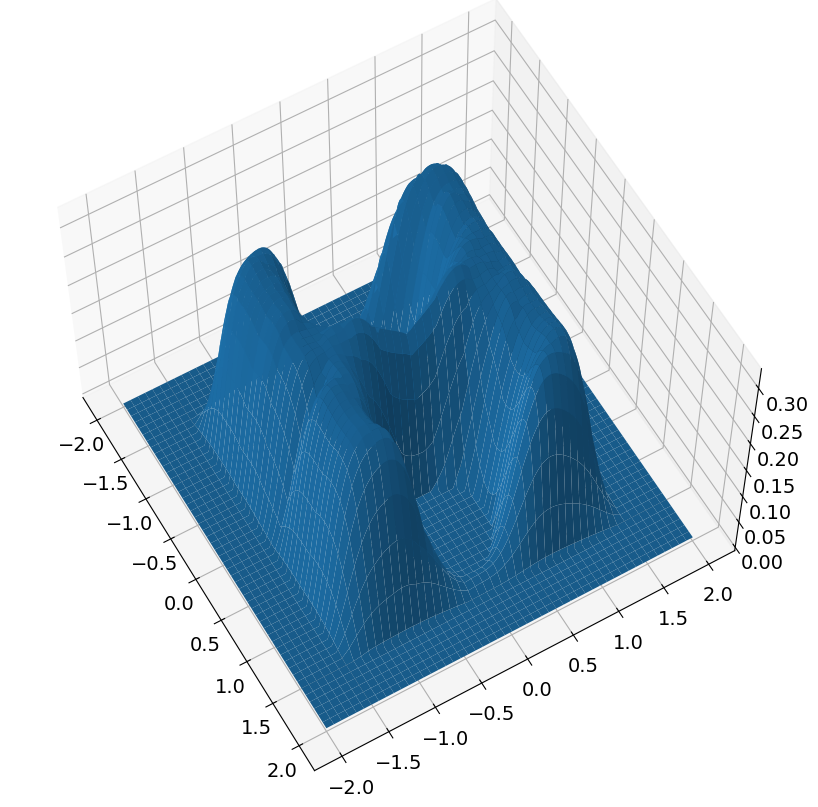

new position is [-1.31424022 -0.75106793]
h is now 0.20000000000000007
new time is 1550
dx: 5.892976803371238e-13
target: [-1.66710628  1.7348446 ]
target in goto [-1.66710628  1.7348446 ]
position is [-1.31424022 -0.75106793]
h is 0.20000000000000007
start time is 1550


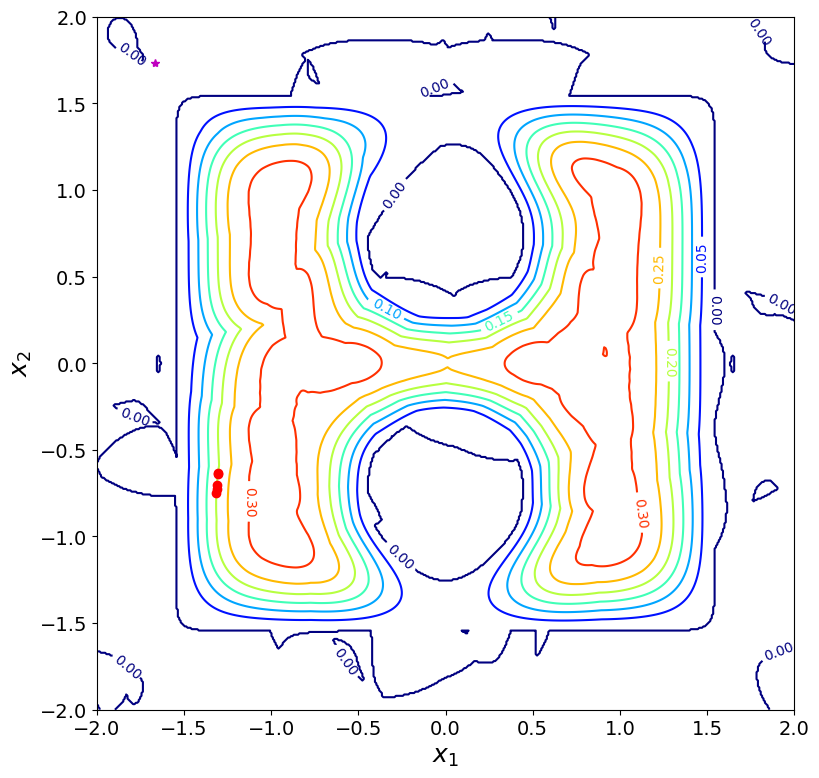

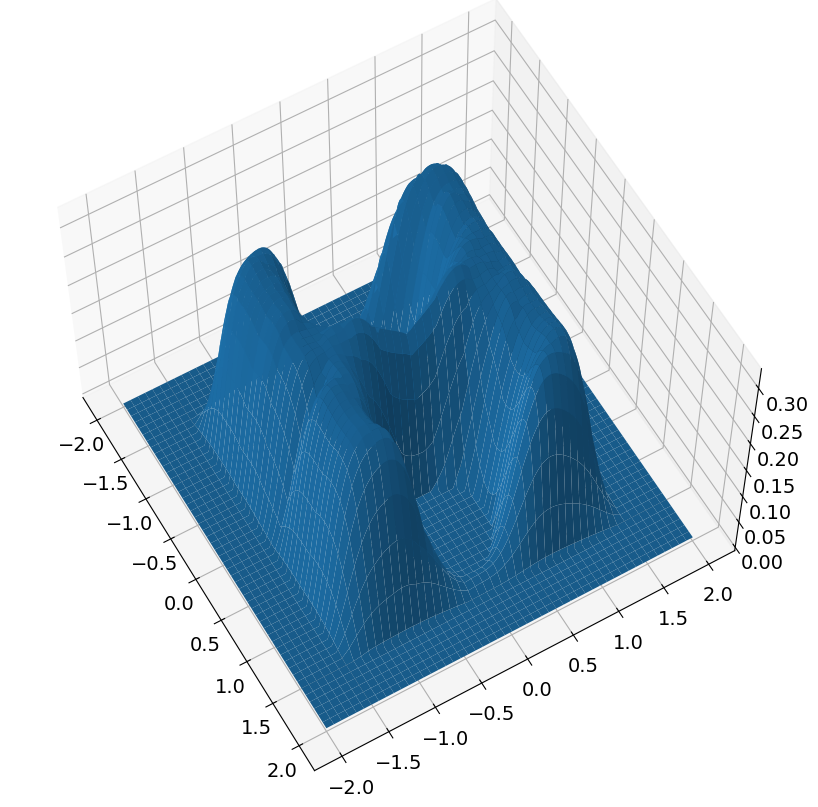

new position is [-1.30469603 -0.63101213]
h is now 0.19999999999999968
new time is 1600
dx: 0.12043457318439028
target: [-1.86166343  1.07117342]
target in goto [-1.86166343  1.07117342]
position is [-1.30469603 -0.63101213]
h is 0.19999999999999968
start time is 1600


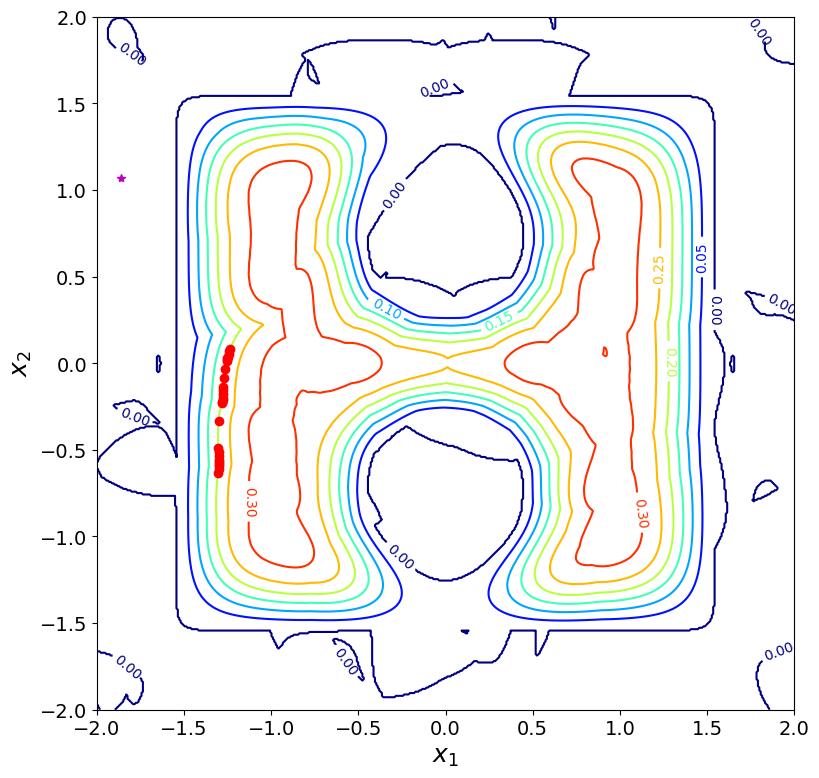

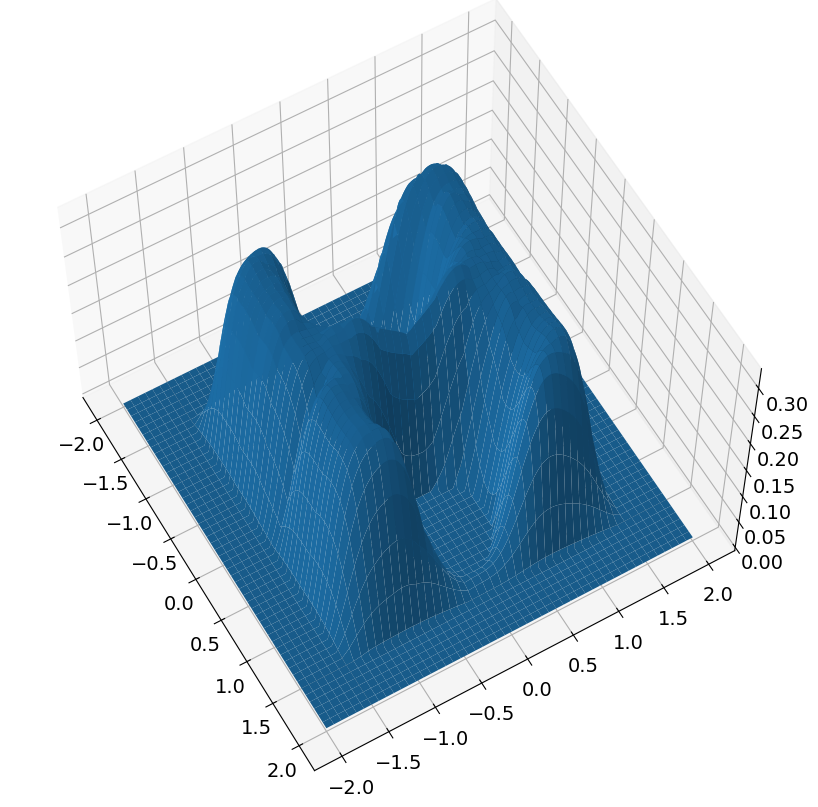

new position is [-1.23499513  0.08056184]
h is now 0.20000000000000018
new time is 1650
dx: 0.8353968179140769


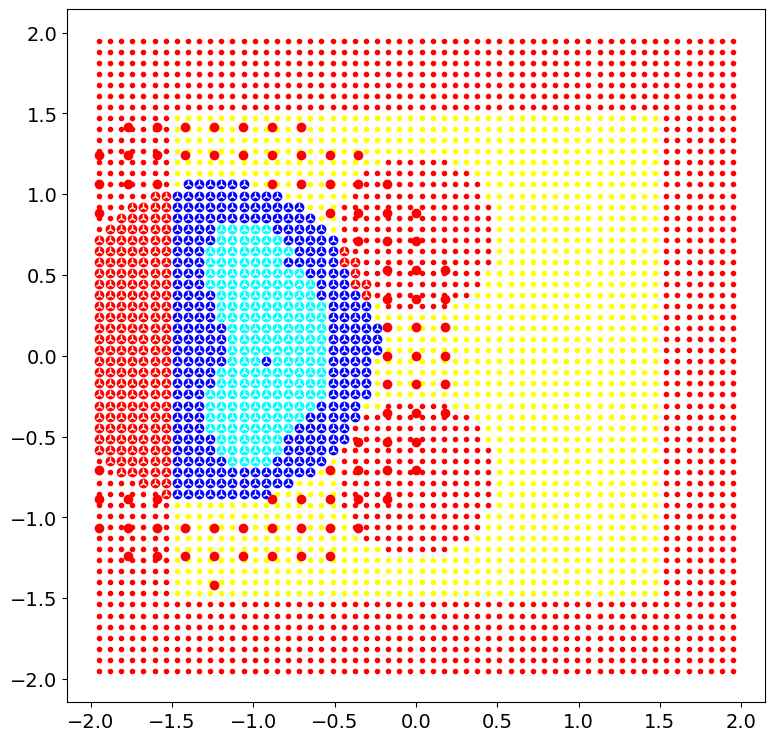

RUNNING THE L-BFGS-B CODE

           * * *

Machine precision = 2.220D-16
 N =          621     M =           10

At X0         0 variables are exactly at the bounds

At iterate    0    f=  1.38643D+06    |proj g|=  1.26074D+02


 This problem is unconstrained.



At iterate   50    f=  6.56125D+02    |proj g|=  3.08034D+00

At iterate  100    f=  6.55817D+02    |proj g|=  3.71045D+00

At iterate  150    f=  6.55759D+02    |proj g|=  1.49209D+00

At iterate  200    f=  6.55733D+02    |proj g|=  1.37344D+00

At iterate  250    f=  6.55708D+02    |proj g|=  1.41890D+00

           * * *

Tit   = total number of iterations
Tnf   = total number of function evaluations
Tnint = total number of segments explored during Cauchy searches
Skip  = number of BFGS updates skipped
Nact  = number of active bounds at final generalized Cauchy point
Projg = norm of the final projected gradient
F     = final function value

           * * *

   N    Tit     Tnf  Tnint  Skip  Nact     Projg        F
  621    266    384      1     0     0   1.081D+00   6.557D+02
  F =   655.70778053298716     

CONVERGENCE: REL_REDUCTION_OF_F_<=_FACTR*EPSMCH             
centers shape before:
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(680, 2)
(

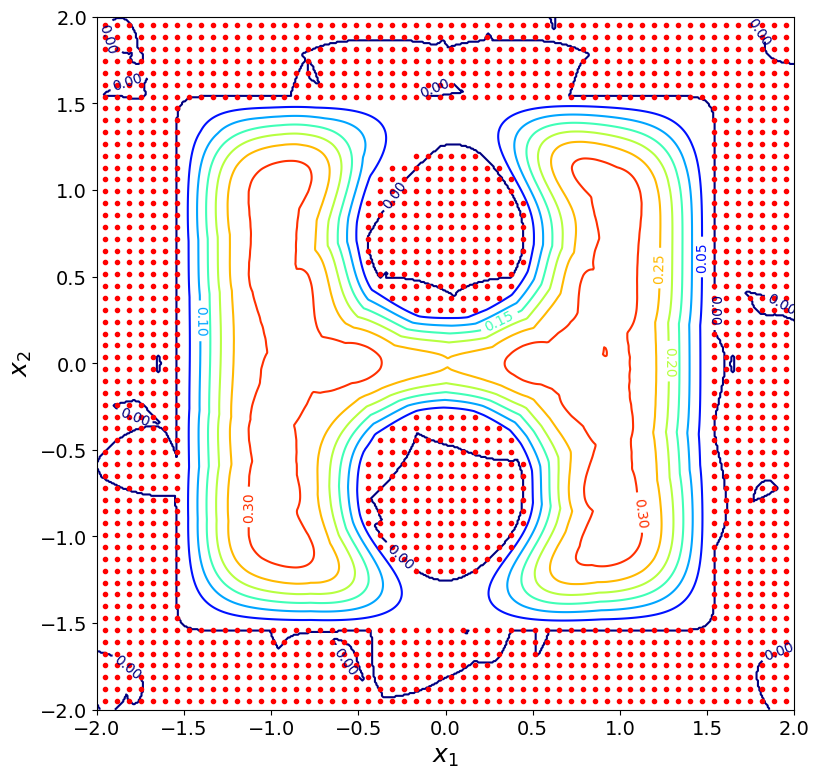

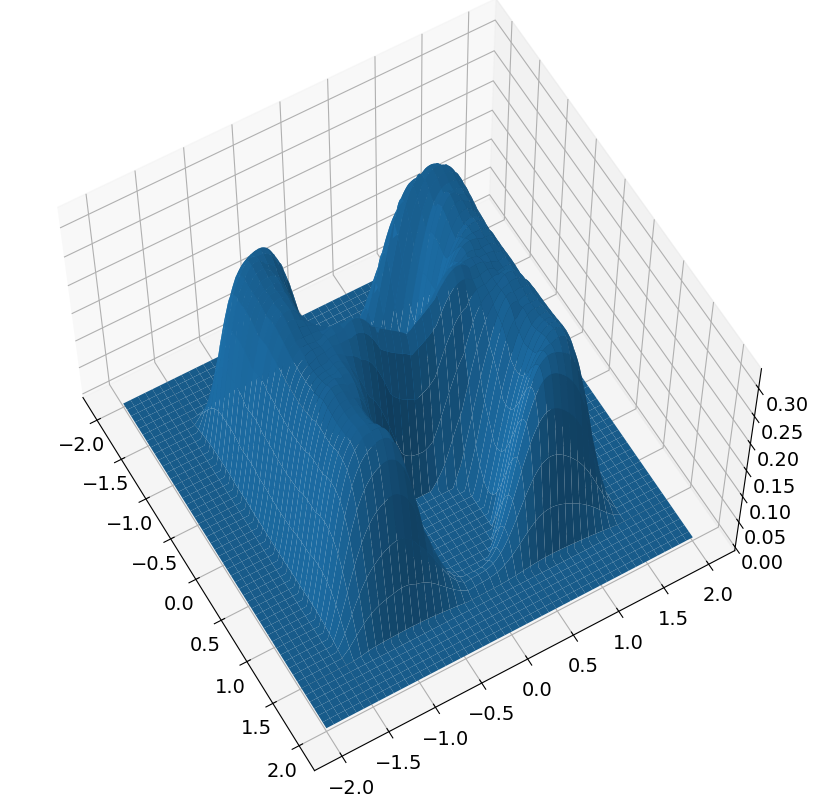

target: [ 1.93463767 -1.26138294]
target in goto [ 1.93463767 -1.26138294]
position is [-1.23499513  0.08056184]
h is 0.23757952485671127
start time is 1650


In [ ]:
##########################
### Safe Exploration ###
##########################

for i in range(N):
    ######################
    ### Go to boundary ###
    ######################
    prev_pos = a.pos  
    while np.linalg.norm(a.pos - prev_pos) <= tol:    
        target=a.width*(1+unsafe_margin)*(np.random.rand(2)-0.5)  
        while h(target, np.array(a.centers), np.array(a.thetas))[0] > 0:
            target=a.width*(1+unsafe_margin)*(np.random.rand(2)-0.5)
        print("target:", target) 
        a.goto(target, T=T, tend=tend, tol=tol) 
        print("dx:", np.linalg.norm(a.pos - prev_pos))

    ####################
    ### Collect data ###
    ####################
    # unsafe data:
    scan_safe, scan_unsafe = a.scan()
    samples  = a.sample(rx, grid=s_grid) 
    if scan_unsafe.shape[0] != 0:
        x_unsafe = np.vstack((scan_unsafe, samples))
    else: 
        x_unsafe = samples 
    # safe and buffer data:
    n_safe = scan_safe.shape[0]
    x_buffer, x_safe = a.make_buffer(scan_safe, int(nm * n_safe), p)
    u_buffer = np.array([hjb_controls(a, x, hjb_grid, all_values[-1], verbose=False) for x in x_buffer])
    u_safe   = np.array([hjb_controls(a, x, hjb_grid, all_values[-1], verbose=False) for x in x_safe])
    C  = [] 
    # centers:
    for x in c_grid:
        if np.linalg.norm(x - a.pos) <= rc:
            C.append(x)
    C = np.array(C)
    a.centers.append(C)
    plot_data(grid, obs_dict, [(x_safe  , "cyan"  , 'o'), 
                               (x_buffer, "blue"  , 'o'), 
                               (x_unsafe, "red"   , 'o'),
                               (C       , "white" , '2')])
    #####################
    ### Learn new CBF ###
    #####################
    L = get_learning_cbfs_lagrangian_hj(a, x_safe, u_safe, x_buffer, u_buffer, x_unsafe, lam_safe, lam_dyn, lam_unsafe, lam_dh, gamma_safe, gamma_dyn, gamma_unsafe)
    theta, _, _ = scipy.optimize.fmin_l_bfgs_b(L, 10*(np.random.rand(C.shape[0], 1)-5), approx_grad=False, iprint=50)
    a.thetas.append(theta)
    a.rectify_c_and_theta()
    plot_cbf(a, np.array(a.centers), np.array(a.thetas), obstacles=obstacles)

In [ ]:
a.pos = np.array([0, 0])
a.t   = 0
tol   = 0.5
for i in range(30):
    prev_pos = a.pos  
    while np.linalg.norm(a.pos - prev_pos) <= 0.45:
        target=a.width*np.random.rand(2) + a.width*unsafe_margin/2 - a.width/2
        while hjoint(target, a.thetas, a.centers) > 0:
            target=a.width*np.random.rand(2) + a.width*unsafe_margin/2 - a.width/2
        print("target:", target) 
        a.goto(target, T=2, tend=10, tol=tol) 
        print("dx:", np.linalg.norm(a.pos - prev_pos))
 
    '''
    first=True
    while hjoint(a.pos, a.thetas, a.centers) >= 1 or first:
        a.goto(target, T=7, tend=150, tol=tol)
        first = False
    '''
        
    scan_safe, scan_unsafe = a.scan()
    samples  = a.sample(rx, grid=s_grid) 
    if scan_unsafe.shape[0] != 0:
        x_unsafe = np.vstack((scan_unsafe, samples))
    else: 
        x_unsafe = samples 
    n_safe = scan_safe.shape[0]
    
    x_buffer, x_safe = a.make_buffer(scan_safe, int(n_mult * n_safe), prc) 
    u_buffer = np.array([hjb_controls(x, dynamics, hjb_grid, all_values[-1]) for x in x_buffer])
    u_safe   = np.array([hjb_controls(x, dynamics, hjb_grid, all_values[-1]) for x in x_safe])
    
    C  = []
    for x in c_grid:
        if np.linalg.norm(x - a.pos) <= rc:
            C.append(x)
    C = np.array(C)
    a.centers.append(C)
    plot_data(grid, obs_dict, [(x_unsafe, "red"),
                               (C       , "green"),
                               (x_buffer, "blue"),
                               (x_safe  , "cyan")])

    theta = cvx_train_cbf(C, x_safe, u_safe, x_unsafe, x_buffer, u_buffer, params)
    print("vvvvvvvv this cbf vvvvvvvv")
    plot_cbf(a.width, [theta], [C], s=s)
    print("^^^^^^^^ this cbf ^^^^^^^^")
    a.thetas.append(theta)
    plot_cbf(a.width, a.thetas, a.centers, s=s)